# Intro

### Imports

In [1]:
import helper_classes.data_retriever as dr
import geopandas as gpd
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import helper_classes.geoprocessor as geo

### Configurations

In [2]:
FT_TO_METER = 3.28084

# ESPG to import
EPSG_FROM = "epsg:4326"
# ESPG to convert to
EPSG_TO = 'epsg:32618'

In [3]:
# Reset the maximum number of rows and columns to their default values
pd.reset_option('display.max_rows')
pd.reset_option('display.max_columns')

# NOTE: Retrieved data are all in the context of 2019 for pre-COVID19 Pandemic Purposes
# EPSG:4269

# set up dictionary csv file for internal data validation purposes
dr.generate_column_names()

# Data Retrieval
nyc_gdf = dr.retrieve_census_tiger_shapefile_dataframe()
sebg_df = dr.retrieve_socialexplorer_blockgroup_data()
networkx_df = dr.retrieve_networkx_result("networkx_analysis_weighed.csv")

# Shapefile and Social Explorer Census Data Join into a Geodataframe
nyc_df = pd.merge(sebg_df, nyc_gdf, left_on='Geo_FIPS', right_on='GEOID')
## NOTE: to_crs() needs to be explicitly called to convert
## Even though I explicitly set the CRS to epsg:32618 (which uses meters as units)
## when creating the GeoDataFrame, this only sets the metadata of the GeoDataFrame
## and does not actually transform the coordinates. To transform the coordinates to
## the new CRS, I need to call the .to_crs() method on the GeoDataFrame after creating
## it with gpd.points_from_xy() (in reset_networkx_gdf())
nyc_gdf = gpd.GeoDataFrame(nyc_df, geometry='geometry', crs=EPSG_FROM).to_crs(EPSG_TO)
nyc_gdf = nyc_gdf

## Data Cleanup
# Remove parks and/or water via a filter
nyc_gdf = nyc_gdf[(nyc_gdf['ALAND'] > 0) & (nyc_gdf['ACS19_5yr_B01001001'] / nyc_gdf['ALAND'].apply(lambda x: np.sqrt(x)) > 0.023)]


c:\Users\cjong\Projects\python\analysis_of_nyc_subway_commute_patterns\geopanda_analysis\helper_classes\data_retriever.py:73: DtypeWarning: Columns (0,4,5,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,

In [4]:
nyc_gdf.crs


<Derived Projected CRS: EPSG:32618>
Name: WGS 84 / UTM zone 18N
Axis Info [cartesian]:
- E[east]: Easting (metre)
- N[north]: Northing (metre)
Area of Use:
- name: Between 78°W and 72°W, northern hemisphere between equator and 84°N, onshore and offshore. Bahamas. Canada - Nunavut; Ontario; Quebec. Colombia. Cuba. Ecuador. Greenland. Haiti. Jamaica. Panama. Turks and Caicos Islands. United States (USA). Venezuela.
- bounds: (-78.0, 0.0, -72.0, 84.0)
Coordinate Operation:
- name: UTM zone 18N
- method: Transverse Mercator
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [199]:
## All of the columns in nyc_gdf
# for col in nyc_gdf.columns:
#     print(col)

# Draw circles

In [200]:
networkx_gdf = geo.reset_networkx_gdf(networkx_df, EPSG_FROM, EPSG_TO)

In [201]:
networkx_gdf.crs

<Derived Projected CRS: EPSG:32618>
Name: WGS 84 / UTM zone 18N
Axis Info [cartesian]:
- E[east]: Easting (metre)
- N[north]: Northing (metre)
Area of Use:
- name: Between 78°W and 72°W, northern hemisphere between equator and 84°N, onshore and offshore. Bahamas. Canada - Nunavut; Ontario; Quebec. Colombia. Cuba. Ecuador. Greenland. Haiti. Jamaica. Panama. Turks and Caicos Islands. United States (USA). Venezuela.
- bounds: (-78.0, 0.0, -72.0, 84.0)
Coordinate Operation:
- name: UTM zone 18N
- method: Transverse Mercator
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

### No radius

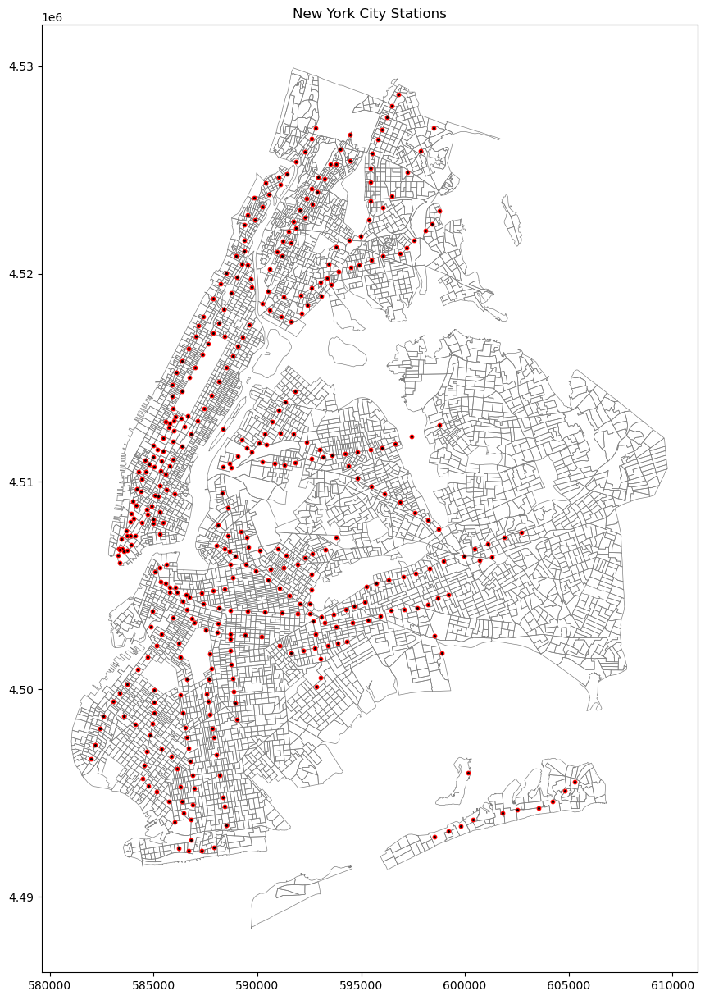

In [202]:
from matplotlib.patches import Circle

# Create a choropleth map of New York City counties based on the degree centrality
fig, ax = plt.subplots(figsize=(15, 15))

# Add block group boundaries
nyc_gdf.plot(linewidth=0.5, edgecolor='grey', facecolor='none', ax=ax)
networkx_gdf_buffered = geo.reset_networkx_gdf(networkx_df, EPSG_FROM, EPSG_TO)

# Plot the buffered points as circles on the map
networkx_gdf_buffered.plot(ax=ax, color='black', edgecolor='red', markersize=10)

ax.set_title('New York City Stations')
plt.show()

### Test run to verify 1000 meter radius

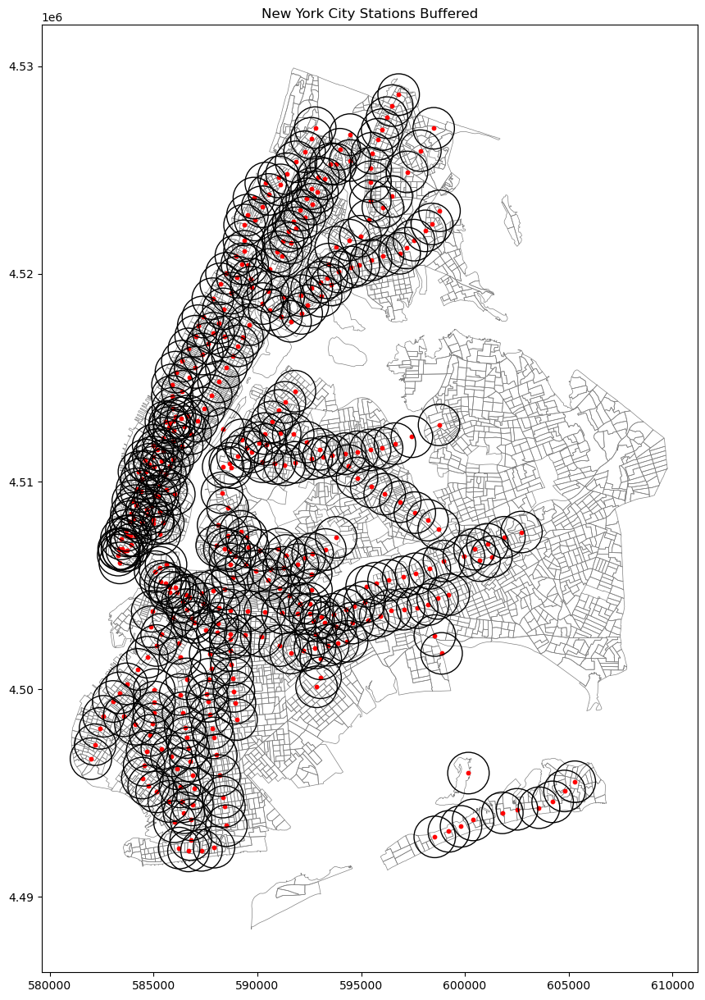

In [8]:
from matplotlib.patches import Circle

# Create a choropleth map of New York City counties based on the degree centrality
fig, ax = plt.subplots(figsize=(15, 15))

# Add block group boundaries
nyc_gdf.plot(linewidth=0.5, edgecolor='grey', facecolor='none', ax=ax)
networkx_gdf_buffered = geo.reset_networkx_gdf(networkx_df, EPSG_FROM, EPSG_TO)

# Plot the buffered points as circles on the map
networkx_gdf_buffered.plot(ax=ax, color='red', edgecolor='red', markersize=10)

for point in networkx_gdf_buffered.itertuples():
    # Radius only displays in meters due to EPSG from init is converted to
    # EPSG_TO explicilty for nyc_dfg and networkx_gdf
    ax.add_patch(Circle(xy=point.geometry.centroid.coords[0], radius=1000, edgecolor='black', facecolor='none'))

ax.set_title('New York City Stations Buffered')
plt.show()

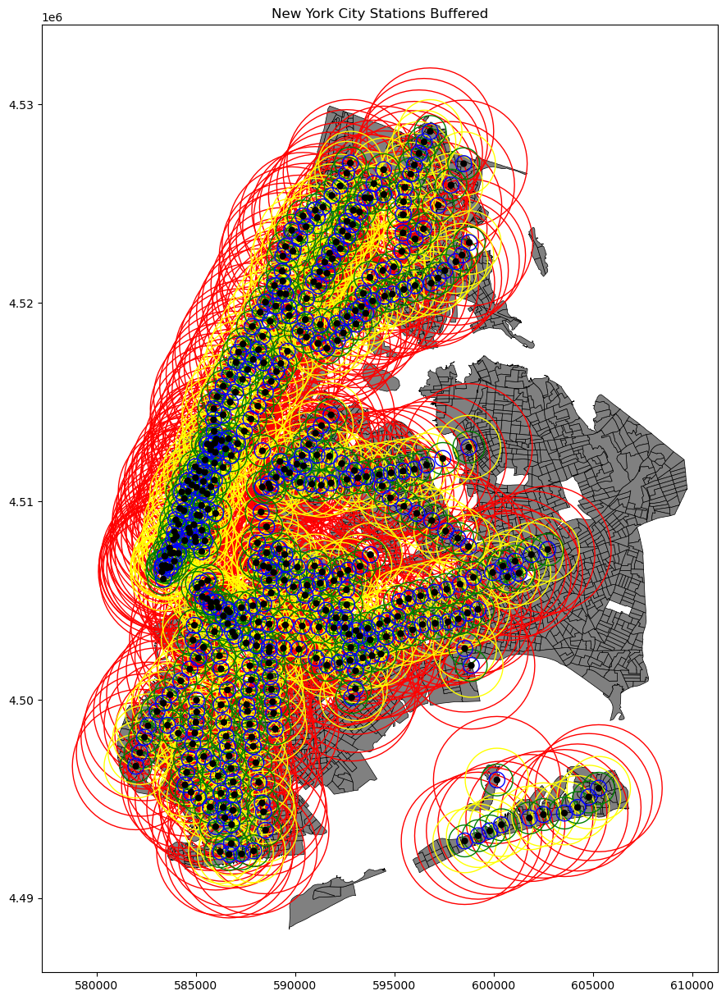

In [9]:
from matplotlib.patches import Circle

# Create a choropleth map of New York City counties based on the degree centrality
fig, ax = plt.subplots(figsize=(15, 15))

# Add block group boundaries
nyc_gdf.plot(linewidth=0.5, edgecolor='black', facecolor='grey', ax=ax)

geo.reset_networkx_gdf(networkx_df, EPSG_FROM, EPSG_TO).buffer(3200) \
    .plot(ax=ax, color='none', edgecolor='red')
geo.reset_networkx_gdf(networkx_df, EPSG_FROM, EPSG_TO).buffer(1600) \
    .plot(ax=ax, color='none', edgecolor='yellow')
geo.reset_networkx_gdf(networkx_df, EPSG_FROM, EPSG_TO).buffer(800) \
    .plot(ax=ax, color='none', edgecolor='green')
geo.reset_networkx_gdf(networkx_df, EPSG_FROM, EPSG_TO).buffer(400) \
    .plot(ax=ax, color='none', edgecolor='blue')
geo.reset_networkx_gdf(networkx_df, EPSG_FROM, EPSG_TO) \
    .plot(ax=ax, color='black', edgecolor='none')

ax.set_title('New York City Stations Buffered')
plt.show()

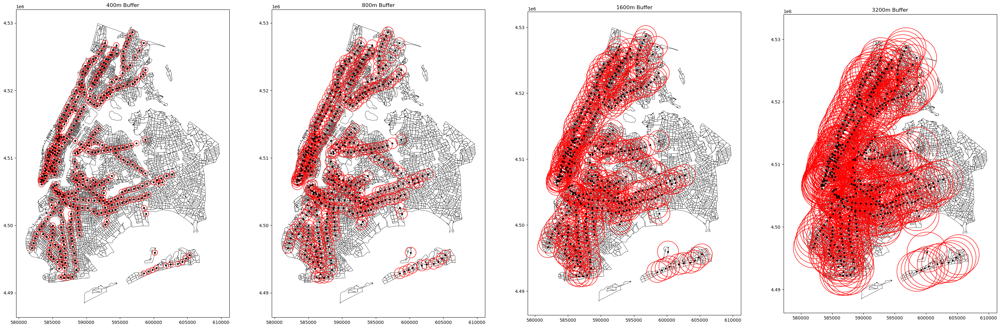

In [6]:
from matplotlib.patches import Circle

# Create a choropleth map of New York City counties based on the degree centrality
fig, axes = plt.subplots(nrows=1, ncols=4, figsize=(40, 40))

# Add block group boundaries
nyc_gdf.plot(linewidth=0.5, edgecolor='black', facecolor='white', ax=axes[0])
nyc_gdf.plot(linewidth=0.5, edgecolor='black', facecolor='white', ax=axes[1])
nyc_gdf.plot(linewidth=0.5, edgecolor='black', facecolor='white', ax=axes[2])
nyc_gdf.plot(linewidth=0.5, edgecolor='black', facecolor='white', ax=axes[3])

# Set titles for each axis
axes[0].set_title('400m Buffer')
axes[1].set_title('800m Buffer')
axes[2].set_title('1600m Buffer')
axes[3].set_title('3200m Buffer')

# Plot each buffer size in a separate subplot
geo.reset_networkx_gdf(networkx_df, EPSG_FROM, EPSG_TO).buffer(400) \
    .plot(ax=axes[0], color='none', edgecolor='red')
geo.reset_networkx_gdf(networkx_df, EPSG_FROM, EPSG_TO).buffer(800) \
    .plot(ax=axes[1], color='none', edgecolor='red')
geo.reset_networkx_gdf(networkx_df, EPSG_FROM, EPSG_TO).buffer(1600) \
    .plot(ax=axes[2], color='none', edgecolor='red')
geo.reset_networkx_gdf(networkx_df, EPSG_FROM, EPSG_TO).buffer(3200) \
    .plot(ax=axes[3], color='none', edgecolor='red')

# Plot the original data on all subplots
geo.reset_networkx_gdf(networkx_df, EPSG_FROM, EPSG_TO) \
    .plot(ax=axes[0], color='black', edgecolor='black', markersize=10)
geo.reset_networkx_gdf(networkx_df, EPSG_FROM, EPSG_TO) \
    .plot(ax=axes[1], color='black', edgecolor='black', markersize=10)
geo.reset_networkx_gdf(networkx_df, EPSG_FROM, EPSG_TO) \
    .plot(ax=axes[2], color='black', edgecolor='black', markersize=10)
geo.reset_networkx_gdf(networkx_df, EPSG_FROM, EPSG_TO) \
    .plot(ax=axes[3], color='black', edgecolor='black', markersize=10)

# Adjust the spacing between the subplots
# fig.subplots_adjust(wspace=0.05, hspace=0.05)

# Display the figure
plt.show()


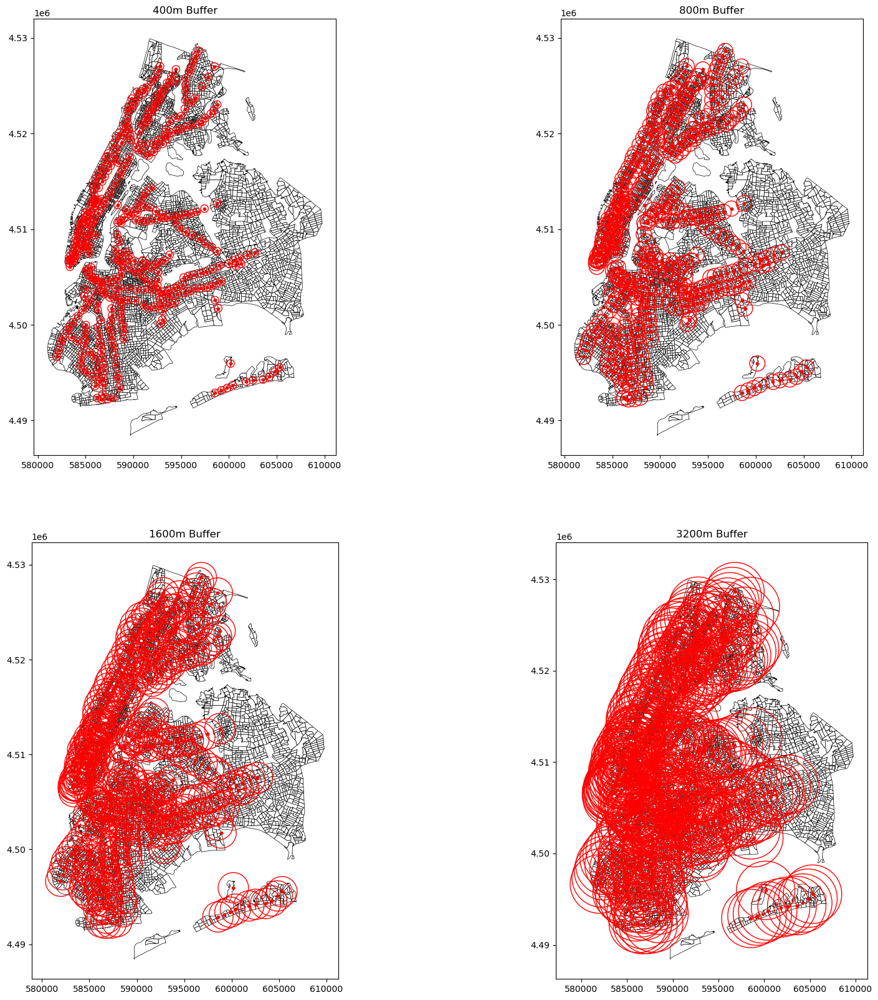

In [212]:
from matplotlib.patches import Circle

# Create a choropleth map of New York City counties based on the degree centrality
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(20, 20))

# Add block group boundaries
nyc_gdf.plot(linewidth=0.5, edgecolor='black', facecolor='white', ax=axes[0, 0])
nyc_gdf.plot(linewidth=0.5, edgecolor='black', facecolor='white', ax=axes[0, 1])
nyc_gdf.plot(linewidth=0.5, edgecolor='black', facecolor='white', ax=axes[1, 0])
nyc_gdf.plot(linewidth=0.5, edgecolor='black', facecolor='white', ax=axes[1, 1])

# Set titles for each axis
axes[0, 0].set_title('400m Buffer')
axes[0, 1].set_title('800m Buffer')
axes[1, 0].set_title('1600m Buffer')
axes[1, 1].set_title('3200m Buffer')

# Plot each buffer size in a separate subplot
geo.reset_networkx_gdf(networkx_df, EPSG_FROM, EPSG_TO).buffer(400) \
    .plot(ax=axes[0, 0], color='none', edgecolor='red')
geo.reset_networkx_gdf(networkx_df, EPSG_FROM, EPSG_TO).buffer(800) \
    .plot(ax=axes[0, 1], color='none', edgecolor='red')
geo.reset_networkx_gdf(networkx_df, EPSG_FROM, EPSG_TO).buffer(1600) \
    .plot(ax=axes[1, 0], color='none', edgecolor='red')
geo.reset_networkx_gdf(networkx_df, EPSG_FROM, EPSG_TO).buffer(3200) \
    .plot(ax=axes[1, 1], color='none', edgecolor='red')

# Plot the original data on all subplots
geo.reset_networkx_gdf(networkx_df, EPSG_FROM, EPSG_TO) \
    .plot(ax=axes[0, 0], color='red', edgecolor='red', markersize=10)
geo.reset_networkx_gdf(networkx_df, EPSG_FROM, EPSG_TO) \
    .plot(ax=axes[0, 1], color='red', edgecolor='red', markersize=10)
geo.reset_networkx_gdf(networkx_df, EPSG_FROM, EPSG_TO) \
    .plot(ax=axes[1, 0], color='red', edgecolor='red', markersize=10)
geo.reset_networkx_gdf(networkx_df, EPSG_FROM, EPSG_TO) \
    .plot(ax=axes[1, 1], color='red', edgecolor='red', markersize=10)

# Adjust the spacing between the subplots
# fig.subplots_adjust(wspace=0.05, hspace=0.05)

# Display the figure
plt.show()


# Conduct Weighted Population NetworkX


In [10]:
# networkx_df = geo.aggregate_nyc_census_variable_to_networkx_weight('ACS19_5yr_B01001001', 'Geo_AREALAND',
#                                                                    networkx_df=networkx_df,
#                                                                    nyc_gdf=nyc_gdf,
#                                                                    meters=1000)

# networkx_df.to_csv('station_populations.csv', index=False)

## Radius calculations and pickling

In [11]:
geoid_df = nyc_gdf[['GEOID','geometry']].copy()
geoid_df

,GEOID,geometry
1,360050001001,"POLYGON ((593419.785 4516459.824, 593476.487 4..."
3,360050002001,"POLYGON ((595863.806 4518818.008, 595941.640 4..."
4,360050002002,"POLYGON ((595704.853 4518787.859, 595785.886 4..."
5,360050002003,"POLYGON ((596268.652 4517940.709, 596297.920 4..."
7,360050004001,"POLYGON ((596177.835 4518877.713, 596253.057 4..."
...,...,...
6149,360811621001,"POLYGON ((606709.818 4509668.899, 606719.857 4..."
6150,360811621002,"POLYGON ((606643.799 4509437.671, 606687.524 4..."
6151,360811621003,"POLYGON ((607112.780 4509324.739, 607113.088 4..."
6152,360811621004,"POLYGON ((607450.606 4509356.830, 607507.678 4..."


In [12]:
# Create 400, 800, 1600, and 3200 meter radi
networkx_gdf = geo.reset_networkx_gdf(networkx_df, EPSG_FROM, EPSG_TO)
geoid_df = geo.aggregate_join_nyc_to_buffered_networkx_stations('_radius_400', geoid_df, networkx_gdf, 400)
geoid_df = geo.aggregate_join_nyc_to_buffered_networkx_stations('_radius_800', geoid_df, networkx_gdf, 800)
geoid_df = geo.aggregate_join_nyc_to_buffered_networkx_stations('_radius_1600', geoid_df, networkx_gdf, 1600)
geoid_df = geo.aggregate_join_nyc_to_buffered_networkx_stations('_radius_3200', geoid_df, networkx_gdf, 3200)

c:\Users\cjong\anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3457: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  exec(code_obj, self.user_global_ns, self.user_ns)
c:\Users\cjong\anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3457: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  exec(code_obj, self.user_global_ns, self.user_ns)
c:\Users\cjong\anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3457: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  exec(code_obj, self.user_global_ns, self.user_ns)
c:\Users\cjong\anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3457: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predic

In [16]:
radius_results_df = geoid_df.loc[:, 'btwn_mean_radius_400':]
# radius_results_df = nyc_gdf.loc[:, 'btwn_mean_radius_500':]
radius_results_df['GEOID'] = geoid_df['GEOID']
radius_results_df.to_pickle('./weighed_radius_results_df.pkl', compression='gzip')

# Load Radius Data Pickle

In [17]:
# Loading saved pickle
radius_results_df = pd.read_pickle('./weighed_radius_results_df.pkl', compression='gzip')
nyc_gdf = pd.merge(nyc_gdf, radius_results_df, on='GEOID')

# Data Pickling

In [18]:
nyc_gdf.to_pickle('./weighed_nyc_gdf.pkl', compression='gzip')
nyc_gdf_cached = nyc_gdf.copy()

# Exporting GeoJson for Tableau

In [ ]:
nyc_gdf = pd.read_pickle('./weighed_nyc_gdf.pkl', compression='gzip')

# Clean for column variables where over 100 values are N/A
na_threshold = 100
na_counts = nyc_gdf.isna().sum()

## Validate columns
# for col in nyc_gdf.columns:
#     na_count = nyc_gdf[col].isna().sum()
#     print(f"{na_count} missing \t - {col}")

# Print columns and their respective number of missing values
cols_to_remove = na_counts[na_counts > na_threshold].index.tolist()
for col in cols_to_remove:
    na_count = na_counts[col]
    print(f"{na_count} missing \t - {col}")

# Find columns with more than "na_threshold" missing values
na_counts = nyc_gdf.isna().sum(axis=0)

cols_to_remove = na_counts[na_counts > na_threshold].index

# Remove columns with more than "na_threshold" missing values
nyc_gdf = nyc_gdf.loc[:, ~nyc_gdf.columns.isin(cols_to_remove)]

# Drop NaN values to remove the parks and the like
nyc_gdf = nyc_gdf.dropna()

# # Find all columns ending in an 's' in nyc_gdf and print in a for loop
# for col in nyc_gdf.columns:
#     if col.endswith('s'):
#         print(col)
        
# Filter nyc_gdf for all columns not ending in an 's'
nyc_gdf = nyc_gdf[[col for col in nyc_gdf.columns if not col.endswith('s')]]

## New Columns

# Prepare data with manually calculated variables
nyc_gdf['inverse_vehicle_use'] = 100 - nyc_gdf['PCT_ACS19_5yr_B08301002']

# # nyc_gdf['log_inverse_vehicle_use'] = np.log(nyc_gdf['inverse_vehicle_use'])

nyc_gdf['pop_density'] = nyc_gdf['ACS19_5yr_B01001001'] / nyc_gdf['Geo_AREALAND']
nyc_gdf['household_density'] = nyc_gdf['ACS19_5yr_B11001001'] / nyc_gdf['Geo_AREALAND']


### network centrality result geojson

In [ ]:
df = nyc_gdf[['GEOID', 'geometry', 'inverse_vehicle_use','pop_density','household_density',
              'PCT_SE_A09001_002', #: % Workers 16 Years and Over: Did Not Work At Home
              'PCT_SE_A10060_002', #: % Occupied Housing Units: Owner Occupied
              'PCT_SE_A10060_003', #: % Occupied Housing Units: Renter Occupied
              'PCT_SE_A10038_002', #: % Renter-Occupied Housing Units: Less than $300
              'PCT_SE_A10038_003', #: % Renter-Occupied Housing Units: $300 to $499
              'PCT_SE_A10038_004', #: % Renter-Occupied Housing Units: $500 to $799
              'PCT_SE_A10038_005', #: % Renter-Occupied Housing Units: $800 to $999
              'PCT_SE_A10038_006', #: % Renter-Occupied Housing Units: $1,000 to $1,499
              'PCT_SE_A10038_007', #: % Renter-Occupied Housing Units: $1,500 to $1,999
              'PCT_SE_A10038_008', #: % Renter-Occupied Housing Units: $2,000 to $2,499
              'PCT_SE_A10038_009', #: % Renter-Occupied Housing Units: $2,500 to $2,999
              'PCT_SE_A10038_010', #: % Renter-Occupied Housing Units: $3,000 or More
              'PCT_SE_A10038_011', #: % Renter-Occupied Housing Units: No Cash Rent
              # 'PCT_SE_A10054B_002', #: % Renter-Occupied Housing Units: No Vehicle Available
              # 'PCT_SE_A10054B_003', #: % Renter-Occupied Housing Units: 1 Vehicle Available
              # 'PCT_SE_A10054B_004', #: % Renter-Occupied Housing Units: 2 Vehicles Available
              # 'PCT_SE_A10054B_005', #: % Renter-Occupied Housing Units: 3 Vehicles Available
              # 'PCT_SE_A10054B_006', #: % Renter-Occupied Housing Units: 4 Vehicles Available
              # 'PCT_SE_A10054B_007', #: % Renter-Occupied Housing Units: 5 or More Vehicles Available
            #   'PCT_SE_A10030_002', #: % Occupied Housing Units: No Vehicle Available
            #   'PCT_SE_A10030_003', #: % Occupied Housing Units: 1 Vehicle Available
            #   'PCT_SE_A10030_004', #: % Occupied Housing Units: 2 Vehicles Available
            #   'PCT_SE_A10030_005', #: % Occupied Housing Units: 3 Vehicles Available
            #   'PCT_SE_A10030_006', #: % Occupied Housing Units: 4 Vehicles Available
            #   'PCT_SE_A10030_007', #: % Occupied Housing Units: 5 or More Vehicles Available
              'PCT_SE_A14001_002', #: % Households: Less than $10,000
              'PCT_SE_A14001_003', #: % Households: $10,000 to $14,999
              'PCT_SE_A14001_004', #: % Households: $15,000 to $19,999
              'PCT_SE_A14001_005', #: % Households: $20,000 to $24,999
              'PCT_SE_A14001_006', #: % Households: $25,000 to $29,999
              'PCT_SE_A14001_007', #: % Households: $30,000 to $34,999
              'PCT_SE_A14001_008', #: % Households: $35,000 to $39,999
              'PCT_SE_A14001_009', #: % Households: $40,000 to $44,999
              'PCT_SE_A14001_010', #: % Households: $45,000 to $49,999
              'PCT_SE_A14001_011', #: % Households: $50,000 to $59,999
              'PCT_SE_A14001_012', #: % Households: $60,000 to $74,999
              'PCT_SE_A14001_013', #: % Households: $75,000 to $99,999
              'PCT_SE_A14001_014', #: % Households: $100,000 to $124,999
              'PCT_SE_A14001_015', #: % Households: $125,000 to $149,999
              'PCT_SE_A14001_016', #: % Households: $150,000 to $199,999
              'PCT_SE_A14001_017', #: % Households: $200,000 or More
              'SE_A14008_001', #: Average Household Income (In 2019 Inflation Adjusted Dollars)
              'SE_A14024_001', #: Per Capita Income (In 2019 Inflation Adjusted Dollars)
              'PCT_SE_A13002_002', #: % Families: Income Below Poverty Level
            'clse_mean_radius_400',
            'clse_mean_radius_800',
            'clse_mean_radius_1600',
            'clse_mean_radius_3200',
            'btwn_mean_radius_400',
            'btwn_mean_radius_800',
            'btwn_mean_radius_1600',
            'btwn_mean_radius_3200',
            'pgrk_mean_radius_400',
            'pgrk_mean_radius_800',
            'pgrk_mean_radius_1600',
            'pgrk_mean_radius_3200',
            'clse_sum_radius_400',
            'clse_sum_radius_800',
            'clse_sum_radius_1600',
            'clse_sum_radius_3200',
            'btwn_sum_radius_400',
            'btwn_sum_radius_800',
            'btwn_sum_radius_1600',
            'btwn_sum_radius_3200',
            'pgrk_sum_radius_400',
            'pgrk_sum_radius_800',
            'pgrk_sum_radius_1600',
            'pgrk_sum_radius_3200',
            ]]

### Data Export for Tableau

In [ ]:
# # unnecessary because rather than direct export it is wiser to melt for filtering purposes
# # Export the GeoDataFrame to a GeoJSON file
# df.to_file("df_data.geojson", driver='GeoJSON')

import pandas as pd

# List of column names to keep as ID variables
id_vars = ['GEOID', 'geometry']

# Melt the DataFrame
melted_df = pd.melt(df, id_vars=id_vars, var_name='column_key', value_name='column_value')

# Export the GeoDataFrame to a GeoJSON file
melted_df.to_file("melted_df.geojson", driver='GeoJSON')

# Load All Data Pickle

In [111]:
nyc_gdf = pd.read_pickle('./weighed_nyc_gdf.pkl', compression='gzip')

# Choropleth Map Functions

In [130]:
def plot_choropleth_maps(nyc_gdf, mean, radius):
    
    # Create a figure with 4 subplots in a 2x2 grid
    fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(18, 7))
    
    # Plot each choropleth map on its corresponding subplot
    axes[0].set_title('Betweenness', fontsize=24)
    nyc_gdf.plot(column=f'btwn_{mean}_radius_{radius}', cmap='YlOrRd', legend=True, ax=axes[0])
    
    axes[1].set_title('Closeness', fontsize=24)
    nyc_gdf.plot(column=f'clse_{mean}_radius_{radius}', cmap='YlOrRd', legend=True, ax=axes[1])
    
    axes[2].set_title('PageRank', fontsize=24)
    nyc_gdf.plot(column=f'pgrk_{mean}_radius_{radius}', cmap='YlOrRd', legend=True, ax=axes[2])
    
    # Add block group boundaries to all subplots
    for ax in axes.flat:
        nyc_gdf.plot(linewidth=0.5, edgecolor='black', facecolor='none', ax=ax)

    # Add a title to the figure
    fig.suptitle(f'New York City Block Groups - {mean} centrality measures for {radius} meters', fontsize=28)
    
    # Display the figure
    plt.show()

# Radius Results

## 400 meters

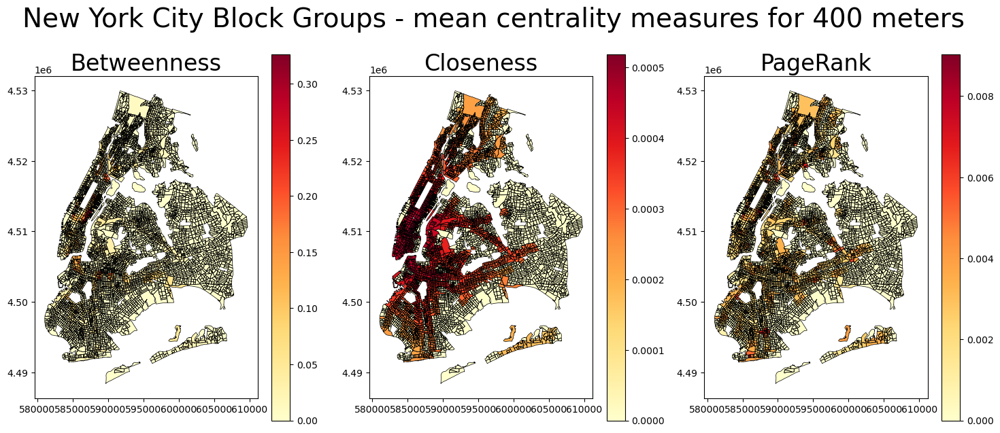

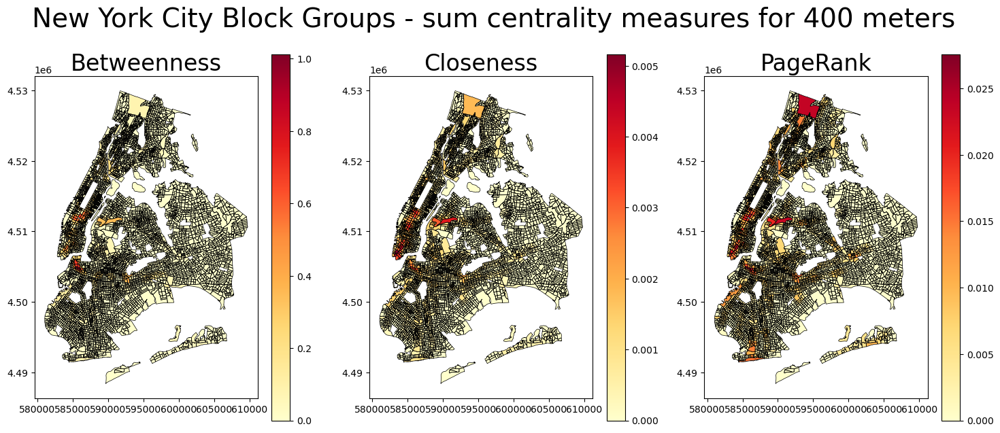

In [132]:
plot_choropleth_maps(nyc_gdf, 'mean', '400')
plot_choropleth_maps(nyc_gdf, 'sum', '400')


## 800 meters

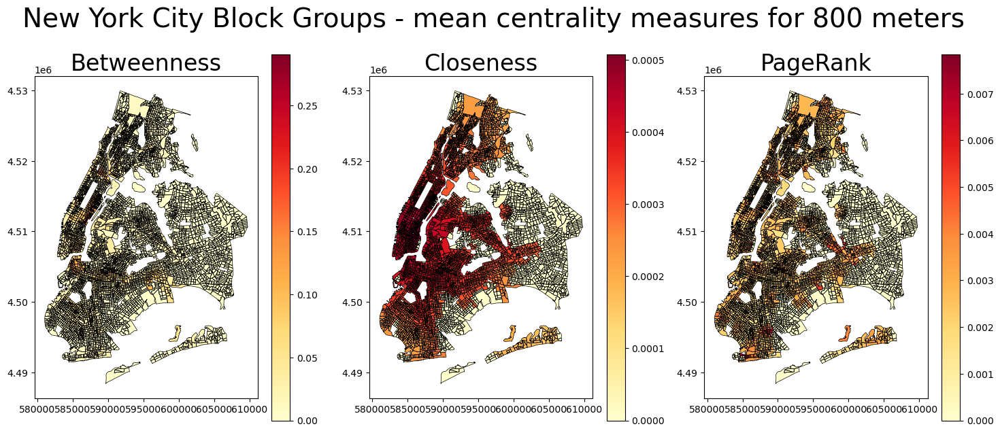

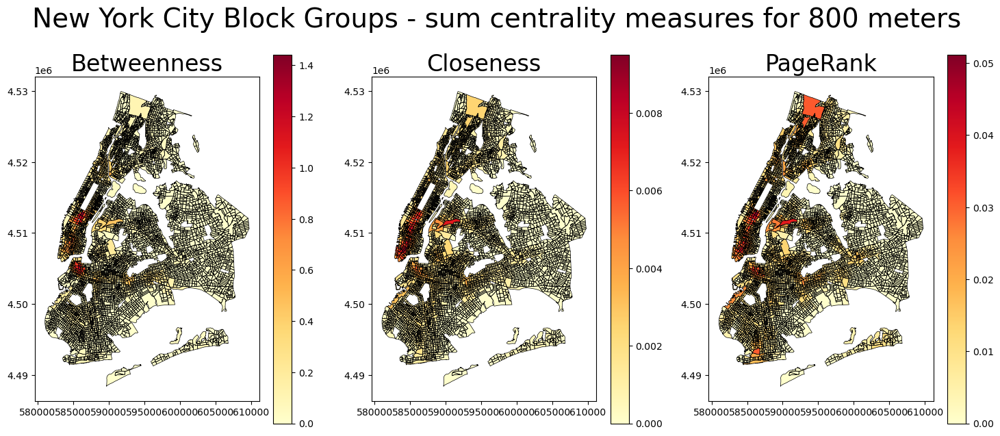

In [131]:
plot_choropleth_maps(nyc_gdf, 'mean', '800')
plot_choropleth_maps(nyc_gdf, 'sum', '800')


## 1600 meters

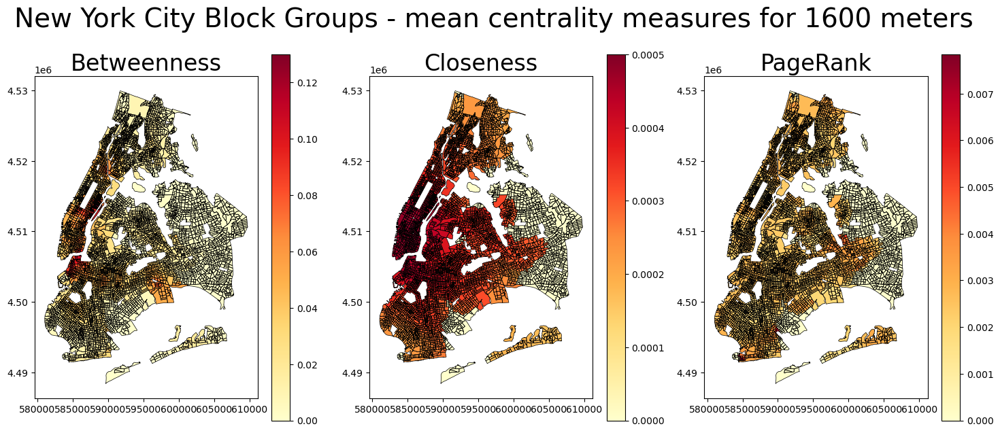

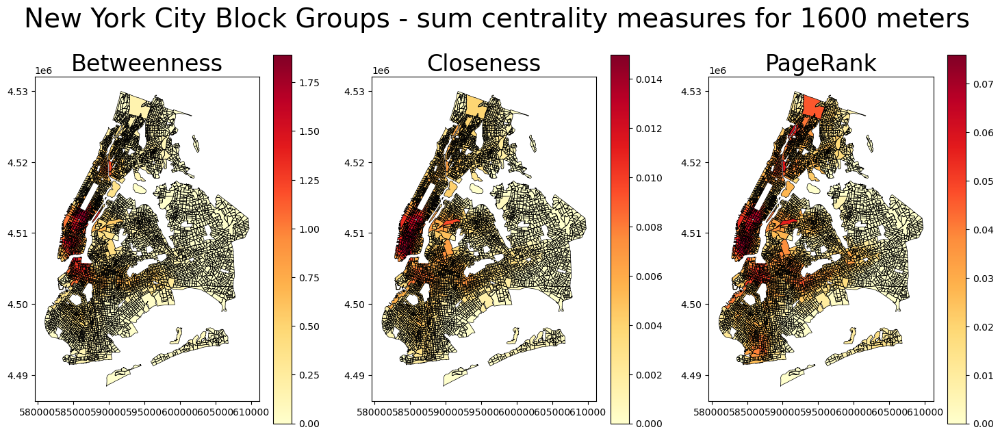

In [133]:
plot_choropleth_maps(nyc_gdf, 'mean', '1600')
plot_choropleth_maps(nyc_gdf, 'sum', '1600')


## 3200 meters

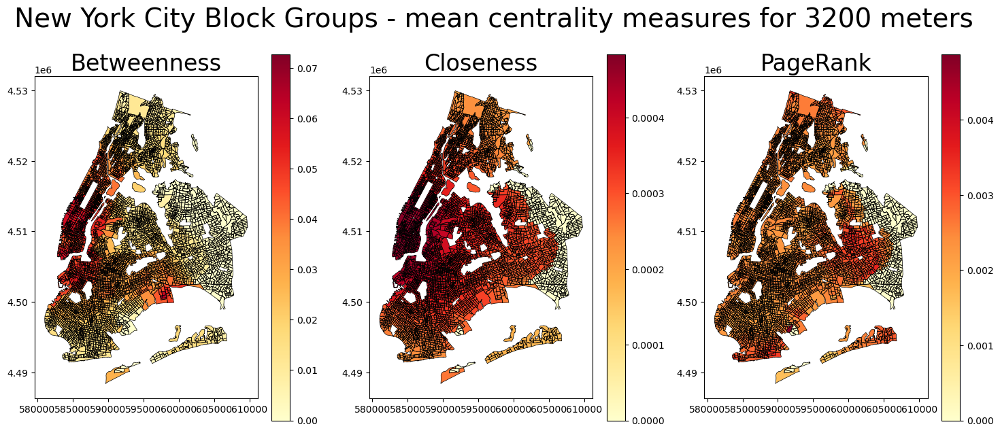

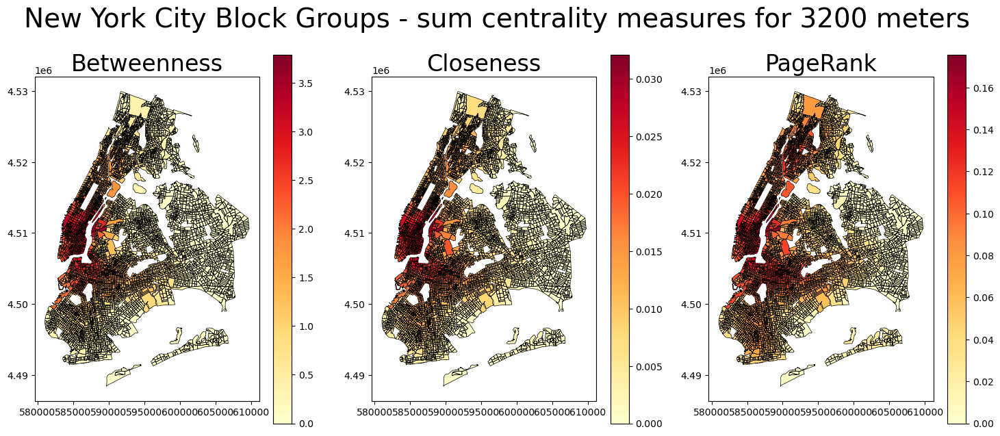

In [134]:
plot_choropleth_maps(nyc_gdf, 'mean', '3200')
plot_choropleth_maps(nyc_gdf, 'sum', '3200')


# Regressions

### Data Cleanup

In [135]:
# Read pickle
nyc_gdf = pd.read_pickle('./weighed_nyc_gdf.pkl', compression='gzip')

# Clean for column variables where over 100 values are N/A
na_threshold = 100
na_counts = nyc_gdf.isna().sum()

## Validate columns
# for col in nyc_gdf.columns:
#     na_count = nyc_gdf[col].isna().sum()
#     print(f"{na_count} missing \t - {col}")

# Print columns and their respective number of missing values
cols_to_remove = na_counts[na_counts > na_threshold].index.tolist()
for col in cols_to_remove:
    na_count = na_counts[col]
    print(f"{na_count} missing \t - {col}")

# Find columns with more than "na_threshold" missing values
na_counts = nyc_gdf.isna().sum(axis=0)

cols_to_remove = na_counts[na_counts > na_threshold].index

# Remove columns with more than "na_threshold" missing values
nyc_gdf = nyc_gdf.loc[:, ~nyc_gdf.columns.isin(cols_to_remove)]

# Drop NaN values to remove the parks and the like
nyc_gdf = nyc_gdf.dropna()

# # Find all columns ending in an 's' in nyc_gdf and print in a for loop
# for col in nyc_gdf.columns:
#     if col.endswith('s'):
#         print(col)
        
# Filter nyc_gdf for all columns not ending in an 's'
nyc_gdf = nyc_gdf[[col for col in nyc_gdf.columns if not col.endswith('s')]]

## New Columns

# Prepare data with manually calculated variables
nyc_gdf['inverse_vehicle_use'] = 100 - nyc_gdf['PCT_ACS19_5yr_B08301002']

# # nyc_gdf['log_inverse_vehicle_use'] = np.log(nyc_gdf['inverse_vehicle_use'])

nyc_gdf['pop_density'] = nyc_gdf['ACS19_5yr_B01001001'] / nyc_gdf['Geo_AREALAND']
nyc_gdf['household_density'] = nyc_gdf['ACS19_5yr_B11001001'] / nyc_gdf['Geo_AREALAND']

####

# Filter nyc_gdf columns for numeric values
nyc_gdf = nyc_gdf.loc[:,'Geo_AREALAND':]
nyc_gdf = nyc_gdf.loc[:, ~nyc_gdf.columns.isin(nyc_gdf.loc[:, 'STATEFP':'geometry'].columns)]


####

# Load the column names file
column_decode = pd.read_csv('./data/socialexplorer_nyc_blockgroup_data/column_names.csv', header=None, index_col=1)

# Loop through each column in nyc_gdf and print the corresponding code and definition
for column in nyc_gdf.columns:
    if column in column_decode.index:
        code = column
        definition = column_decode.loc[column, 0]
    else:
        code = " --- "
        definition = " --- "
        
    print(f"{column}: {definition}")


5908 missing 	 - Geo_US
5908 missing 	 - Geo_REGION
5908 missing 	 - Geo_DIVISION
5908 missing 	 - Geo_STATECE
5908 missing 	 - Geo_COUSUB
5908 missing 	 - Geo_PLACE
5908 missing 	 - Geo_PLACESE
5908 missing 	 - Geo_CONCIT
5908 missing 	 - Geo_AIANHH
5908 missing 	 - Geo_AIANHHFP
5908 missing 	 - Geo_AIHHTLI
5908 missing 	 - Geo_AITSCE
5908 missing 	 - Geo_AITS
5908 missing 	 - Geo_ANRC
5908 missing 	 - Geo_CBSA
5908 missing 	 - Geo_CSA
5908 missing 	 - Geo_METDIV
5908 missing 	 - Geo_MACC
5908 missing 	 - Geo_MEMI
5908 missing 	 - Geo_NECTA
5908 missing 	 - Geo_CNECTA
5908 missing 	 - Geo_NECTADIV
5908 missing 	 - Geo_UA
5908 missing 	 - Geo_UACP
5908 missing 	 - Geo_CDCURR
5908 missing 	 - Geo_SLDU
5908 missing 	 - Geo_SLDL
5908 missing 	 - Geo_VTD
5908 missing 	 - Geo_ZCTA3
5908 missing 	 - Geo_ZCTA5
5908 missing 	 - Geo_SUBMCD
5908 missing 	 - Geo_SDELM
5908 missing 	 - Geo_SDSEC
5908 missing 	 - Geo_SDUNI
5908 missing 	 - Geo_UR
5908 missing 	 - Geo_PCI
5908 missing 	 - Geo_TAZ
59

### Process Logs

In [136]:
def append_log_columns(nyc_gdf, variable):
    min_val = nyc_gdf[nyc_gdf[variable] > 0][variable].min()
    nyc_gdf['log_'+variable] = np.log(nyc_gdf[variable].clip(lower=min_val))
    return nyc_gdf

In [137]:
nyc_gdf = append_log_columns(nyc_gdf, 'clse_mean_radius_400')
nyc_gdf = append_log_columns(nyc_gdf, 'clse_mean_radius_800')
nyc_gdf = append_log_columns(nyc_gdf, 'clse_mean_radius_1600')
nyc_gdf = append_log_columns(nyc_gdf, 'clse_mean_radius_3200')
nyc_gdf = append_log_columns(nyc_gdf, 'btwn_mean_radius_400')
nyc_gdf = append_log_columns(nyc_gdf, 'btwn_mean_radius_800')
nyc_gdf = append_log_columns(nyc_gdf, 'btwn_mean_radius_1600')
nyc_gdf = append_log_columns(nyc_gdf, 'btwn_mean_radius_3200')
nyc_gdf = append_log_columns(nyc_gdf, 'pgrk_mean_radius_400')
nyc_gdf = append_log_columns(nyc_gdf, 'pgrk_mean_radius_800')
nyc_gdf = append_log_columns(nyc_gdf, 'pgrk_mean_radius_1600')
nyc_gdf = append_log_columns(nyc_gdf, 'pgrk_mean_radius_3200')

nyc_gdf = append_log_columns(nyc_gdf, 'clse_sum_radius_400')
nyc_gdf = append_log_columns(nyc_gdf, 'clse_sum_radius_800')
nyc_gdf = append_log_columns(nyc_gdf, 'clse_sum_radius_1600')
nyc_gdf = append_log_columns(nyc_gdf, 'clse_sum_radius_3200')
nyc_gdf = append_log_columns(nyc_gdf, 'btwn_sum_radius_400')
nyc_gdf = append_log_columns(nyc_gdf, 'btwn_sum_radius_800')
nyc_gdf = append_log_columns(nyc_gdf, 'btwn_sum_radius_1600')
nyc_gdf = append_log_columns(nyc_gdf, 'btwn_sum_radius_3200')
nyc_gdf = append_log_columns(nyc_gdf, 'pgrk_sum_radius_400')
nyc_gdf = append_log_columns(nyc_gdf, 'pgrk_sum_radius_800')
nyc_gdf = append_log_columns(nyc_gdf, 'pgrk_sum_radius_1600')
nyc_gdf = append_log_columns(nyc_gdf, 'pgrk_sum_radius_3200')


### Set Up Functions

In [147]:
from sklearn.model_selection import train_test_split
# from sklearn.ensemble import RandomForestRegressor
import xgboost as xgb
from sklearn.metrics import mean_absolute_error, mean_squared_error, mean_absolute_percentage_error

def run_xgboost_no_cv(df,
                      is_return_rsquared = False,
                      is_return_mae = False,
                      is_return_mse = False,
                      is_return_mape = False):
    # Split the data into training and testing sets
    X_train, X_test, y_train, y_test = train_test_split(df.drop('inverse_vehicle_use', axis=1), df['inverse_vehicle_use'], test_size=0.3, random_state=42)

    # Create an instance of the RandomForestRegressor class
    xgb_model  = xgb.XGBRegressor(subsample = 0.8,
                                  n_estimators = 100,
                                  min_child_weight = 8,
                                  max_depth = 4, 
                                  learning_rate = 0.05, 
                                  gamma = 0,
                                  colsample_bytree = 0.8,
                                  random_state = 42)

    # # Create an instance of the RandomForestRegressor class
    # xgb_model  = xgb.XGBRegressor(subsample = 1,
    #                               n_estimators = 100,
    #                               min_child_weight = 5,
    #                               max_depth = 5, 
    #                               learning_rate = 0.05, 
    #                               gamma = 0,
    #                               colsample_bytree = 1,
    #                               random_state = 42)

    # Fit the model to the training data
    xgb_model.fit(X_train, y_train)

    # Make predictions on the testing data
    y_pred = xgb_model.predict(X_test)

    # Evaluate the performance of the model using mean absolute error and mean squared error
    mae = mean_absolute_error(y_test, y_pred)
    mse = mean_squared_error(y_test, y_pred)
    mape = mean_absolute_percentage_error(y_test, y_pred)

    from sklearn.metrics import r2_score

    # Calculate the R-squared value of the model on the testing data
    r2 = r2_score(y_test, y_pred)

    if is_return_rsquared:
        return r2
    if is_return_mae:
        return mae
    if is_return_mse:
        return mse
    if is_return_mape:
        return mape

    print('Mean absolute error:', mae)
    print('Mean squared error:', mse)
    print('Mean absolute percentage error:', mape)
    print('R-squared:', r2)
    
    # Extract the feature importances
    importances = xgb_model.feature_importances_

    # Create a list of tuples (feature name, importance score)
    feature_importances = [(feature, importance) for feature, importance in zip(df.drop('inverse_vehicle_use', axis=1).columns, importances)]

    # Sort the list by importance score in descending order
    feature_importances = sorted(feature_importances, key=lambda x: x[1], reverse=True)

    # Load the column names file
    column_decode = pd.read_csv('./data/socialexplorer_nyc_blockgroup_data/column_names.csv', header=None)

    # # Print the list of significant variables and their importance scores
    # for feature, importance in feature_importances:
    #     print(feature, column_decode.loc[feature], importance)

    # If column_decode contains codes:
    # Print the list of significant variables and their importance scores along with their definitions
    for feature, importance in feature_importances:
        try:
            code = column_decode.loc[column_decode[1] == feature][1].values[0]
            definition = column_decode.loc[column_decode[1] == feature][0].values[0]
        except IndexError:
            code = feature
            definition = " --- "

        print(f"({importance}) {code}: {definition}")


    ### histogram

    # Extract the feature names and importance scores, sort them in descending order, and select the top 10 results
    top_features = sorted([(feature, importance) for feature, importance in feature_importances], key=lambda x: x[1], reverse=True)[:10]

    # Extract the feature names and importance scores into separate lists, using human-readable labels if available
    feature_names = []
    for feature, _ in top_features:
    ## commented section would work if 'key' is set as the index
        # if feature in column_decode.index:
        #     feature_name = f"{column_decode.loc[feature, 0]} ({feature})"
        # else:
        #     feature_name = feature
        try:
            feature_name = column_decode.loc[column_decode[1] == feature][0].values[0]
        except IndexError:
            feature_name = feature
        feature_names.append(feature_name)

    importance_scores = [importance for _, importance in top_features]

    # Create a vertical bar chart of the top 10 features and their importance scores
    plt.bar(feature_names, importance_scores)
    plt.xlabel('Feature')
    plt.ylabel('Importance Score')
    plt.title('Top 10 Features by Importance, not including network results')
    plt.xticks(rotation=90)
    plt.show()

import numpy as np
from sklearn.model_selection import cross_val_score, GridSearchCV, RandomizedSearchCV
import xgboost as xgb

def run_xgboost_with_cv(df):
    # Split the data into training and testing sets
    X_train, X_test, y_train, y_test = train_test_split(df.drop('inverse_vehicle_use', axis=1), df['inverse_vehicle_use'], test_size=0.3, random_state=42)

    # Create an instance of the XGBRegressor class
    xgb_model = xgb.XGBRegressor(random_state=42)

    # # Define the hyperparameters to tune
    # params = {
    #     'n_estimators': [100, 150, 200],
    #     'learning_rate': [0.05, 0.1, 0.2],
    #     'max_depth': [3, 4, 5],
    #     'min_child_weight': [1, 3, 5],
    #     'subsample': [0.8, 1.0],
    #     'colsample_bytree': [0.8, 1.0],
    #     'gamma': [0, 0.1, 0.2]
    # }

    # params = {
        # 'n_estimators': [50, 100, 150],
        # 'learning_rate': [0.05, 0.1, 0.2],
        # 'max_depth': [3, 4, 5, 6, 7],
        # 'min_child_weight': [1, 3, 5],
        # 'subsample': [0.8, 1.0],
        # 'colsample_bytree': [0.8, 1.0],
        # 'gamma': [0, 0.1, 0.2]
    # }

    params = {
        'n_estimators': [50, 100, 150, 200],
        'learning_rate': [0.01, 0.05, 0.1, 0.2],
        'max_depth': [3, 4, 5, 6, 7],
        'min_child_weight': [1, 3, 5, 7, 8, 9, 10, 12, 15],
        'subsample': [0.8, 1.0],
        'colsample_bytree': [0.8, 1.0],
        'gamma': [0, 0.1, 0.2, 0.3, 0.4]
    }

    # Create a grid search object
    grid_cv = RandomizedSearchCV(
        estimator=xgb_model,
        param_distributions=params,
        n_iter=10,
        cv=5,
        scoring='neg_mean_squared_error',
        random_state=42
    )
    
    # # Create a grid search object
    # grid_cv = GridSearchCV(
    #     estimator=xgb_model,
    #     param_grid=params,
    #     cv=5,
    #     scoring='neg_mean_squared_error'
    # )

    # Fit the randomized search object to the training data
    grid_cv.fit(X_train, y_train)

    # Print the best hyperparameters found
    print(grid_cv.best_params_)

    # Create a new XGBRegressor object with the best hyperparameters found
    xgb_model = xgb.XGBRegressor(**grid_cv.best_params_, random_state=42)

    # Evaluate the performance of the model using cross-validation
    scores = cross_val_score(xgb_model, X_train, y_train, cv=5, scoring='neg_mean_squared_error')
    print('Cross-validation scores:', np.sqrt(-scores))
    print('Mean cross-validation score:', np.sqrt(-scores.mean()))

    # Fit the model to the training data
    xgb_model.fit(X_train, y_train)

    # Make predictions on the testing data
    y_pred = xgb_model.predict(X_test)

    # Evaluate the performance of the model using mean absolute error and mean squared error
    mae = mean_absolute_error(y_test, y_pred)
    mse = mean_squared_error(y_test, y_pred)
    print('Mean absolute error:', mae)
    print('Mean squared error:', mse)


    from sklearn.metrics import r2_score

    # Calculate the R-squared value of the model on the testing data
    r2 = r2_score(y_test, y_pred)

    print('R-squared:', r2)

    # Extract the feature importances
    importances = xgb_model.feature_importances_

    # Create a list of tuples (feature name, importance score)
    feature_importances = [(feature, importance) for feature, importance in zip(df.drop('inverse_vehicle_use', axis=1).columns, importances)]

    # Sort the list by importance score in descending order
    feature_importances = sorted(feature_importances, key=lambda x: x[1], reverse=True)

    # Load the column names file
    column_decode = pd.read_csv('./data/socialexplorer_nyc_blockgroup_data/column_names.csv', header=None)

    # # Print the list of significant variables and their importance scores
    # for feature, importance in feature_importances:
    #     print(feature, column_decode.loc[feature], importance)

    # If column_decode contains codes:
    # Print the list of significant variables and their importance scores along with their definitions
    for feature, importance in feature_importances:
        try:
            code = column_decode.loc[column_decode[1] == feature][1].values[0]
            definition = column_decode.loc[column_decode[1] == feature][0].values[0]
        except IndexError:
            code = feature
            definition = " --- "

        print(f"({importance}) {code}: {definition}")


    ### histogram

    # Extract the feature names and importance scores, sort them in descending order, and select the top 10 results
    top_features = sorted([(feature, importance) for feature, importance in feature_importances], key=lambda x: x[1], reverse=True)[:10]

    # Extract the feature names and importance scores into separate lists, using human-readable labels if available
    feature_names = []
    for feature, _ in top_features:
    ## commented section would work if 'key' is set as the index
        # if feature in column_decode.index:
        #     feature_name = f"{column_decode.loc[feature, 0]} ({feature})"
        # else:
        #     feature_name = feature
        try:
            feature_name = column_decode.loc[column_decode[1] == feature][0].values[0]
        except IndexError:
            feature_name = feature
        feature_names.append(feature_name)

    importance_scores = [importance for _, importance in top_features]

    # Create a vertical bar chart of the top 10 features and their importance scores
    plt.bar(feature_names, importance_scores)
    plt.xlabel('Feature')
    plt.ylabel('Importance Score')
    plt.title('Top 10 Features by Importance, not including network results')
    plt.xticks(rotation=90)
    plt.show()

### XGBoost with research paper based backings

Mean absolute error: 9.328538146866013
Mean squared error: 152.3746462975376
Mean absolute percentage error: 0.16906699170018383
R-squared: 0.5970308131870563
(0.4633813798427582) household_density:  --- 
(0.17123770713806152) PCT_SE_A10060_003: % Occupied Housing Units: Renter Occupied
(0.1285364180803299) PCT_SE_A10060_002: % Occupied Housing Units: Owner Occupied
(0.06910884380340576) pop_density:  --- 
(0.0535973459482193) SE_A14024_001: Per Capita Income (In 2019 Inflation Adjusted Dollars)
(0.038186367601156235) SE_A14008_001: Average Household Income (In 2019 Inflation Adjusted Dollars)
(0.022387759760022163) PCT_SE_A17002_004: % Population 16 Years and Over: in Labor Force: Civilian
(0.020701119676232338) PCT_SE_A13002_002: % Families: Income Below Poverty Level
(0.01916850358247757) SE_A10003_001: Average Household Size
(0.013694468885660172) PCT_SE_A17002_006: % Population 16 Years and Over: in Labor Force: Civilian: Unemployed


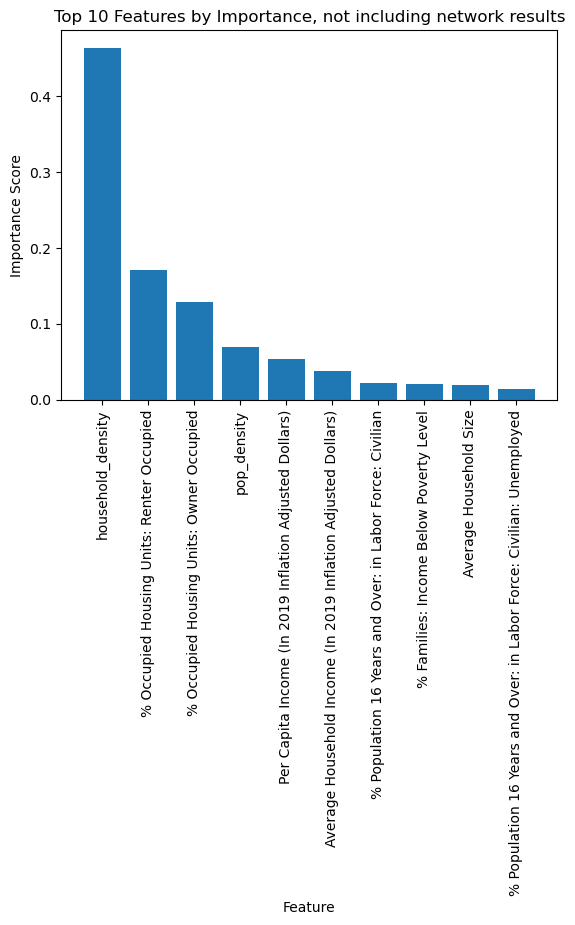

In [148]:
df = nyc_gdf[['inverse_vehicle_use', # % Commuters Without a Personal Vehicle
              'pop_density', # Population Density (Per sq. Meters)
              'household_density', # Household Density (Per sq. Meters)
              'PCT_SE_A10060_002', #: % Occupied Housing Units: Owner Occupied
              'PCT_SE_A10060_003', #: % Occupied Housing Units: Renter Occupied
              'SE_A14008_001', #: Average Household Income (In 2019 Inflation Adjusted Dollars)
              'SE_A14024_001', #: Per Capita Income (In 2019 Inflation Adjusted Dollars)
              'PCT_SE_A13002_002', #: % Families: Income Below Poverty Level
              'SE_A10003_001', #: Average Household Size
              'PCT_SE_A17002_004', #: % Population 16 Years and Over: in Labor Force: Civilian
              # 'PCT_SE_A17002_005', #: % Population 16 Years and Over: in Labor Force: Civilian: Employed
              'PCT_SE_A17002_006', #: % Population 16 Years and Over: in Labor Force: Civilian: Unemployed
              # 'PCT_SE_A10030_002', #: % Occupied Housing Units: No Vehicle Available
            ]]
# 
np.any(np.isnan(df))
np.all(np.isfinite(df))

df=df.dropna()
run_xgboost_no_cv(df)


Mean absolute error: 8.20696259375846
Mean squared error: 118.41316139351576
Mean absolute percentage error: 0.1452186725034236
R-squared: 0.686845177238216
(0.39733943343162537) clse_sum_radius_3200:  --- 
(0.22392666339874268) household_density:  --- 
(0.09578363597393036) PCT_SE_A10060_003: % Occupied Housing Units: Renter Occupied
(0.07539994269609451) pop_density:  --- 
(0.07111503183841705) PCT_SE_A10060_002: % Occupied Housing Units: Owner Occupied
(0.04630160331726074) SE_A14024_001: Per Capita Income (In 2019 Inflation Adjusted Dollars)
(0.02430606074631214) SE_A14008_001: Average Household Income (In 2019 Inflation Adjusted Dollars)
(0.020448680967092514) SE_A10003_001: Average Household Size
(0.01802319847047329) PCT_SE_A17002_004: % Population 16 Years and Over: in Labor Force: Civilian
(0.01423843577504158) PCT_SE_A13002_002: % Families: Income Below Poverty Level
(0.013117331080138683) PCT_SE_A17002_006: % Population 16 Years and Over: in Labor Force: Civilian: Unemployed

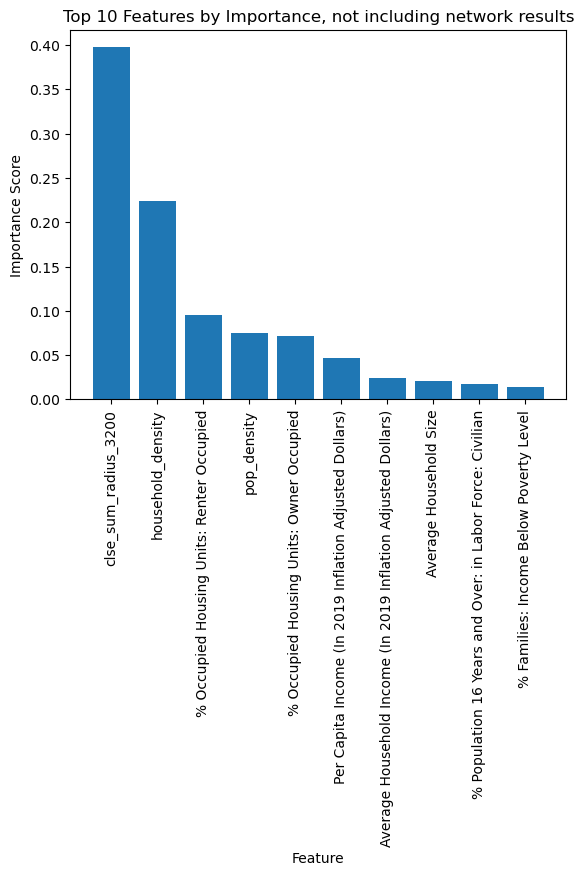

In [149]:
df = nyc_gdf[['inverse_vehicle_use', # % Commuters Without a Personal Vehicle
              'pop_density', # Population Density (Per sq. Meters)
              'household_density', # Household Density (Per sq. Meters)
              'PCT_SE_A10060_002', #: % Occupied Housing Units: Owner Occupied
              'PCT_SE_A10060_003', #: % Occupied Housing Units: Renter Occupied
              'SE_A14008_001', #: Average Household Income (In 2019 Inflation Adjusted Dollars)
              'SE_A14024_001', #: Per Capita Income (In 2019 Inflation Adjusted Dollars)
              'PCT_SE_A13002_002', #: % Families: Income Below Poverty Level
              'SE_A10003_001', #: Average Household Size
              'PCT_SE_A17002_004', #: % Population 16 Years and Over: in Labor Force: Civilian
              # 'PCT_SE_A17002_005', #: % Population 16 Years and Over: in Labor Force: Civilian: Employed
              'PCT_SE_A17002_006', #: % Population 16 Years and Over: in Labor Force: Civilian: Unemployed
              # 'PCT_SE_A10030_002', #: % Occupied Housing Units: No Vehicle Available
            'clse_sum_radius_3200',
            ]]
# 
np.any(np.isnan(df))
np.all(np.isfinite(df))

df=df.dropna()
run_xgboost_no_cv(df)


Mean absolute error: 7.80753077823059
Mean squared error: 108.92797177298394
Mean absolute percentage error: 0.1386184448730037
R-squared: 0.7119296597359717
(0.4950849711894989) clse_sum_radius_1600:  --- 
(0.09221087396144867) clse_mean_radius_800:  --- 
(0.05043065920472145) btwn_sum_radius_3200:  --- 
(0.049275100231170654) clse_sum_radius_800:  --- 
(0.04375727102160454) household_density:  --- 
(0.030218418687582016) clse_sum_radius_3200:  --- 
(0.023236028850078583) btwn_mean_radius_3200:  --- 
(0.02190113253891468) clse_mean_radius_400:  --- 
(0.020873060449957848) clse_mean_radius_1600:  --- 
(0.018466351553797722) clse_mean_radius_3200:  --- 
(0.01735113002359867) PCT_SE_A10060_002: % Occupied Housing Units: Owner Occupied
(0.01495402678847313) PCT_SE_A10060_003: % Occupied Housing Units: Renter Occupied
(0.01204778254032135) pop_density:  --- 
(0.00970678124576807) clse_sum_radius_400:  --- 
(0.007832168601453304) pgrk_sum_radius_3200:  --- 
(0.0074066538363695145) SE_A14024

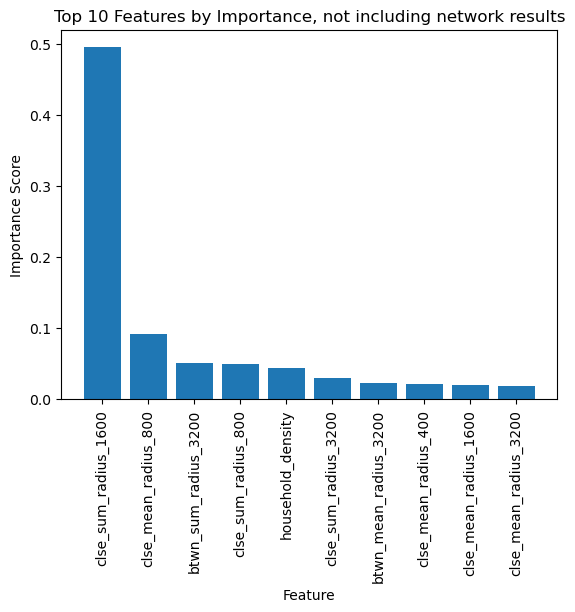

In [150]:
df = nyc_gdf[['inverse_vehicle_use', # % Commuters Without a Personal Vehicle
              'pop_density', # Population Density (Per sq. Meters)
              'household_density', # Household Density (Per sq. Meters)
              'PCT_SE_A10060_002', #: % Occupied Housing Units: Owner Occupied
              'PCT_SE_A10060_003', #: % Occupied Housing Units: Renter Occupied
              'SE_A14008_001', #: Average Household Income (In 2019 Inflation Adjusted Dollars)
              'SE_A14024_001', #: Per Capita Income (In 2019 Inflation Adjusted Dollars)
              'PCT_SE_A13002_002', #: % Families: Income Below Poverty Level
              'SE_A10003_001', #: Average Household Size
              'PCT_SE_A17002_004', #: % Population 16 Years and Over: in Labor Force: Civilian
              # 'PCT_SE_A17002_005', #: % Population 16 Years and Over: in Labor Force: Civilian: Employed
              'PCT_SE_A17002_006', #: % Population 16 Years and Over: in Labor Force: Civilian: Unemployed
              # 'PCT_SE_A10030_002', #: % Occupied Housing Units: No Vehicle Available
            'clse_mean_radius_400',
            'clse_mean_radius_800',
            'clse_mean_radius_1600',
            'clse_mean_radius_3200',
            'btwn_mean_radius_400',
            'btwn_mean_radius_800',
            'btwn_mean_radius_1600',
            'btwn_mean_radius_3200',
            'pgrk_mean_radius_400',
            'pgrk_mean_radius_800',
            'pgrk_mean_radius_1600',
            'pgrk_mean_radius_3200',
            'clse_sum_radius_400',
            'clse_sum_radius_800',
            'clse_sum_radius_1600',
            'clse_sum_radius_3200',
            'btwn_sum_radius_400',
            'btwn_sum_radius_800',
            'btwn_sum_radius_1600',
            'btwn_sum_radius_3200',
            'pgrk_sum_radius_400',
            'pgrk_sum_radius_800',
            'pgrk_sum_radius_1600',
            'pgrk_sum_radius_3200',
            ]]
# 
np.any(np.isnan(df))
np.all(np.isfinite(df))

df=df.dropna()
run_xgboost_no_cv(df)


### each of the sum and mean

Mean absolute error: 9.328538146866013
Mean squared error: 152.3746462975376
Mean squared error: 0.16906699170018383
R-squared: 0.5970308131870563
(0.4633813798427582) household_density:  --- 
(0.17123770713806152) PCT_SE_A10060_003: % Occupied Housing Units: Renter Occupied
(0.1285364180803299) PCT_SE_A10060_002: % Occupied Housing Units: Owner Occupied
(0.06910884380340576) pop_density:  --- 
(0.0535973459482193) SE_A14024_001: Per Capita Income (In 2019 Inflation Adjusted Dollars)
(0.038186367601156235) SE_A14008_001: Average Household Income (In 2019 Inflation Adjusted Dollars)
(0.022387759760022163) PCT_SE_A17002_004: % Population 16 Years and Over: in Labor Force: Civilian
(0.020701119676232338) PCT_SE_A13002_002: % Families: Income Below Poverty Level
(0.01916850358247757) SE_A10003_001: Average Household Size
(0.013694468885660172) PCT_SE_A17002_006: % Population 16 Years and Over: in Labor Force: Civilian: Unemployed


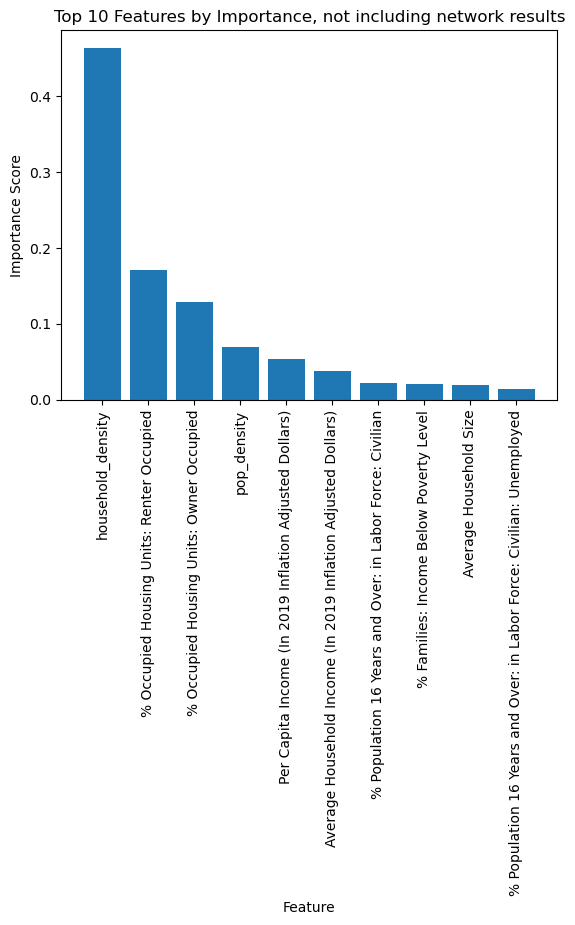

In [142]:
df = nyc_gdf[['inverse_vehicle_use', # % Commuters Without a Personal Vehicle
              'pop_density', # Population Density (Per sq. Meters)
              'household_density', # Household Density (Per sq. Meters)
              'PCT_SE_A10060_002', #: % Occupied Housing Units: Owner Occupied
              'PCT_SE_A10060_003', #: % Occupied Housing Units: Renter Occupied
              'SE_A14008_001', #: Average Household Income (In 2019 Inflation Adjusted Dollars)
              'SE_A14024_001', #: Per Capita Income (In 2019 Inflation Adjusted Dollars)
              'PCT_SE_A13002_002', #: % Families: Income Below Poverty Level
              'SE_A10003_001', #: Average Household Size
              'PCT_SE_A17002_004', #: % Population 16 Years and Over: in Labor Force: Civilian
              # 'PCT_SE_A17002_005', #: % Population 16 Years and Over: in Labor Force: Civilian: Employed
              'PCT_SE_A17002_006', #: % Population 16 Years and Over: in Labor Force: Civilian: Unemployed
              # 'PCT_SE_A10030_002', #: % Occupied Housing Units: No Vehicle Available
            # 'clse_mean_radius_400',
            # 'clse_mean_radius_800',
            # 'clse_mean_radius_1600',
            # 'clse_mean_radius_3200',
            # 'btwn_mean_radius_400',
            # 'btwn_mean_radius_800',
            # 'btwn_mean_radius_1600',
            # 'btwn_mean_radius_3200',
            # 'pgrk_mean_radius_400',
            # 'pgrk_mean_radius_800',
            # 'pgrk_mean_radius_1600',
            # 'pgrk_mean_radius_3200',
            # 'clse_sum_radius_400',
            # 'clse_sum_radius_800',
            # 'clse_sum_radius_1600',
            # 'clse_sum_radius_3200',
            # 'btwn_sum_radius_400',
            # 'btwn_sum_radius_800',
            # 'btwn_sum_radius_1600',
            # 'btwn_sum_radius_3200',
            # 'pgrk_sum_radius_400',
            # 'pgrk_sum_radius_800',
            # 'pgrk_sum_radius_1600',
            # 'pgrk_sum_radius_3200',
            ]]
# 
np.any(np.isnan(df))
np.all(np.isfinite(df))

df=df.dropna()
run_xgboost_no_cv(df)


     clse_mean btwn_mean pgrk_mean  clse_sum  btwn_sum  pgrk_sum
400   0.640894  0.621201  0.616973  0.632321  0.621054  0.618688
800   0.670698  0.646646  0.636734  0.668432  0.651221  0.647597
1600  0.678632   0.64805  0.635637  0.679756  0.662854  0.658881
3200    0.6772  0.664025  0.630583  0.686845  0.680575  0.672603


Text(0.5, 1.0, 'R-Squared values for XGBoost')

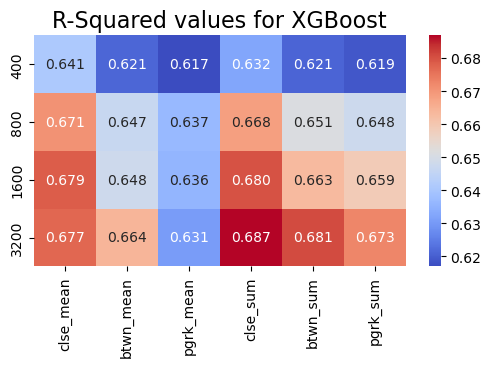

In [146]:
import pandas as pd
import numpy as np
import seaborn as sns

# Define dependent variable
y = df['inverse_vehicle_use']

# Define list of independent variables to loop through
independent_vars = ['clse_mean_radius_400',
                    'clse_mean_radius_800',
                    'clse_mean_radius_1600',
                    'clse_mean_radius_3200',
                    'btwn_mean_radius_400',
                    'btwn_mean_radius_800',
                    'btwn_mean_radius_1600',
                    'btwn_mean_radius_3200',
                    'pgrk_mean_radius_400',
                    'pgrk_mean_radius_800',
                    'pgrk_mean_radius_1600',
                    'pgrk_mean_radius_3200',
                    'clse_sum_radius_400',
                    'clse_sum_radius_800',
                    'clse_sum_radius_1600',
                    'clse_sum_radius_3200',
                    'btwn_sum_radius_400',
                    'btwn_sum_radius_800',
                    'btwn_sum_radius_1600',
                    'btwn_sum_radius_3200',
                    'pgrk_sum_radius_400',
                    'pgrk_sum_radius_800',
                    'pgrk_sum_radius_1600',
                    'pgrk_sum_radius_3200']

# Define column names
columns = ['clse_mean', 'clse_sum', 'btwn_mean', 'btwn_sum', 'pgrk_mean', 'pgrk_sum']

# Define index values
index = [400, 800, 1600, 3200]

# Create empty dataframe
results_df = pd.DataFrame(index=index, columns=columns)

# Loop through each variable and add it to the model
for var in independent_vars:
    # Define independent variables (including current variable)
    X = df[['inverse_vehicle_use', # % Commuters Without a Personal Vehicle
            'pop_density', # Population Density (Per sq. Meters)
            'household_density', # Household Density (Per sq. Meters)
            'PCT_SE_A10060_002', #: % Occupied Housing Units: Owner Occupied
            'PCT_SE_A10060_003', #: % Occupied Housing Units: Renter Occupied
            'SE_A14008_001', #: Average Household Income (In 2019 Inflation Adjusted Dollars)
            'SE_A14024_001', #: Per Capita Income (In 2019 Inflation Adjusted Dollars)
            'PCT_SE_A13002_002', #: % Families: Income Below Poverty Level
            'SE_A10003_001', #: Average Household Size
            'PCT_SE_A17002_004', #: % Population 16 Years and Over: in Labor Force: Civilian
            # 'PCT_SE_A17002_005', #: % Population 16 Years and Over: in Labor Force: Civilian: Employed
            'PCT_SE_A17002_006', #: % Population 16 Years and Over: in Labor Force: Civilian: Unemployed
            var]]
    # Store R-squared in dataframe
    rsquared = run_xgboost_no_cv(X, is_return_rsquared=True)
    var_name_1, var_name_2, radius_text, radius_value = var.split('_')
    results_df.loc[int(radius_value), var_name_1+'_'+var_name_2] = rsquared

# Show results dataframe
results_df = results_df[['clse_mean', 'btwn_mean', 'pgrk_mean', 'clse_sum', 'btwn_sum', 'pgrk_sum']]
print(results_df)

# Convert dataframe to numeric type
results_df = results_df.apply(pd.to_numeric)

# Create heatmap with text
fig, ax = plt.subplots(figsize=(6, 3))
sns.heatmap(results_df, annot=True, fmt='.3f', cmap='coolwarm')
ax.set_title('R-Squared values for XGBoost', fontsize=16)

     clse_mean btwn_mean pgrk_mean  clse_sum  btwn_sum  pgrk_sum
400   8.646596  8.973918  9.037245  8.777585  8.942513  9.001271
800   8.377428  8.736111  8.949775  8.443654   8.68953  8.726094
1600  8.280889  8.698442  8.901124  8.288985  8.464676  8.548828
3200  8.353545  8.489828   8.91197  8.206963   8.26301  8.382815


Text(0.5, 1.0, 'Mean Absolute Error values for XGBoost')

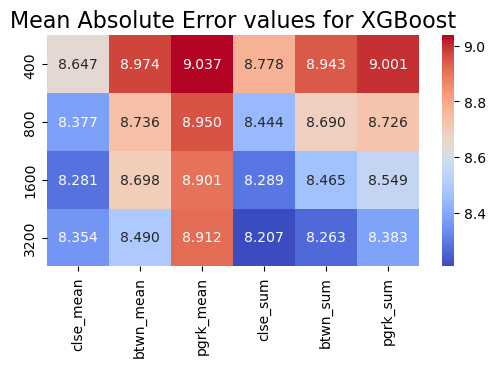

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns

# Define dependent variable
y = df['inverse_vehicle_use']

# Define list of independent variables to loop through
independent_vars = ['clse_mean_radius_400',
                    'clse_mean_radius_800',
                    'clse_mean_radius_1600',
                    'clse_mean_radius_3200',
                    'btwn_mean_radius_400',
                    'btwn_mean_radius_800',
                    'btwn_mean_radius_1600',
                    'btwn_mean_radius_3200',
                    'pgrk_mean_radius_400',
                    'pgrk_mean_radius_800',
                    'pgrk_mean_radius_1600',
                    'pgrk_mean_radius_3200',
                    'clse_sum_radius_400',
                    'clse_sum_radius_800',
                    'clse_sum_radius_1600',
                    'clse_sum_radius_3200',
                    'btwn_sum_radius_400',
                    'btwn_sum_radius_800',
                    'btwn_sum_radius_1600',
                    'btwn_sum_radius_3200',
                    'pgrk_sum_radius_400',
                    'pgrk_sum_radius_800',
                    'pgrk_sum_radius_1600',
                    'pgrk_sum_radius_3200']

# Define column names
columns = ['clse_mean', 'clse_sum', 'btwn_mean', 'btwn_sum', 'pgrk_mean', 'pgrk_sum']

# Define index values
index = [400, 800, 1600, 3200]

# Create empty dataframe
results_df = pd.DataFrame(index=index, columns=columns)

# Loop through each variable and add it to the model
for var in independent_vars:
    # Define independent variables (including current variable)
    X = df[['inverse_vehicle_use', # % Commuters Without a Personal Vehicle
            'pop_density', # Population Density (Per sq. Meters)
            'household_density', # Household Density (Per sq. Meters)
            'PCT_SE_A10060_002', #: % Occupied Housing Units: Owner Occupied
            'PCT_SE_A10060_003', #: % Occupied Housing Units: Renter Occupied
            'SE_A14008_001', #: Average Household Income (In 2019 Inflation Adjusted Dollars)
            'SE_A14024_001', #: Per Capita Income (In 2019 Inflation Adjusted Dollars)
            'PCT_SE_A13002_002', #: % Families: Income Below Poverty Level
            'SE_A10003_001', #: Average Household Size
            'PCT_SE_A17002_004', #: % Population 16 Years and Over: in Labor Force: Civilian
            # 'PCT_SE_A17002_005', #: % Population 16 Years and Over: in Labor Force: Civilian: Employed
            'PCT_SE_A17002_006', #: % Population 16 Years and Over: in Labor Force: Civilian: Unemployed
            var]]
    # Store R-squared in dataframe
    rsquared = run_xgboost_no_cv(X, is_return_mae=True)
    var_name_1, var_name_2, radius_text, radius_value = var.split('_')
    results_df.loc[int(radius_value), var_name_1+'_'+var_name_2] = rsquared

# Show results dataframe
results_df = results_df[['clse_mean', 'btwn_mean', 'pgrk_mean', 'clse_sum', 'btwn_sum', 'pgrk_sum']]
print(results_df)

# Convert dataframe to numeric type
results_df = results_df.apply(pd.to_numeric)

# Create heatmap with text
fig, ax = plt.subplots(figsize=(6, 3))
sns.heatmap(results_df, annot=True, fmt='.3f', cmap='coolwarm')
ax.set_title('Mean Absolute Error values for XGBoost', fontsize=16)

       clse_mean   btwn_mean   pgrk_mean    clse_sum    btwn_sum    pgrk_sum
400   135.788533  143.235129  144.833748   139.03037  143.290691  144.185261
800    124.51886  133.613669  137.361744  125.375651  131.883797  133.254015
1600  121.518779  133.082649   137.77651  121.093642  127.484889  128.987351
3200   122.06045  127.042281  139.687514  118.413161  120.784118  123.798552


Text(0.5, 1.0, 'Mean Squared Error values for XGBoost')

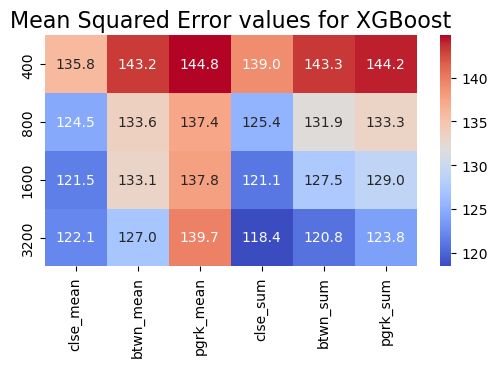

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns

# Define dependent variable
y = df['inverse_vehicle_use']

# Define list of independent variables to loop through
independent_vars = ['clse_mean_radius_400',
                    'clse_mean_radius_800',
                    'clse_mean_radius_1600',
                    'clse_mean_radius_3200',
                    'btwn_mean_radius_400',
                    'btwn_mean_radius_800',
                    'btwn_mean_radius_1600',
                    'btwn_mean_radius_3200',
                    'pgrk_mean_radius_400',
                    'pgrk_mean_radius_800',
                    'pgrk_mean_radius_1600',
                    'pgrk_mean_radius_3200',
                    'clse_sum_radius_400',
                    'clse_sum_radius_800',
                    'clse_sum_radius_1600',
                    'clse_sum_radius_3200',
                    'btwn_sum_radius_400',
                    'btwn_sum_radius_800',
                    'btwn_sum_radius_1600',
                    'btwn_sum_radius_3200',
                    'pgrk_sum_radius_400',
                    'pgrk_sum_radius_800',
                    'pgrk_sum_radius_1600',
                    'pgrk_sum_radius_3200']

# Define column names
columns = ['clse_mean', 'clse_sum', 'btwn_mean', 'btwn_sum', 'pgrk_mean', 'pgrk_sum']

# Define index values
index = [400, 800, 1600, 3200]

# Create empty dataframe
results_df = pd.DataFrame(index=index, columns=columns)

# Loop through each variable and add it to the model
for var in independent_vars:
    # Define independent variables (including current variable)
    X = df[['inverse_vehicle_use', # % Commuters Without a Personal Vehicle
            'pop_density', # Population Density (Per sq. Meters)
            'household_density', # Household Density (Per sq. Meters)
            'PCT_SE_A10060_002', #: % Occupied Housing Units: Owner Occupied
            'PCT_SE_A10060_003', #: % Occupied Housing Units: Renter Occupied
            'SE_A14008_001', #: Average Household Income (In 2019 Inflation Adjusted Dollars)
            'SE_A14024_001', #: Per Capita Income (In 2019 Inflation Adjusted Dollars)
            'PCT_SE_A13002_002', #: % Families: Income Below Poverty Level
            'SE_A10003_001', #: Average Household Size
            'PCT_SE_A17002_004', #: % Population 16 Years and Over: in Labor Force: Civilian
            # 'PCT_SE_A17002_005', #: % Population 16 Years and Over: in Labor Force: Civilian: Employed
            'PCT_SE_A17002_006', #: % Population 16 Years and Over: in Labor Force: Unemployed
            var]]
    # Store R-squared in dataframe
    rsquared = run_xgboost_no_cv(X, is_return_mse=True)
    var_name_1, var_name_2, radius_text, radius_value = var.split('_')
    results_df.loc[int(radius_value), var_name_1+'_'+var_name_2] = rsquared

# Show results dataframe
results_df = results_df[['clse_mean', 'btwn_mean', 'pgrk_mean', 'clse_sum', 'btwn_sum', 'pgrk_sum']]
print(results_df)

# Convert dataframe to numeric type
results_df = results_df.apply(pd.to_numeric)

# Create heatmap with text
fig, ax = plt.subplots(figsize=(6, 3))
sns.heatmap(results_df, annot=True, fmt='.1f', cmap='coolwarm')
ax.set_title('Mean Squared Error values for XGBoost', fontsize=16)

     clse_mean btwn_mean pgrk_mean  clse_sum  btwn_sum  pgrk_sum
400    0.15662  0.162198  0.162846  0.158473  0.161801  0.162325
800   0.150624  0.156231  0.159509  0.151295  0.155755  0.156067
1600  0.148501  0.156056  0.158798  0.148214  0.152546  0.152327
3200  0.148554  0.152027  0.158352  0.145219  0.147009  0.148453


Text(0.5, 1.0, 'Mean Absolute Percentage Error values for XGBoost')

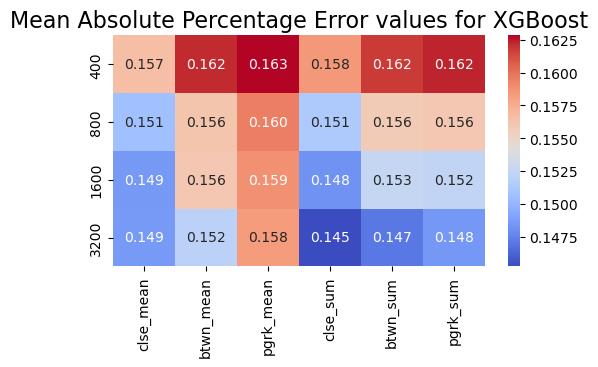

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns

# Define dependent variable
y = df['inverse_vehicle_use']

# Define list of independent variables to loop through
independent_vars = ['clse_mean_radius_400',
                    'clse_mean_radius_800',
                    'clse_mean_radius_1600',
                    'clse_mean_radius_3200',
                    'btwn_mean_radius_400',
                    'btwn_mean_radius_800',
                    'btwn_mean_radius_1600',
                    'btwn_mean_radius_3200',
                    'pgrk_mean_radius_400',
                    'pgrk_mean_radius_800',
                    'pgrk_mean_radius_1600',
                    'pgrk_mean_radius_3200',
                    'clse_sum_radius_400',
                    'clse_sum_radius_800',
                    'clse_sum_radius_1600',
                    'clse_sum_radius_3200',
                    'btwn_sum_radius_400',
                    'btwn_sum_radius_800',
                    'btwn_sum_radius_1600',
                    'btwn_sum_radius_3200',
                    'pgrk_sum_radius_400',
                    'pgrk_sum_radius_800',
                    'pgrk_sum_radius_1600',
                    'pgrk_sum_radius_3200']

# Define column names
columns = ['clse_mean', 'clse_sum', 'btwn_mean', 'btwn_sum', 'pgrk_mean', 'pgrk_sum']

# Define index values
index = [400, 800, 1600, 3200]

# Create empty dataframe
results_df = pd.DataFrame(index=index, columns=columns)

# Loop through each variable and add it to the model
for var in independent_vars:
    # Define independent variables (including current variable)
    X = df[['inverse_vehicle_use', # % Commuters Without a Personal Vehicle
            'pop_density', # Population Density (Per sq. Meters)
            'household_density', # Household Density (Per sq. Meters)
            'PCT_SE_A10060_002', #: % Occupied Housing Units: Owner Occupied
            'PCT_SE_A10060_003', #: % Occupied Housing Units: Renter Occupied
            'SE_A14008_001', #: Average Household Income (In 2019 Inflation Adjusted Dollars)
            'SE_A14024_001', #: Per Capita Income (In 2019 Inflation Adjusted Dollars)
            'PCT_SE_A13002_002', #: % Families: Income Below Poverty Level
            'SE_A10003_001', #: Average Household Size
            'PCT_SE_A17002_004', #: % Population 16 Years and Over: in Labor Force: Civilian
            # 'PCT_SE_A17002_005', #: % Population 16 Years and Over: in Labor Force: Civilian: Employed
            'PCT_SE_A17002_006', #: % Population 16 Years and Over: in Labor Force: Civilian: Unemployed
            var]]
    # Store R-squared in dataframe
    rsquared = run_xgboost_no_cv(X, is_return_mape=True)
    var_name_1, var_name_2, radius_text, radius_value = var.split('_')
    results_df.loc[int(radius_value), var_name_1+'_'+var_name_2] = rsquared

# Show results dataframe
results_df = results_df[['clse_mean', 'btwn_mean', 'pgrk_mean', 'clse_sum', 'btwn_sum', 'pgrk_sum']]
print(results_df)

# Convert dataframe to numeric type
results_df = results_df.apply(pd.to_numeric)

# Create heatmap with text
fig, ax = plt.subplots(figsize=(6, 3))
sns.heatmap(results_df, annot=True, fmt='.3f', cmap='coolwarm')
ax.set_title('Mean Absolute Percentage Error values for XGBoost', fontsize=16)

### OLS Regressions

In [145]:
# Reset dF
df = nyc_gdf[['inverse_vehicle_use', # % Commuters Without a Personal Vehicle
              'pop_density', # Population Density (Per sq. Meters)
              'household_density', # Household Density (Per sq. Meters)
              'PCT_SE_A10060_002', #: % Occupied Housing Units: Owner Occupied
              'PCT_SE_A10060_003', #: % Occupied Housing Units: Renter Occupied
              'SE_A14008_001', #: Average Household Income (In 2019 Inflation Adjusted Dollars)
              'SE_A14024_001', #: Per Capita Income (In 2019 Inflation Adjusted Dollars)
              'PCT_SE_A13002_002', #: % Families: Income Below Poverty Level
              'SE_A10003_001', #: Average Household Size
              'PCT_SE_A17002_004', #: % Population 16 Years and Over: in Labor Force: Civilian
              # 'PCT_SE_A17002_005', #: % Population 16 Years and Over: in Labor Force: Civilian: Employed
              'PCT_SE_A17002_006', #: % Population 16 Years and Over: in Labor Force: Civilian: Unemployed
              # 'PCT_SE_A10030_002', #: % Occupied Housing Units: No Vehicle Available
            'clse_mean_radius_400',
            'clse_mean_radius_800',
            'clse_mean_radius_1600',
            'clse_mean_radius_3200',
            'btwn_mean_radius_400',
            'btwn_mean_radius_800',
            'btwn_mean_radius_1600',
            'btwn_mean_radius_3200',
            'pgrk_mean_radius_400',
            'pgrk_mean_radius_800',
            'pgrk_mean_radius_1600',
            'pgrk_mean_radius_3200',
            'clse_sum_radius_400',
            'clse_sum_radius_800',
            'clse_sum_radius_1600',
            'clse_sum_radius_3200',
            'btwn_sum_radius_400',
            'btwn_sum_radius_800',
            'btwn_sum_radius_1600',
            'btwn_sum_radius_3200',
            'pgrk_sum_radius_400',
            'pgrk_sum_radius_800',
            'pgrk_sum_radius_1600',
            'pgrk_sum_radius_3200',
            'log_clse_mean_radius_400',
            'log_clse_mean_radius_800',
            'log_clse_mean_radius_1600',
            'log_clse_mean_radius_3200',
            'log_btwn_mean_radius_400',
            'log_btwn_mean_radius_800',
            'log_btwn_mean_radius_1600',
            'log_btwn_mean_radius_3200',
            'log_pgrk_mean_radius_400',
            'log_pgrk_mean_radius_800',
            'log_pgrk_mean_radius_1600',
            'log_pgrk_mean_radius_3200',
            'log_clse_sum_radius_400',
            'log_clse_sum_radius_800',
            'log_clse_sum_radius_1600',
            'log_clse_sum_radius_3200',
            'log_btwn_sum_radius_400',
            'log_btwn_sum_radius_800',
            'log_btwn_sum_radius_1600',
            'log_btwn_sum_radius_3200',
            'log_pgrk_sum_radius_400',
            'log_pgrk_sum_radius_800',
            'log_pgrk_sum_radius_1600',
            'log_pgrk_sum_radius_3200',
            ]]

In [ ]:
import statsmodels.api as sm

# Define dependent variable
y = df['inverse_vehicle_use']

# Define list of independent variables to loop through
independent_vars = ['clse_mean_radius_400',
                    'clse_mean_radius_800',
                    'clse_mean_radius_1600',
                    'clse_mean_radius_3200',
                    'btwn_mean_radius_400',
                    'btwn_mean_radius_800',
                    'btwn_mean_radius_1600',
                    'btwn_mean_radius_3200',
                    'pgrk_mean_radius_400',
                    'pgrk_mean_radius_800',
                    'pgrk_mean_radius_1600',
                    'pgrk_mean_radius_3200',
                    'clse_sum_radius_400',
                    'clse_sum_radius_800',
                    'clse_sum_radius_1600',
                    'clse_sum_radius_3200',
                    'btwn_sum_radius_400',
                    'btwn_sum_radius_800',
                    'btwn_sum_radius_1600',
                    'btwn_sum_radius_3200',
                    'pgrk_sum_radius_400',
                    'pgrk_sum_radius_800',
                    'pgrk_sum_radius_1600',
                    'pgrk_sum_radius_3200']

# Loop through each variable and add it to the model
for var in independent_vars:
    # Define independent variables (including current variable)
    X = df[['pop_density',
            'household_density',
            'PCT_SE_A10060_002',
            'PCT_SE_A10060_003',
            'SE_A14008_001',
            'SE_A14024_001',
            'PCT_SE_A13002_002',
            'SE_A10003_001',
            'PCT_SE_A17002_004',
            'PCT_SE_A17002_005',
            'PCT_SE_A17002_006',
            var]]

    # Add constant to independent variables
    X = sm.add_constant(X)

    # Fit OLS model
    model = sm.OLS(y, X).fit()

    # Print R-squared and p-value for variable
    print("Variable: ", var)
    print("R-squared: ", model.rsquared)
    print("Variable p-value: ", model.pvalues[var])


Variable:  clse_mean_radius_400
R-squared:  0.5834354394693222
Variable p-value:  3.1365936776827996e-184
Variable:  clse_mean_radius_800
R-squared:  0.6282843869788213
Variable p-value:  0.0
Variable:  clse_mean_radius_1600
R-squared:  0.6315099973916654
Variable p-value:  0.0
Variable:  clse_mean_radius_3200
R-squared:  0.6147904413234769
Variable p-value:  2.4217895414447238e-281
Variable:  btwn_mean_radius_400
R-squared:  0.5310822985307794
Variable p-value:  4.230689410665214e-37
Variable:  btwn_mean_radius_800
R-squared:  0.5385733725511237
Variable p-value:  3.661528626007529e-57
Variable:  btwn_mean_radius_1600
R-squared:  0.5674437028293966
Variable p-value:  1.8425010949982262e-137
Variable:  btwn_mean_radius_3200
R-squared:  0.6055163147485505
Variable p-value:  8.011375898092216e-252
Variable:  pgrk_mean_radius_400
R-squared:  0.5453528323427626
Variable p-value:  1.4154090940642733e-75
Variable:  pgrk_mean_radius_800
R-squared:  0.5551937728544313
Variable p-value:  8.9633

     clse_mean btwn_mean pgrk_mean  clse_sum  btwn_sum  pgrk_sum
400   0.583368  0.531012   0.54522  0.552191  0.533646  0.542432
800   0.628278  0.538532  0.555134  0.571277  0.545658  0.562889
1600  0.631403    0.5674  0.548257  0.593132   0.56858  0.591073
3200  0.614628  0.605421  0.536155  0.614142  0.592956  0.612851


Text(0.5, 1.0, 'R-Squared values for OLS')

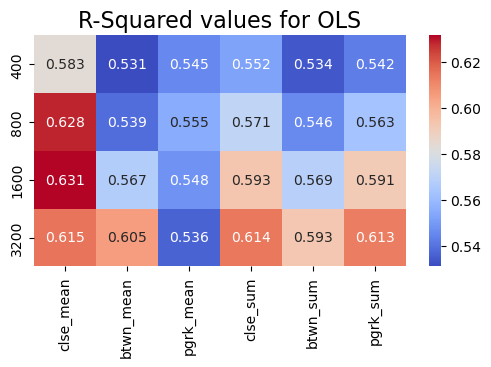

In [ ]:
import statsmodels.api as sm
import pandas as pd
import numpy as np
import seaborn as sns

# Define dependent variable
y = df['inverse_vehicle_use']

# Define list of independent variables to loop through
independent_vars = ['clse_mean_radius_400',
                    'clse_mean_radius_800',
                    'clse_mean_radius_1600',
                    'clse_mean_radius_3200',
                    'btwn_mean_radius_400',
                    'btwn_mean_radius_800',
                    'btwn_mean_radius_1600',
                    'btwn_mean_radius_3200',
                    'pgrk_mean_radius_400',
                    'pgrk_mean_radius_800',
                    'pgrk_mean_radius_1600',
                    'pgrk_mean_radius_3200',
                    'clse_sum_radius_400',
                    'clse_sum_radius_800',
                    'clse_sum_radius_1600',
                    'clse_sum_radius_3200',
                    'btwn_sum_radius_400',
                    'btwn_sum_radius_800',
                    'btwn_sum_radius_1600',
                    'btwn_sum_radius_3200',
                    'pgrk_sum_radius_400',
                    'pgrk_sum_radius_800',
                    'pgrk_sum_radius_1600',
                    'pgrk_sum_radius_3200']

# Define column names
columns = ['clse_mean', 'clse_sum', 'btwn_mean', 'btwn_sum', 'pgrk_mean', 'pgrk_sum']

# Define index values
index = [400, 800, 1600, 3200]

# Create empty dataframe
results_df = pd.DataFrame(index=index, columns=columns)

# Loop through each variable and add it to the model
for var in independent_vars:
    # Define independent variables (including current variable)
    X = df[['pop_density', # Population Density (Per sq. Meters)
            'household_density', # Household Density (Per sq. Meters)
            'PCT_SE_A10060_002', #: % Occupied Housing Units: Owner Occupied
            'PCT_SE_A10060_003', #: % Occupied Housing Units: Renter Occupied
            'SE_A14008_001', #: Average Household Income (In 2019 Inflation Adjusted Dollars)
            'SE_A14024_001', #: Per Capita Income (In 2019 Inflation Adjusted Dollars)
            'PCT_SE_A13002_002', #: % Families: Income Below Poverty Level
            'SE_A10003_001', #: Average Household Size
            'PCT_SE_A17002_004', #: % Population 16 Years and Over: in Labor Force: Civilian
            # 'PCT_SE_A17002_005', #: % Population 16 Years and Over: in Labor Force: Civilian: Employed
            'PCT_SE_A17002_006', #: % Population 16 Years and Over: in Labor Force: Civilian: Unemployed
            var]]

    # Add constant to independent variables
    X = sm.add_constant(X)

    # Fit OLS model
    model = sm.OLS(y, X).fit()

    # Store R-squared in dataframe
    rsquared = model.rsquared
    var_name_1, var_name_2, radius_text, radius_value = var.split('_')
    results_df.loc[int(radius_value), var_name_1+'_'+var_name_2] = rsquared

# Show results dataframe
results_df = results_df[['clse_mean', 'btwn_mean', 'pgrk_mean', 'clse_sum', 'btwn_sum', 'pgrk_sum']]
print(results_df)

# Convert dataframe to numeric type
results_df = results_df.apply(pd.to_numeric)

fig, ax = plt.subplots(figsize=(6, 3))
sns.heatmap(results_df, annot=True, fmt='.3f', cmap='coolwarm')
ax.set_title('R-Squared values for OLS', fontsize=16)

In [144]:
import pandas as pd
import numpy as np
import seaborn as sns

# Define dependent variable
y = df['inverse_vehicle_use']

# Define list of independent variables to loop through
independent_vars = ['log_clse_mean_radius_400',
                    'log_clse_mean_radius_800',
                    'log_clse_mean_radius_1600',
                    'log_clse_mean_radius_3200',
                    'log_btwn_mean_radius_400',
                    'log_btwn_mean_radius_800',
                    'log_btwn_mean_radius_1600',
                    'log_btwn_mean_radius_3200',
                    'log_pgrk_mean_radius_400',
                    'log_pgrk_mean_radius_800',
                    'log_pgrk_mean_radius_1600',
                    'log_pgrk_mean_radius_3200',
                    'log_clse_sum_radius_400',
                    'log_clse_sum_radius_800',
                    'log_clse_sum_radius_1600',
                    'log_clse_sum_radius_3200',
                    'log_btwn_sum_radius_400',
                    'log_btwn_sum_radius_800',
                    'log_btwn_sum_radius_1600',
                    'log_btwn_sum_radius_3200',
                    'log_pgrk_sum_radius_400',
                    'log_pgrk_sum_radius_800',
                    'log_pgrk_sum_radius_1600',
                    'log_pgrk_sum_radius_3200']

# Define column names
columns = ['clse_mean', 'clse_sum', 'btwn_mean', 'btwn_sum', 'pgrk_mean', 'pgrk_sum']

# Define index values
index = [400, 800, 1600, 3200]

# Create empty dataframe
results_df = pd.DataFrame(index=index, columns=columns)

# Loop through each variable and add it to the model
for var in independent_vars:
    # Define independent variables (including current variable)
    X = df[['pop_density', # Population Density (Per sq. Meters)
            'household_density', # Household Density (Per sq. Meters)
            'PCT_SE_A10060_002', #: % Occupied Housing Units: Owner Occupied
            'PCT_SE_A10060_003', #: % Occupied Housing Units: Renter Occupied
            'SE_A14008_001', #: Average Household Income (In 2019 Inflation Adjusted Dollars)
            'SE_A14024_001', #: Per Capita Income (In 2019 Inflation Adjusted Dollars)
            'PCT_SE_A13002_002', #: % Families: Income Below Poverty Level
            'SE_A10003_001', #: Average Household Size
            'PCT_SE_A17002_004', #: % Population 16 Years and Over: in Labor Force: Civilian
            # 'PCT_SE_A17002_005', #: % Population 16 Years and Over: in Labor Force: Civilian: Employed
            'PCT_SE_A17002_006', #: % Population 16 Years and Over: in Labor Force: Civilian: Unemployed
            var]]

    # Add constant to independent variables
    X = sm.add_constant(X)

    # Fit OLS model
    model = sm.OLS(y, X).fit()

    # Store R-squared in dataframe
    rsquared = model.rsquared
    log_str, var_name_1, var_name_2, radius_text, radius_value = var.split('_')
    results_df.loc[int(radius_value), log_str+'_'+var_name_1+'_'+var_name_2] = rsquared

# Show results dataframe
results_df = results_df[['clse_mean', 'btwn_mean', 'pgrk_mean', 'clse_sum', 'btwn_sum', 'pgrk_sum']]
print(results_df)

# Convert dataframe to numeric type
results_df = results_df.apply(pd.to_numeric)

fig, ax = plt.subplots(figsize=(6, 3))
sns.heatmap(results_df, annot=True, fmt='.3f', cmap='coolwarm')
ax.set_title('R-Squared values for OLS', fontsize=16)

KeyError: "['log_clse_mean_radius_400'] not in index"

     clse_mean btwn_mean pgrk_mean clse_sum btwn_sum pgrk_sum
400        0.0       0.0       0.0      0.0      0.0      0.0
800        0.0       0.0       0.0      0.0      0.0      0.0
1600       0.0       0.0       0.0      0.0      0.0      0.0
3200       0.0       0.0       0.0      0.0      0.0      0.0


Text(0.5, 1.0, 'p values for OLS')

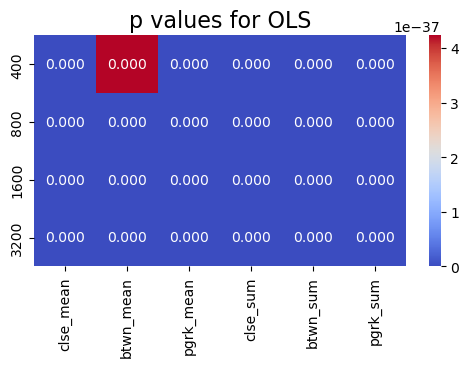

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns

# Define dependent variable
y = df['inverse_vehicle_use']

# Define list of independent variables to loop through
independent_vars = ['clse_mean_radius_400',
                    'clse_mean_radius_800',
                    'clse_mean_radius_1600',
                    'clse_mean_radius_3200',
                    'btwn_mean_radius_400',
                    'btwn_mean_radius_800',
                    'btwn_mean_radius_1600',
                    'btwn_mean_radius_3200',
                    'pgrk_mean_radius_400',
                    'pgrk_mean_radius_800',
                    'pgrk_mean_radius_1600',
                    'pgrk_mean_radius_3200',
                    'clse_sum_radius_400',
                    'clse_sum_radius_800',
                    'clse_sum_radius_1600',
                    'clse_sum_radius_3200',
                    'btwn_sum_radius_400',
                    'btwn_sum_radius_800',
                    'btwn_sum_radius_1600',
                    'btwn_sum_radius_3200',
                    'pgrk_sum_radius_400',
                    'pgrk_sum_radius_800',
                    'pgrk_sum_radius_1600',
                    'pgrk_sum_radius_3200']

# Define column names
columns = ['clse_mean', 'clse_sum', 'btwn_mean', 'btwn_sum', 'pgrk_mean', 'pgrk_sum']

# Define index values
index = [400, 800, 1600, 3200]

# Create empty dataframe
results_df = pd.DataFrame(index=index, columns=columns)

# Loop through each variable and add it to the model
for var in independent_vars:
    # Define independent variables (including current variable)
    X = df[['pop_density', # Population Density (Per sq. Meters)
            'household_density', # Household Density (Per sq. Meters)
            'PCT_SE_A10060_002', #: % Occupied Housing Units: Owner Occupied
            'PCT_SE_A10060_003', #: % Occupied Housing Units: Renter Occupied
            'SE_A14008_001', #: Average Household Income (In 2019 Inflation Adjusted Dollars)
            'SE_A14024_001', #: Per Capita Income (In 2019 Inflation Adjusted Dollars)
            'PCT_SE_A13002_002', #: % Families: Income Below Poverty Level
            'SE_A10003_001', #: Average Household Size
            'PCT_SE_A17002_004', #: % Population 16 Years and Over: in Labor Force: Civilian
            # 'PCT_SE_A17002_005', #: % Population 16 Years and Over: in Labor Force: Civilian: Employed
            'PCT_SE_A17002_006', #: % Population 16 Years and Over: in Labor Force: Civilian: Unemployed
            var]]

    # Add constant to independent variables
    X = sm.add_constant(X)

    # Fit OLS model
    model = sm.OLS(y, X).fit()

    # Store p-value for a specific variable in dataframe
    variable_p_value = model.pvalues[var]
    var_name_1, var_name_2, radius_text, radius_value = var.split('_')
    results_df.loc[int(radius_value), var_name_1+'_'+var_name_2] = variable_p_value

# Show results dataframe
results_df = results_df[['clse_mean', 'btwn_mean', 'pgrk_mean', 'clse_sum', 'btwn_sum', 'pgrk_sum']]
print(results_df)

# Convert dataframe to numeric type
results_df = results_df.apply(pd.to_numeric)

# Create heatmap with text
fig, ax = plt.subplots(figsize=(6, 3))
sns.heatmap(results_df, annot=True, fmt='.3f', cmap='coolwarm')
ax.set_title('p values for OLS', fontsize=16)

In [ ]:
import statsmodels.api as sm

# Define dependent and independent variables
y = df['inverse_vehicle_use']
# X = df.drop(['inverse_vehicle_use'], axis=1)
X = df[[ #'inverse_vehicle_use', # % Commuters Without a Personal Vehicle
        'pop_density', # Population Density (Per sq. Meters)
        'household_density', # Household Density (Per sq. Meters)
        'PCT_SE_A10060_002', #: % Occupied Housing Units: Owner Occupied
        'PCT_SE_A10060_003', #: % Occupied Housing Units: Renter Occupied
        'SE_A14008_001', #: Average Household Income (In 2019 Inflation Adjusted Dollars)
        'SE_A14024_001', #: Per Capita Income (In 2019 Inflation Adjusted Dollars)
        'PCT_SE_A13002_002', #: % Families: Income Below Poverty Level
        'SE_A10003_001', #: Average Household Size
        'PCT_SE_A17002_004', #: % Population 16 Years and Over: in Labor Force: Civilian
        # 'PCT_SE_A17002_005', #: % Population 16 Years and Over: in Labor Force: Civilian: Employed
        'PCT_SE_A17002_006', #: % Population 16 Years and Over: in Labor Force: Civilian: Unemployed
        # 'PCT_SE_A10030_002', #: % Occupied Housing Units: No Vehicle Available
        ]]

# Add constant to independent variables
X = sm.add_constant(X)

# Fit OLS model
model = sm.OLS(y, X).fit()

# Print R-squared
r_squared = model.rsquared
print("R-squared: ", r_squared)

# Retrieve p-value for a specific variable
variable_p_value = model.pvalues['pop_density']
print("variable_p_value: ", variable_p_value)

# Print summary of regression results
print(model.summary())

In [ ]:
nyc_gdf[['Geo_AREALAND', 'SE_A00002_003']]

,Geo_AREALAND,SE_A00002_003
1,89013,0.034368
2,187653,0.072453
3,178656,0.068979
4,62874,0.024276
5,320916,0.123906
...,...,...
5903,188395,0.072740
5904,131127,0.050628
5905,115922,0.044758
5906,118439,0.045730


### no centrality value

In [ ]:
import statsmodels.api as sm

# Define dependent and independent variables
y = df['inverse_vehicle_use']
# X = df.drop(['inverse_vehicle_use'], axis=1)
X = df[[# 'inverse_vehicle_use', # % Commuters Without a Personal Vehicle
        'pop_density', # Population Density (Per sq. Meters)
        'household_density', # Household Density (Per sq. Meters)
        'PCT_SE_A10060_002', #: % Occupied Housing Units: Owner Occupied
        'PCT_SE_A10060_003', #: % Occupied Housing Units: Renter Occupied
        'SE_A14008_001', #: Average Household Income (In 2019 Inflation Adjusted Dollars)
        'SE_A14024_001', #: Per Capita Income (In 2019 Inflation Adjusted Dollars)
        'PCT_SE_A13002_002', #: % Families: Income Below Poverty Level
        'SE_A10003_001', #: Average Household Size
        'PCT_SE_A17002_004', #: % Population 16 Years and Over: in Labor Force: Civilian
        # 'PCT_SE_A17002_005', #: % Population 16 Years and Over: in Labor Force: Civilian: Employed
        'PCT_SE_A17002_006', #: % Population 16 Years and Over: in Labor Force: Civilian: Unemployed
        # 'PCT_SE_A10030_002', #: % Occupied Housing Units: No Vehicle Available
        ]]

# Add constant to independent variables
X = sm.add_constant(X)

# Fit OLS model
model = sm.OLS(y, X).fit()

# Print R-squared
r_squared = model.rsquared
print("R-squared: ", r_squared)

# Retrieve p-value for a specific variable
variable_p_value = model.pvalues['pop_density']
print("variable_p_value: ", variable_p_value)

# Print summary of regression results
print(model.summary())

R-squared:  0.5175034034784235
variable_p_value:  8.653401214345569e-14
                             OLS Regression Results                            
Dep. Variable:     inverse_vehicle_use   R-squared:                       0.518
Model:                             OLS   Adj. R-squared:                  0.517
Method:                  Least Squares   F-statistic:                     612.6
Date:                 Tue, 09 May 2023   Prob (F-statistic):               0.00
Time:                         20:31:17   Log-Likelihood:                -22985.
No. Observations:                 5723   AIC:                         4.599e+04
Df Residuals:                     5712   BIC:                         4.607e+04
Df Model:                           10                                         
Covariance Type:             nonrobust                                         
                        coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------

### applicable centrality value

In [ ]:
import statsmodels.api as sm

# Define dependent and independent variables
y = df['inverse_vehicle_use']
# X = df.drop(['inverse_vehicle_use'], axis=1)
X = df[[ # 'inverse_vehicle_use',
        'pop_density', # Population Density (Per sq. Meters)
        'household_density', # Household Density (Per sq. Meters)
        'PCT_SE_A10060_002', #: % Occupied Housing Units: Owner Occupied
        'PCT_SE_A10060_003', #: % Occupied Housing Units: Renter Occupied
        'SE_A14008_001', #: Average Household Income (In 2019 Inflation Adjusted Dollars)
        'SE_A14024_001', #: Per Capita Income (In 2019 Inflation Adjusted Dollars)
        'PCT_SE_A13002_002', #: % Families: Income Below Poverty Level
        'SE_A10003_001', #: Average Household Size
        'PCT_SE_A17002_004', #: % Population 16 Years and Over: in Labor Force: Civilian
        # 'PCT_SE_A17002_005', #: % Population 16 Years and Over: in Labor Force: Civilian: Employed
        'PCT_SE_A17002_006', #: % Population 16 Years and Over: in Labor Force: Civilian: Unemployed
        # 'PCT_SE_A10030_002', #: % Occupied Housing Units: No Vehicle Available
            # 'clse_mean_radius_400',
            # 'clse_mean_radius_800',
            # 'clse_mean_radius_1600',
            # 'clse_mean_radius_3200',
            # 'btwn_mean_radius_400',
            # 'btwn_mean_radius_800',
            # 'btwn_mean_radius_1600',
            # 'btwn_mean_radius_3200',
            # 'pgrk_mean_radius_400',
            # 'pgrk_mean_radius_800',
            # 'pgrk_mean_radius_1600',
            # 'pgrk_mean_radius_3200',
            # 'clse_sum_radius_400',
            # 'clse_sum_radius_800',
            # 'clse_sum_radius_1600',
            'clse_sum_radius_3200',
            # 'btwn_sum_radius_400',
            # 'btwn_sum_radius_800',
            # 'btwn_sum_radius_1600',
            # 'btwn_sum_radius_3200',
            # 'pgrk_sum_radius_400',
            # 'pgrk_sum_radius_800',
            # 'pgrk_sum_radius_1600',
            # 'pgrk_sum_radius_3200',
        ]]

# Add constant to independent variables
X = sm.add_constant(X)

# Fit OLS model
model = sm.OLS(y, X).fit()

# Print summary of regression results
print(model.summary())

                             OLS Regression Results                            
Dep. Variable:     inverse_vehicle_use   R-squared:                       0.614
Model:                             OLS   Adj. R-squared:                  0.613
Method:                  Least Squares   F-statistic:                     826.3
Date:                 Tue, 09 May 2023   Prob (F-statistic):               0.00
Time:                         20:50:00   Log-Likelihood:                -22345.
No. Observations:                 5723   AIC:                         4.471e+04
Df Residuals:                     5711   BIC:                         4.479e+04
Df Model:                           11                                         
Covariance Type:             nonrobust                                         
                           coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                 

### other centrality values

In [ ]:
import statsmodels.api as sm

# Define dependent and independent variables
y = df['inverse_vehicle_use']
# X = df.drop(['inverse_vehicle_use'], axis=1)
X = df[[ # 'inverse_vehicle_use',
        'pop_density',
        'household_density',
        'PCT_SE_A10060_002', #: % Occupied Housing Units: Owner Occupied
        'PCT_SE_A10060_003', #: % Occupied Housing Units: Renter Occupied
        'SE_A14008_001', #: Average Household Income (In 2019 Inflation Adjusted Dollars)
        'SE_A14024_001', #: Per Capita Income (In 2019 Inflation Adjusted Dollars)
        'PCT_SE_A13002_002', #: % Families: Income Below Poverty Level
        'SE_A10003_001', #: Average Household Size
        'PCT_SE_A17002_004', #: % Population 16 Years and Over: in Labor Force: Civilian
        # 'PCT_SE_A17002_005', #: % Population 16 Years and Over: in Labor Force: Civilian: Employed
        'PCT_SE_A17002_006', #: % Population 16 Years and Over: in Labor Force: Civilian: Unemployed
        # 'PCT_SE_A10030_002', #: % Occupied Housing Units: No Vehicle Available
            # 'clse_mean_radius_400',
            # 'clse_mean_radius_800',
            'clse_mean_radius_1600',
            # 'clse_mean_radius_3200',
            # 'btwn_mean_radius_400',
            # 'btwn_mean_radius_800',
            # 'btwn_mean_radius_1600',
            # 'btwn_mean_radius_3200',
            # 'pgrk_mean_radius_400',
            # 'pgrk_mean_radius_800',
            # 'pgrk_mean_radius_1600',
            # 'pgrk_mean_radius_3200',
            # 'clse_sum_radius_400',
            # 'clse_sum_radius_800',
            # 'clse_sum_radius_1600',
            # 'clse_sum_radius_3200',
            # 'btwn_sum_radius_400',
            # 'btwn_sum_radius_800',
            # 'btwn_sum_radius_1600',
            # 'btwn_sum_radius_3200',
            # 'pgrk_sum_radius_400',
            # 'pgrk_sum_radius_800',
            # 'pgrk_sum_radius_1600',
            # 'pgrk_sum_radius_3200',
        ]]

# Add constant to independent variables
X = sm.add_constant(X)

# Fit OLS model
model = sm.OLS(y, X).fit()

# Print summary of regression results
print(model.summary())

                             OLS Regression Results                            
Dep. Variable:     inverse_vehicle_use   R-squared:                       0.631
Model:                             OLS   Adj. R-squared:                  0.631
Method:                  Least Squares   F-statistic:                     889.4
Date:                 Tue, 09 May 2023   Prob (F-statistic):               0.00
Time:                         18:48:57   Log-Likelihood:                -22214.
No. Observations:                 5723   AIC:                         4.445e+04
Df Residuals:                     5711   BIC:                         4.453e+04
Df Model:                           11                                         
Covariance Type:             nonrobust                                         
                            coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const               

In [ ]:
import statsmodels.api as sm

# Define dependent and independent variables
y = df['inverse_vehicle_use']
# X = df.drop(['inverse_vehicle_use'], axis=1)
X = df[[ # 'inverse_vehicle_use',
        'pop_density',
        'household_density',
        'PCT_SE_A10060_002', #: % Occupied Housing Units: Owner Occupied
        'PCT_SE_A10060_003', #: % Occupied Housing Units: Renter Occupied
        'SE_A14008_001', #: Average Household Income (In 2019 Inflation Adjusted Dollars)
        'SE_A14024_001', #: Per Capita Income (In 2019 Inflation Adjusted Dollars)
        'PCT_SE_A13002_002', #: % Families: Income Below Poverty Level
        'SE_A10003_001', #: Average Household Size
        'PCT_SE_A17002_004', #: % Population 16 Years and Over: in Labor Force: Civilian
        # 'PCT_SE_A17002_005', #: % Population 16 Years and Over: in Labor Force: Civilian: Employed
        'PCT_SE_A17002_006', #: % Population 16 Years and Over: in Labor Force: Civilian: Unemployed
        # 'PCT_SE_A10030_002', #: % Occupied Housing Units: No Vehicle Available
            # 'clse_mean_radius_400',
            # 'clse_mean_radius_800',
            'clse_mean_radius_1600',
            # 'clse_mean_radius_3200',
            # 'btwn_mean_radius_400',
            # 'btwn_mean_radius_800',
            # 'btwn_mean_radius_1600',
            # 'btwn_mean_radius_3200',
            # 'pgrk_mean_radius_400',
            # 'pgrk_mean_radius_800',
            # 'pgrk_mean_radius_1600',
            # 'pgrk_mean_radius_3200',
            # 'clse_sum_radius_400',
            # 'clse_sum_radius_800',
            # 'clse_sum_radius_1600',
            'clse_sum_radius_3200',
            # 'btwn_sum_radius_400',
            # 'btwn_sum_radius_800',
            # 'btwn_sum_radius_1600',
            # 'btwn_sum_radius_3200',
            # 'pgrk_sum_radius_400',
            # 'pgrk_sum_radius_800',
            # 'pgrk_sum_radius_1600',
            # 'pgrk_sum_radius_3200',
        ]]

# Add constant to independent variables
X = sm.add_constant(X)

# Fit OLS model
model = sm.OLS(y, X).fit()

# Print summary of regression results
print(model.summary())

                             OLS Regression Results                            
Dep. Variable:     inverse_vehicle_use   R-squared:                       0.644
Model:                             OLS   Adj. R-squared:                  0.643
Method:                  Least Squares   F-statistic:                     860.7
Date:                 Tue, 09 May 2023   Prob (F-statistic):               0.00
Time:                         18:49:33   Log-Likelihood:                -22115.
No. Observations:                 5723   AIC:                         4.426e+04
Df Residuals:                     5710   BIC:                         4.434e+04
Df Model:                           12                                         
Covariance Type:             nonrobust                                         
                            coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const               

# Single Choropleth Charts

### Function

In [ ]:
# def plot_single_choropleth(nyc_gdf, variable, title):
    
#     # Create a figure with a single subplot
#     fig, ax = plt.subplots(figsize=(20, 20))
    
#     # Plot the choropleth map on the subplot
#     nyc_gdf.plot(column=variable, legend=True, ax=ax)
    
#     # Add block group boundaries to the subplot
#     nyc_gdf.plot(linewidth=0.5, edgecolor='black', facecolor='none', ax=ax)

#     # Add a title to the figure
#     fig.suptitle(title, fontsize=16)
    
#     # Display the figure
#     plt.show()
def plot_single_choropleth(nyc_gdf, variable, title):
    
    # Create a figure with a single subplot
    fig, ax = plt.subplots(figsize=(8, 8))
    
    # Plot the choropleth map on the subplot
    nyc_gdf.plot(column=variable, legend=True, ax=ax)
    
    # Add block group boundaries to the subplot
    nyc_gdf.plot(linewidth=0.5, edgecolor='black', facecolor='none', ax=ax)

    # Add a title to the figure
    fig.suptitle(title, fontsize=20)
    
    # Adjust the top margin to reduce whitespace
    fig.subplots_adjust(top=.92)
    
    # Display the figure
    plt.show()


### Data Cleanup

In [ ]:
# Read pickle
nyc_gdf = pd.read_pickle('./weighed_nyc_gdf.pkl', compression='gzip')

# Clean for column variables where over 100 values are N/A
na_threshold = 100
na_counts = nyc_gdf.isna().sum()

## Validate columns
# for col in nyc_gdf.columns:
#     na_count = nyc_gdf[col].isna().sum()
#     print(f"{na_count} missing \t - {col}")

# Print columns and their respective number of missing values
cols_to_remove = na_counts[na_counts > na_threshold].index.tolist()
for col in cols_to_remove:
    na_count = na_counts[col]
    print(f"{na_count} missing \t - {col}")

# Find columns with more than "na_threshold" missing values
na_counts = nyc_gdf.isna().sum(axis=0)

cols_to_remove = na_counts[na_counts > na_threshold].index

# Remove columns with more than "na_threshold" missing values
nyc_gdf = nyc_gdf.loc[:, ~nyc_gdf.columns.isin(cols_to_remove)]

# Drop NaN values to remove the parks and the like
nyc_gdf = nyc_gdf.dropna()

# # Find all columns ending in an 's' in nyc_gdf and print in a for loop
# for col in nyc_gdf.columns:
#     if col.endswith('s'):
#         print(col)
        
# Filter nyc_gdf for all columns not ending in an 's'
nyc_gdf = nyc_gdf[[col for col in nyc_gdf.columns if not col.endswith('s')]]

## New Columns

# Prepare data with manually calculated variables
nyc_gdf['inverse_vehicle_use'] = 100 - nyc_gdf['PCT_ACS19_5yr_B08301002']

# # nyc_gdf['log_inverse_vehicle_use'] = np.log(nyc_gdf['inverse_vehicle_use'])

nyc_gdf['pop_density'] = nyc_gdf['ACS19_5yr_B01001001'] / nyc_gdf['Geo_AREALAND']
nyc_gdf['household_density'] = nyc_gdf['ACS19_5yr_B11001001'] / nyc_gdf['Geo_AREALAND']

# ####

# # Filter nyc_gdf columns for numeric values
# nyc_gdf = nyc_gdf.loc[:,'Geo_AREALAND':]
# nyc_gdf = nyc_gdf.loc[:, ~nyc_gdf.columns.isin(nyc_gdf.loc[:, 'STATEFP':'geometry'].columns)]


# ####

# # Load the column names file
# column_decode = pd.read_csv('./data/socialexplorer_nyc_blockgroup_data/column_names.csv', header=None, index_col=1)

# # Loop through each column in nyc_gdf and print the corresponding code and definition
# for column in nyc_gdf.columns:
#     if column in column_decode.index:
#         code = column
#         definition = column_decode.loc[column, 0]
#     else:
#         code = " --- "
#         definition = " --- "
        
#     print(f"{column}: {definition}")


5908 missing 	 - Geo_US
5908 missing 	 - Geo_REGION
5908 missing 	 - Geo_DIVISION
5908 missing 	 - Geo_STATECE
5908 missing 	 - Geo_COUSUB
5908 missing 	 - Geo_PLACE
5908 missing 	 - Geo_PLACESE
5908 missing 	 - Geo_CONCIT
5908 missing 	 - Geo_AIANHH
5908 missing 	 - Geo_AIANHHFP
5908 missing 	 - Geo_AIHHTLI
5908 missing 	 - Geo_AITSCE
5908 missing 	 - Geo_AITS
5908 missing 	 - Geo_ANRC
5908 missing 	 - Geo_CBSA
5908 missing 	 - Geo_CSA
5908 missing 	 - Geo_METDIV
5908 missing 	 - Geo_MACC
5908 missing 	 - Geo_MEMI
5908 missing 	 - Geo_NECTA
5908 missing 	 - Geo_CNECTA
5908 missing 	 - Geo_NECTADIV
5908 missing 	 - Geo_UA
5908 missing 	 - Geo_UACP
5908 missing 	 - Geo_CDCURR
5908 missing 	 - Geo_SLDU
5908 missing 	 - Geo_SLDL
5908 missing 	 - Geo_VTD
5908 missing 	 - Geo_ZCTA3
5908 missing 	 - Geo_ZCTA5
5908 missing 	 - Geo_SUBMCD
5908 missing 	 - Geo_SDELM
5908 missing 	 - Geo_SDSEC
5908 missing 	 - Geo_SDUNI
5908 missing 	 - Geo_UR
5908 missing 	 - Geo_PCI
5908 missing 	 - Geo_TAZ
59

### Graphs

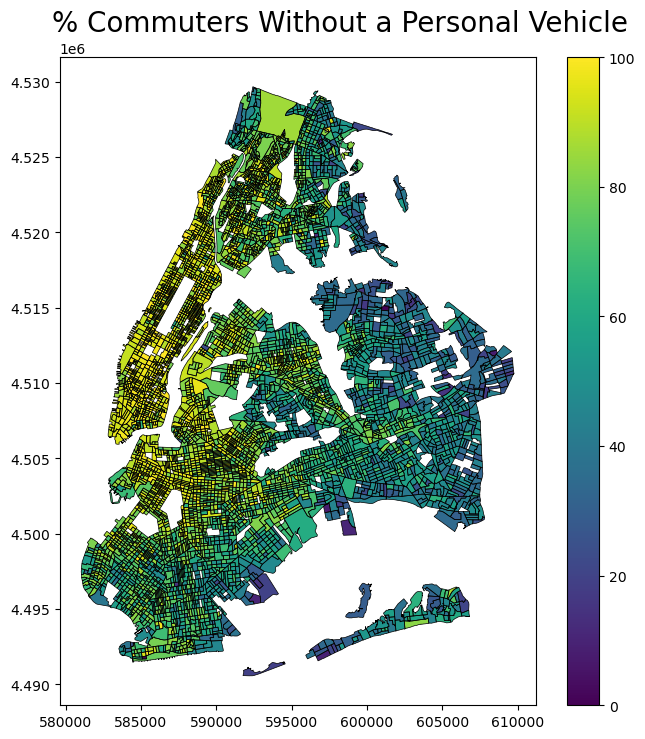

In [ ]:
plot_single_choropleth(nyc_gdf, 'inverse_vehicle_use', '% Commuters Without a Personal Vehicle')

'inverse_vehicle_use', # % Commuters Without a Personal Vehicle
'pop_density', # Population Density (Per sq. Meters)
'household_density', # Household Density (Per sq. Meters)
'PCT_SE_A10060_002', #: % Occupied Housing Units: Owner Occupied
'PCT_SE_A10060_003', #: % Occupied Housing Units: Renter Occupied
'SE_A14008_001', #: Average Household Income (In 2019 Inflation Adjusted Dollars)
'SE_A14024_001', #: Per Capita Income (In 2019 Inflation Adjusted Dollars)
'PCT_SE_A13002_002', #: % Families: Income Below Poverty Level
'SE_A10003_001', #: Average Household Size
'PCT_SE_A17002_004', #: % Population 16 Years and Over: in Labor Force: Civilian
###'PCT_SE_A17002_005', #: % Population 16 Years and Over: in Labor Force: Civilian: Employed
'PCT_SE_A17002_006', #: % Population 16 Years and Over: in Labor Force: Civilian: Unemployed

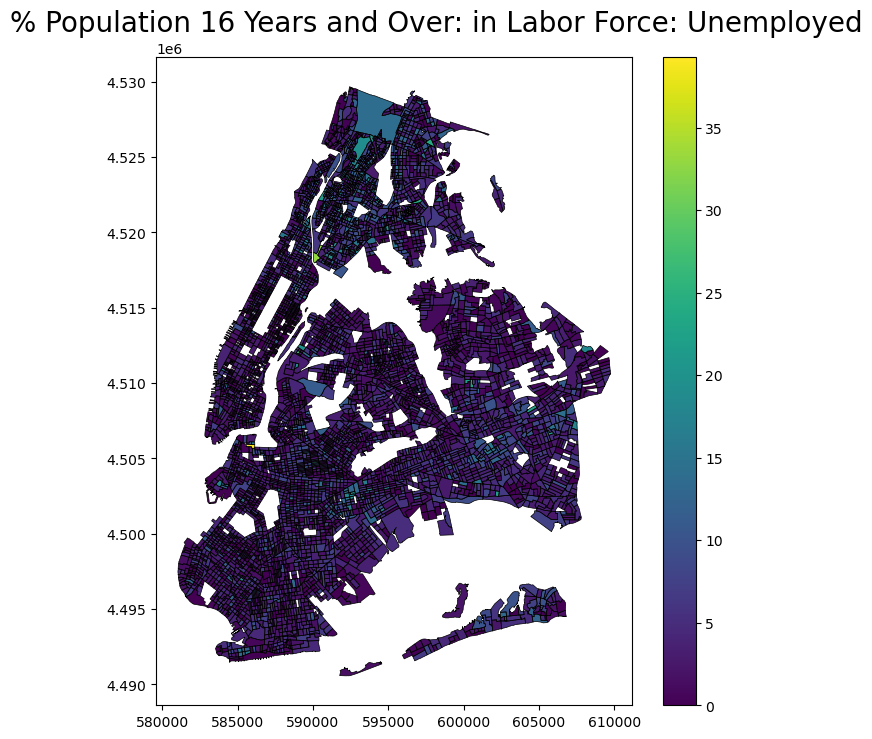

In [ ]:
plot_single_choropleth(nyc_gdf, 'PCT_SE_A17002_006', '% Population 16 Years and Over: in Labor Force: Unemployed')


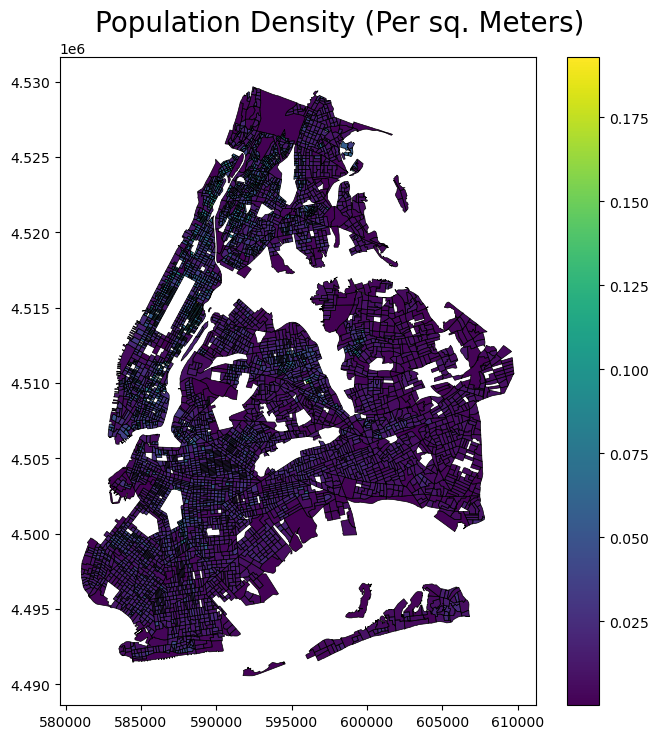

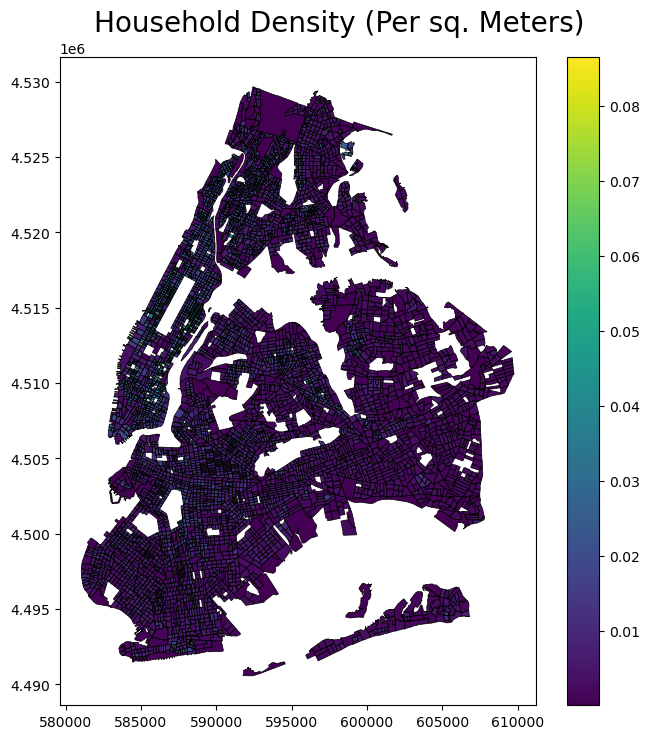

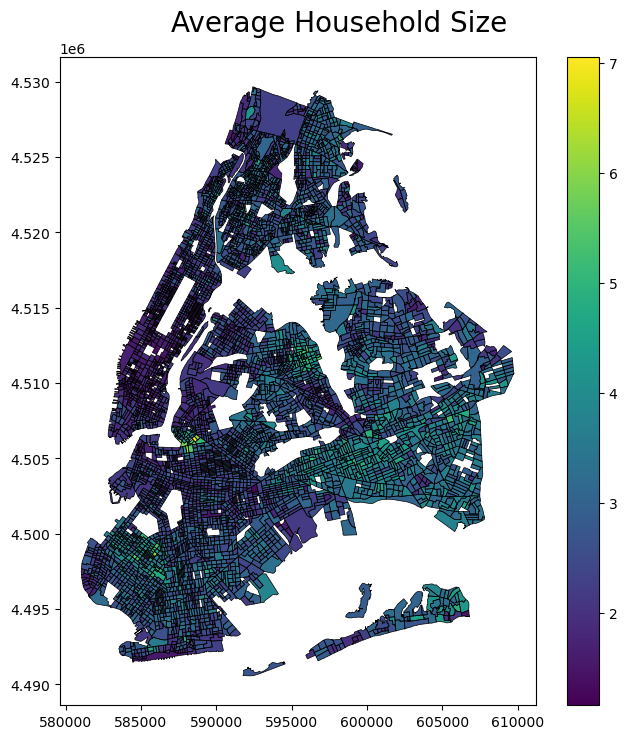

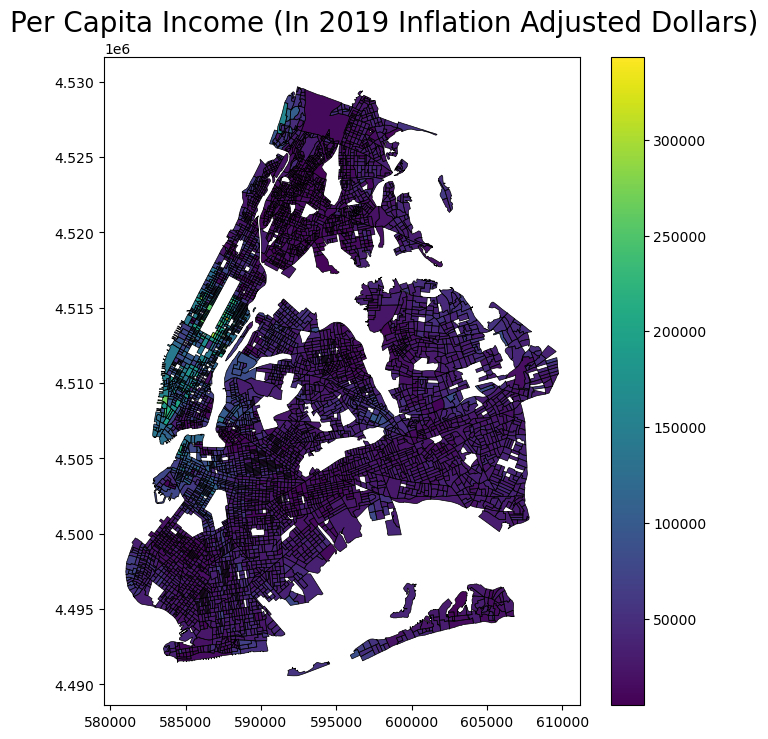

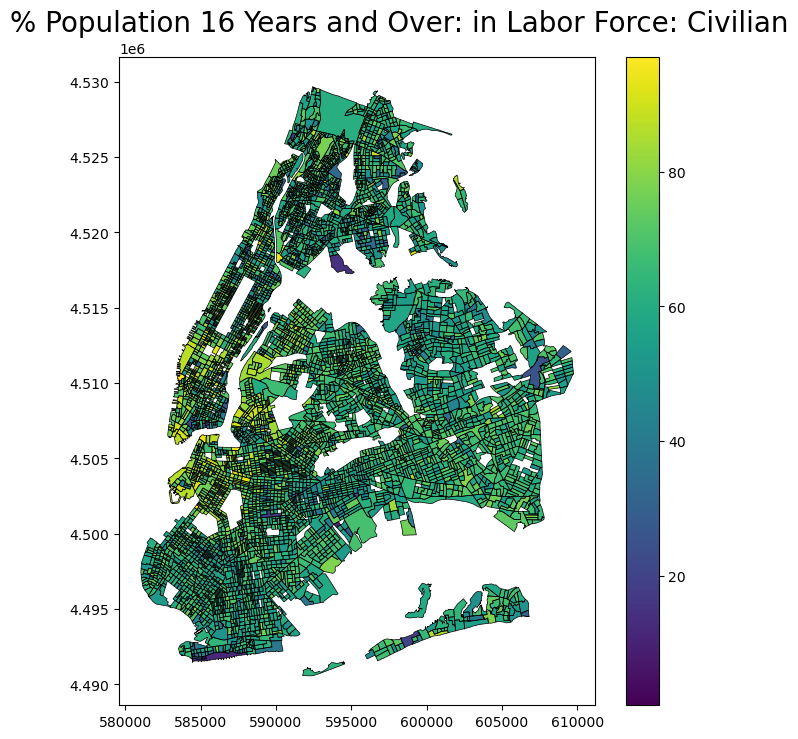

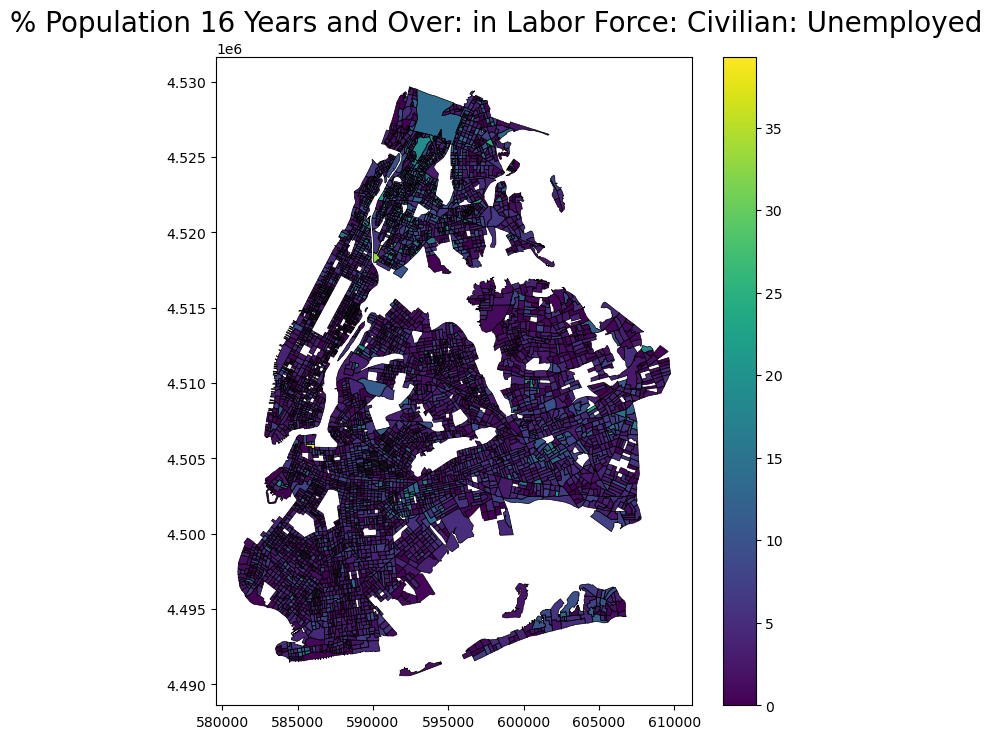

In [ ]:
plot_single_choropleth(nyc_gdf, 'pop_density', 'Population Density (Per sq. Meters)')
plot_single_choropleth(nyc_gdf, 'household_density', 'Household Density (Per sq. Meters)')
plot_single_choropleth(nyc_gdf, 'SE_A10003_001', 'Average Household Size')
plot_single_choropleth(nyc_gdf, 'SE_A14024_001', 'Per Capita Income (In 2019 Inflation Adjusted Dollars)')
plot_single_choropleth(nyc_gdf, 'PCT_SE_A17002_004', '% Population 16 Years and Over: in Labor Force: Civilian')
plot_single_choropleth(nyc_gdf, 'PCT_SE_A17002_006', '% Population 16 Years and Over: in Labor Force: Unemployed')

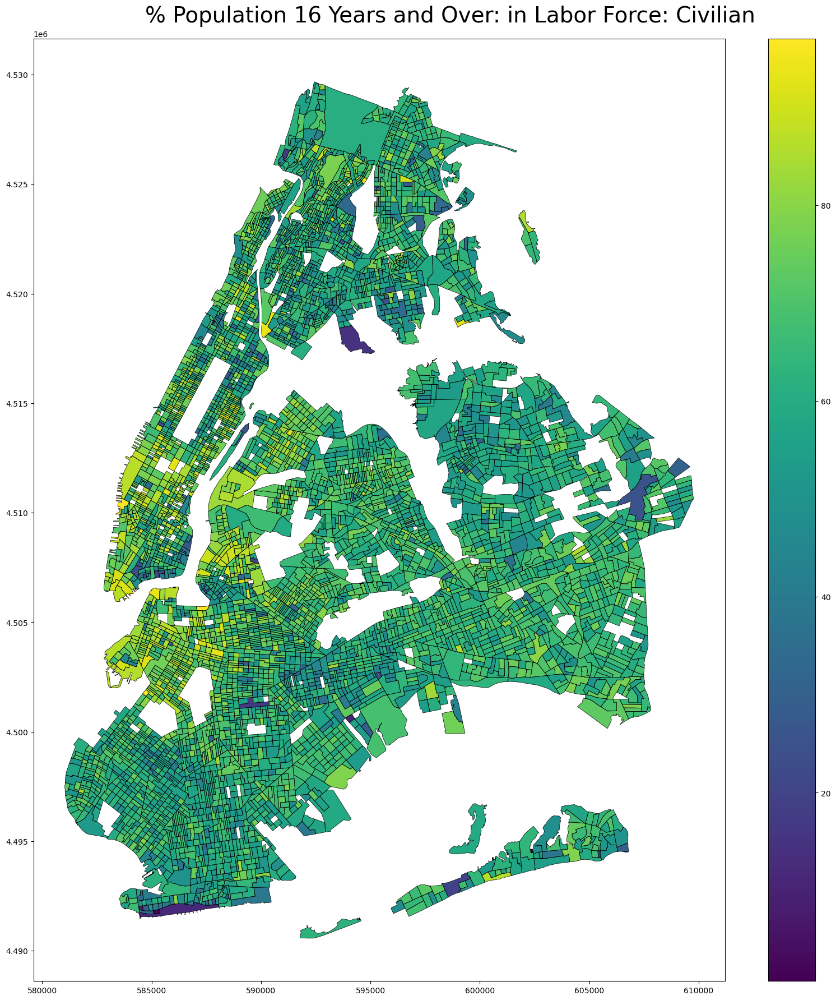

In [ ]:
plot_single_choropleth(nyc_gdf, 'PCT_SE_A17002_004', '% Population 16 Years and Over: in Labor Force: Civilian')

# Misc

### Filtered Dataset simplified including network results, random forest regression

Mean absolute error: 7.839508821579628
Mean squared error: 110.32127148546168
R-squared: 0.7082449466569498
(0.4688657820224762) clse_sum_radius_1600:  --- 
(0.1253388226032257) clse_mean_radius_800:  --- 
(0.05400200933218002) clse_sum_radius_3200:  --- 
(0.043302249163389206) household_density:  --- 
(0.03687971457839012) clse_sum_radius_800:  --- 
(0.03508104383945465) btwn_sum_radius_3200:  --- 
(0.028521303087472916) btwn_mean_radius_3200:  --- 
(0.021842356771230698) PCT_SE_A10060_003: % Occupied Housing Units: Renter Occupied
(0.020185919478535652) clse_mean_radius_1600:  --- 
(0.018112115561962128) clse_mean_radius_3200:  --- 
(0.01617756485939026) PCT_SE_A10060_002: % Occupied Housing Units: Owner Occupied
(0.014311580918729305) pop_density:  --- 
(0.012861756607890129) pgrk_mean_radius_400:  --- 
(0.01144617423415184) clse_sum_radius_400:  --- 
(0.008975132368505001) clse_mean_radius_400:  --- 
(0.007874797098338604) pgrk_sum_radius_3200:  --- 
(0.00786296371370554) SE_A14024

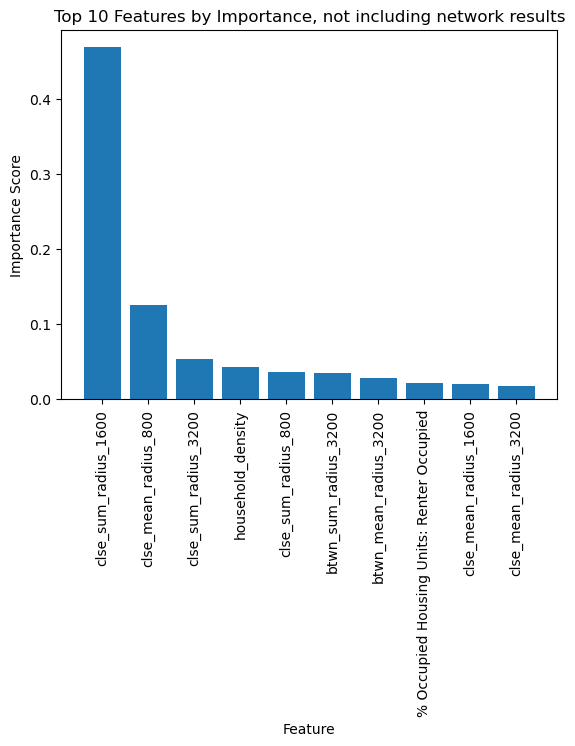

In [ ]:
df = nyc_gdf[['inverse_vehicle_use',
              'pop_density',
              'household_density',
              # 'PCT_SE_A09001_002', #: % Workers 16 Years and Over: Did Not Work At Home
              'PCT_SE_A10060_002', #: % Occupied Housing Units: Owner Occupied
              'PCT_SE_A10060_003', #: % Occupied Housing Units: Renter Occupied
              # 'PCT_SE_A10038_002', #: % Renter-Occupied Housing Units: Less than $300
              # 'PCT_SE_A10038_003', #: % Renter-Occupied Housing Units: $300 to $499
              # 'PCT_SE_A10038_004', #: % Renter-Occupied Housing Units: $500 to $799
              # 'PCT_SE_A10038_005', #: % Renter-Occupied Housing Units: $800 to $999
              # 'PCT_SE_A10038_006', #: % Renter-Occupied Housing Units: $1,000 to $1,499
              # 'PCT_SE_A10038_007', #: % Renter-Occupied Housing Units: $1,500 to $1,999
              # 'PCT_SE_A10038_008', #: % Renter-Occupied Housing Units: $2,000 to $2,499
              # 'PCT_SE_A10038_009', #: % Renter-Occupied Housing Units: $2,500 to $2,999
              # 'PCT_SE_A10038_010', #: % Renter-Occupied Housing Units: $3,000 or More
              # 'PCT_SE_A10038_011', #: % Renter-Occupied Housing Units: No Cash Rent
              # 'PCT_SE_A10054B_002', #: % Renter-Occupied Housing Units: No Vehicle Available
              # 'PCT_SE_A10054B_003', #: % Renter-Occupied Housing Units: 1 Vehicle Available
              # 'PCT_SE_A10054B_004', #: % Renter-Occupied Housing Units: 2 Vehicles Available
              # 'PCT_SE_A10054B_005', #: % Renter-Occupied Housing Units: 3 Vehicles Available
              # 'PCT_SE_A10054B_006', #: % Renter-Occupied Housing Units: 4 Vehicles Available
              # 'PCT_SE_A10054B_007', #: % Renter-Occupied Housing Units: 5 or More Vehicles Available
              # 'PCT_SE_A10030_002', #: % Occupied Housing Units: No Vehicle Available
              # 'PCT_SE_A10030_003', #: % Occupied Housing Units: 1 Vehicle Available
              # 'PCT_SE_A10030_004', #: % Occupied Housing Units: 2 Vehicles Available
              # 'PCT_SE_A10030_005', #: % Occupied Housing Units: 3 Vehicles Available
              # 'PCT_SE_A10030_006', #: % Occupied Housing Units: 4 Vehicles Available
              # 'PCT_SE_A10030_007', #: % Occupied Housing Units: 5 or More Vehicles Available
              # 'PCT_SE_A14001_002', #: % Households: Less than $10,000
              # 'PCT_SE_A14001_003', #: % Households: $10,000 to $14,999
              # 'PCT_SE_A14001_004', #: % Households: $15,000 to $19,999
              # 'PCT_SE_A14001_005', #: % Households: $20,000 to $24,999
              # 'PCT_SE_A14001_006', #: % Households: $25,000 to $29,999
              # 'PCT_SE_A14001_007', #: % Households: $30,000 to $34,999
              # 'PCT_SE_A14001_008', #: % Households: $35,000 to $39,999
              # 'PCT_SE_A14001_009', #: % Households: $40,000 to $44,999
              # 'PCT_SE_A14001_010', #: % Households: $45,000 to $49,999
              # 'PCT_SE_A14001_011', #: % Households: $50,000 to $59,999
              # 'PCT_SE_A14001_012', #: % Households: $60,000 to $74,999
              # 'PCT_SE_A14001_013', #: % Households: $75,000 to $99,999
              # 'PCT_SE_A14001_014', #: % Households: $100,000 to $124,999
              # 'PCT_SE_A14001_015', #: % Households: $125,000 to $149,999
              # 'PCT_SE_A14001_016', #: % Households: $150,000 to $199,999
              # 'PCT_SE_A14001_017', #: % Households: $200,000 or More
              'SE_A14008_001', #: Average Household Income (In 2019 Inflation Adjusted Dollars)
              'SE_A14024_001', #: Per Capita Income (In 2019 Inflation Adjusted Dollars)
              'PCT_SE_A13002_002', #: % Families: Income Below Poverty Level
            'clse_mean_radius_400',
            'clse_mean_radius_800',
            'clse_mean_radius_1600',
            'clse_mean_radius_3200',
            'btwn_mean_radius_400',
            'btwn_mean_radius_800',
            'btwn_mean_radius_1600',
            'btwn_mean_radius_3200',
            'pgrk_mean_radius_400',
            'pgrk_mean_radius_800',
            'pgrk_mean_radius_1600',
            'pgrk_mean_radius_3200',
            'clse_sum_radius_400',
            'clse_sum_radius_800',
            'clse_sum_radius_1600',
            'clse_sum_radius_3200',
            'btwn_sum_radius_400',
            'btwn_sum_radius_800',
            'btwn_sum_radius_1600',
            'btwn_sum_radius_3200',
            'pgrk_sum_radius_400',
            'pgrk_sum_radius_800',
            'pgrk_sum_radius_1600',
            'pgrk_sum_radius_3200',
            ]]

np.any(np.isnan(df))
np.all(np.isfinite(df))

df=df.dropna()
run_xgboost_no_cv(df)

### Running variations of constistant radiuses

Mean absolute error: 8.666895838067083
Mean squared error: 137.41387063151325
R-squared: 0.6365960016926071
(0.4169599413871765) household_density:  --- 
(0.22275729477405548) clse_mean_radius_400:  --- 
(0.12913700938224792) clse_sum_radius_400:  --- 
(0.05191194638609886) PCT_SE_A10060_003: % Occupied Housing Units: Renter Occupied
(0.050570931285619736) PCT_SE_A10060_002: % Occupied Housing Units: Owner Occupied
(0.030400151386857033) SE_A14024_001: Per Capita Income (In 2019 Inflation Adjusted Dollars)
(0.02682563103735447) pop_density:  --- 
(0.019380735233426094) SE_A14008_001: Average Household Income (In 2019 Inflation Adjusted Dollars)
(0.012242479249835014) PCT_SE_A13002_002: % Families: Income Below Poverty Level
(0.011863678693771362) pgrk_sum_radius_400:  --- 
(0.010785137303173542) btwn_sum_radius_400:  --- 
(0.010008951649069786) btwn_mean_radius_400:  --- 
(0.007156065199524164) pgrk_mean_radius_400:  --- 


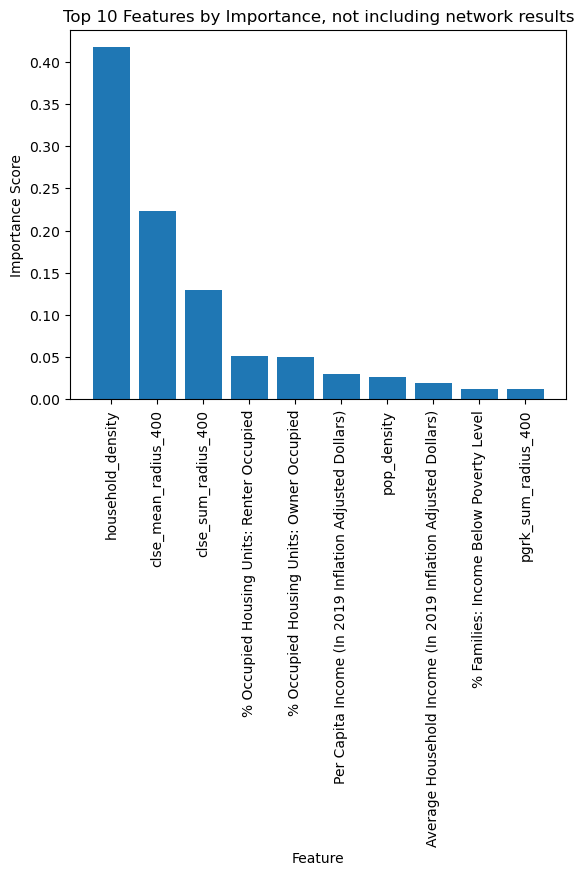

In [ ]:
df = nyc_gdf[['inverse_vehicle_use',
              'pop_density',
              'household_density',
              # 'PCT_SE_A09001_002', #: % Workers 16 Years and Over: Did Not Work At Home
              'PCT_SE_A10060_002', #: % Occupied Housing Units: Owner Occupied
              'PCT_SE_A10060_003', #: % Occupied Housing Units: Renter Occupied
              # 'PCT_SE_A10038_002', #: % Renter-Occupied Housing Units: Less than $300
              # 'PCT_SE_A10038_003', #: % Renter-Occupied Housing Units: $300 to $499
              # 'PCT_SE_A10038_004', #: % Renter-Occupied Housing Units: $500 to $799
              # 'PCT_SE_A10038_005', #: % Renter-Occupied Housing Units: $800 to $999
              # 'PCT_SE_A10038_006', #: % Renter-Occupied Housing Units: $1,000 to $1,499
              # 'PCT_SE_A10038_007', #: % Renter-Occupied Housing Units: $1,500 to $1,999
              # 'PCT_SE_A10038_008', #: % Renter-Occupied Housing Units: $2,000 to $2,499
              # 'PCT_SE_A10038_009', #: % Renter-Occupied Housing Units: $2,500 to $2,999
              # 'PCT_SE_A10038_010', #: % Renter-Occupied Housing Units: $3,000 or More
              # 'PCT_SE_A10038_011', #: % Renter-Occupied Housing Units: No Cash Rent
              # 'PCT_SE_A10054B_002', #: % Renter-Occupied Housing Units: No Vehicle Available
              # 'PCT_SE_A10054B_003', #: % Renter-Occupied Housing Units: 1 Vehicle Available
              # 'PCT_SE_A10054B_004', #: % Renter-Occupied Housing Units: 2 Vehicles Available
              # 'PCT_SE_A10054B_005', #: % Renter-Occupied Housing Units: 3 Vehicles Available
              # 'PCT_SE_A10054B_006', #: % Renter-Occupied Housing Units: 4 Vehicles Available
              # 'PCT_SE_A10054B_007', #: % Renter-Occupied Housing Units: 5 or More Vehicles Available
              # 'PCT_SE_A10030_002', #: % Occupied Housing Units: No Vehicle Available
              # 'PCT_SE_A10030_003', #: % Occupied Housing Units: 1 Vehicle Available
              # 'PCT_SE_A10030_004', #: % Occupied Housing Units: 2 Vehicles Available
              # 'PCT_SE_A10030_005', #: % Occupied Housing Units: 3 Vehicles Available
              # 'PCT_SE_A10030_006', #: % Occupied Housing Units: 4 Vehicles Available
              # 'PCT_SE_A10030_007', #: % Occupied Housing Units: 5 or More Vehicles Available
              # 'PCT_SE_A14001_002', #: % Households: Less than $10,000
              # 'PCT_SE_A14001_003', #: % Households: $10,000 to $14,999
              # 'PCT_SE_A14001_004', #: % Households: $15,000 to $19,999
              # 'PCT_SE_A14001_005', #: % Households: $20,000 to $24,999
              # 'PCT_SE_A14001_006', #: % Households: $25,000 to $29,999
              # 'PCT_SE_A14001_007', #: % Households: $30,000 to $34,999
              # 'PCT_SE_A14001_008', #: % Households: $35,000 to $39,999
              # 'PCT_SE_A14001_009', #: % Households: $40,000 to $44,999
              # 'PCT_SE_A14001_010', #: % Households: $45,000 to $49,999
              # 'PCT_SE_A14001_011', #: % Households: $50,000 to $59,999
              # 'PCT_SE_A14001_012', #: % Households: $60,000 to $74,999
              # 'PCT_SE_A14001_013', #: % Households: $75,000 to $99,999
              # 'PCT_SE_A14001_014', #: % Households: $100,000 to $124,999
              # 'PCT_SE_A14001_015', #: % Households: $125,000 to $149,999
              # 'PCT_SE_A14001_016', #: % Households: $150,000 to $199,999
              # 'PCT_SE_A14001_017', #: % Households: $200,000 or More
              'SE_A14008_001', #: Average Household Income (In 2019 Inflation Adjusted Dollars)
              'SE_A14024_001', #: Per Capita Income (In 2019 Inflation Adjusted Dollars)
              'PCT_SE_A13002_002', #: % Families: Income Below Poverty Level
            'clse_mean_radius_400',
            # 'clse_mean_radius_800',
            # 'clse_mean_radius_1600',
            # 'clse_mean_radius_3200',
            'btwn_mean_radius_400',
            # 'btwn_mean_radius_800',
            # 'btwn_mean_radius_1600',
            # 'btwn_mean_radius_3200',
            'pgrk_mean_radius_400',
            # 'pgrk_mean_radius_800',
            # 'pgrk_mean_radius_1600',
            # 'pgrk_mean_radius_3200',
            'clse_sum_radius_400',
            # 'clse_sum_radius_800',
            # 'clse_sum_radius_1600',
            # 'clse_sum_radius_3200',
            'btwn_sum_radius_400',
            # 'btwn_sum_radius_800',
            # 'btwn_sum_radius_1600',
            # 'btwn_sum_radius_3200',
            'pgrk_sum_radius_400',
            # 'pgrk_sum_radius_800',
            # 'pgrk_sum_radius_1600',
            # 'pgrk_sum_radius_3200',
            ]]

np.any(np.isnan(df))
np.all(np.isfinite(df))

df=df.dropna()

run_xgboost_no_cv(df)

Mean absolute error: 8.25516643659695
Mean squared error: 121.8031216142494
R-squared: 0.6778801062984626
(0.4179915487766266) clse_mean_radius_800:  --- 
(0.2677011787891388) clse_sum_radius_800:  --- 
(0.08814914524555206) household_density:  --- 
(0.04514315724372864) pop_density:  --- 
(0.04294852167367935) PCT_SE_A10060_002: % Occupied Housing Units: Owner Occupied
(0.037833165377378464) PCT_SE_A10060_003: % Occupied Housing Units: Renter Occupied
(0.020694447681307793) SE_A14024_001: Per Capita Income (In 2019 Inflation Adjusted Dollars)
(0.018980722874403) SE_A14008_001: Average Household Income (In 2019 Inflation Adjusted Dollars)
(0.015253030695021152) pgrk_sum_radius_800:  --- 
(0.012279180809855461) PCT_SE_A13002_002: % Families: Income Below Poverty Level
(0.011896710842847824) btwn_sum_radius_800:  --- 
(0.010720523074269295) btwn_mean_radius_800:  --- 
(0.010408706963062286) pgrk_mean_radius_800:  --- 


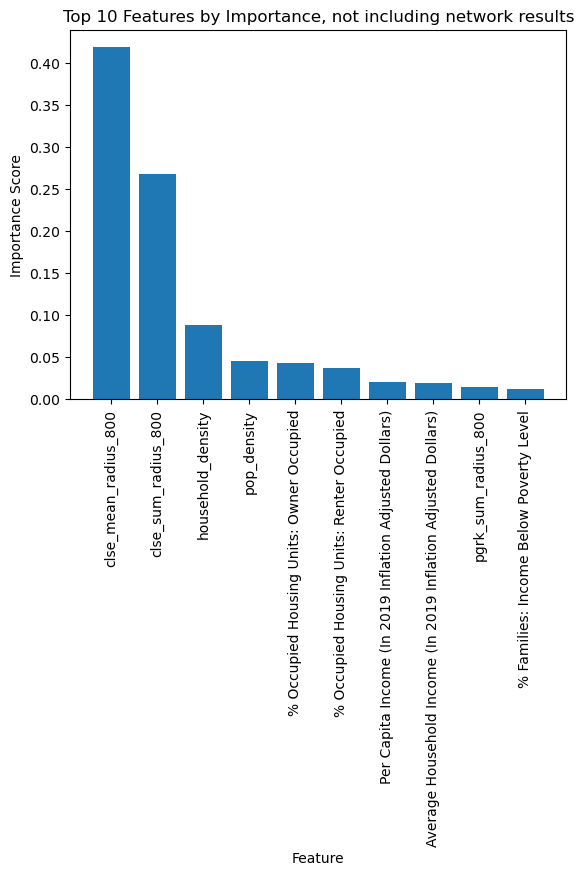

In [ ]:
df = nyc_gdf[['inverse_vehicle_use',
              'pop_density',
              'household_density',
              # 'PCT_SE_A09001_002', #: % Workers 16 Years and Over: Did Not Work At Home
              'PCT_SE_A10060_002', #: % Occupied Housing Units: Owner Occupied
              'PCT_SE_A10060_003', #: % Occupied Housing Units: Renter Occupied
              # 'PCT_SE_A10038_002', #: % Renter-Occupied Housing Units: Less than $300
              # 'PCT_SE_A10038_003', #: % Renter-Occupied Housing Units: $300 to $499
              # 'PCT_SE_A10038_004', #: % Renter-Occupied Housing Units: $500 to $799
              # 'PCT_SE_A10038_005', #: % Renter-Occupied Housing Units: $800 to $999
              # 'PCT_SE_A10038_006', #: % Renter-Occupied Housing Units: $1,000 to $1,499
              # 'PCT_SE_A10038_007', #: % Renter-Occupied Housing Units: $1,500 to $1,999
              # 'PCT_SE_A10038_008', #: % Renter-Occupied Housing Units: $2,000 to $2,499
              # 'PCT_SE_A10038_009', #: % Renter-Occupied Housing Units: $2,500 to $2,999
              # 'PCT_SE_A10038_010', #: % Renter-Occupied Housing Units: $3,000 or More
              # 'PCT_SE_A10038_011', #: % Renter-Occupied Housing Units: No Cash Rent
              # 'PCT_SE_A10054B_002', #: % Renter-Occupied Housing Units: No Vehicle Available
              # 'PCT_SE_A10054B_003', #: % Renter-Occupied Housing Units: 1 Vehicle Available
              # 'PCT_SE_A10054B_004', #: % Renter-Occupied Housing Units: 2 Vehicles Available
              # 'PCT_SE_A10054B_005', #: % Renter-Occupied Housing Units: 3 Vehicles Available
              # 'PCT_SE_A10054B_006', #: % Renter-Occupied Housing Units: 4 Vehicles Available
              # 'PCT_SE_A10054B_007', #: % Renter-Occupied Housing Units: 5 or More Vehicles Available
              # 'PCT_SE_A10030_002', #: % Occupied Housing Units: No Vehicle Available
              # 'PCT_SE_A10030_003', #: % Occupied Housing Units: 1 Vehicle Available
              # 'PCT_SE_A10030_004', #: % Occupied Housing Units: 2 Vehicles Available
              # 'PCT_SE_A10030_005', #: % Occupied Housing Units: 3 Vehicles Available
              # 'PCT_SE_A10030_006', #: % Occupied Housing Units: 4 Vehicles Available
              # 'PCT_SE_A10030_007', #: % Occupied Housing Units: 5 or More Vehicles Available
              # 'PCT_SE_A14001_002', #: % Households: Less than $10,000
              # 'PCT_SE_A14001_003', #: % Households: $10,000 to $14,999
              # 'PCT_SE_A14001_004', #: % Households: $15,000 to $19,999
              # 'PCT_SE_A14001_005', #: % Households: $20,000 to $24,999
              # 'PCT_SE_A14001_006', #: % Households: $25,000 to $29,999
              # 'PCT_SE_A14001_007', #: % Households: $30,000 to $34,999
              # 'PCT_SE_A14001_008', #: % Households: $35,000 to $39,999
              # 'PCT_SE_A14001_009', #: % Households: $40,000 to $44,999
              # 'PCT_SE_A14001_010', #: % Households: $45,000 to $49,999
              # 'PCT_SE_A14001_011', #: % Households: $50,000 to $59,999
              # 'PCT_SE_A14001_012', #: % Households: $60,000 to $74,999
              # 'PCT_SE_A14001_013', #: % Households: $75,000 to $99,999
              # 'PCT_SE_A14001_014', #: % Households: $100,000 to $124,999
              # 'PCT_SE_A14001_015', #: % Households: $125,000 to $149,999
              # 'PCT_SE_A14001_016', #: % Households: $150,000 to $199,999
              # 'PCT_SE_A14001_017', #: % Households: $200,000 or More
              'SE_A14008_001', #: Average Household Income (In 2019 Inflation Adjusted Dollars)
              'SE_A14024_001', #: Per Capita Income (In 2019 Inflation Adjusted Dollars)
              'PCT_SE_A13002_002', #: % Families: Income Below Poverty Level
            # 'clse_mean_radius_400',
            'clse_mean_radius_800',
            # 'clse_mean_radius_1600',
            # 'clse_mean_radius_3200',
            # 'btwn_mean_radius_400',
            'btwn_mean_radius_800',
            # 'btwn_mean_radius_1600',
            # 'btwn_mean_radius_3200',
            # 'pgrk_mean_radius_400',
            'pgrk_mean_radius_800',
            # 'pgrk_mean_radius_1600',
            # 'pgrk_mean_radius_3200',
            # 'clse_sum_radius_400',
            'clse_sum_radius_800',
            # 'clse_sum_radius_1600',
            # 'clse_sum_radius_3200',
            # 'btwn_sum_radius_400',
            'btwn_sum_radius_800',
            # 'btwn_sum_radius_1600',
            # 'btwn_sum_radius_3200',
            # 'pgrk_sum_radius_400',
            'pgrk_sum_radius_800',
            # 'pgrk_sum_radius_1600',
            # 'pgrk_sum_radius_3200',
            ]]

np.any(np.isnan(df))
np.all(np.isfinite(df))

df=df.dropna()

run_xgboost_no_cv(df)

Mean absolute error: 8.165454980564729
Mean squared error: 117.63288250188333
R-squared: 0.6889086986841294
(0.4861818552017212) clse_sum_radius_1600:  --- 
(0.15360622107982635) btwn_sum_radius_1600:  --- 
(0.10070784389972687) household_density:  --- 
(0.08380601555109024) clse_mean_radius_1600:  --- 
(0.03806774690747261) PCT_SE_A10060_002: % Occupied Housing Units: Owner Occupied
(0.03411998972296715) PCT_SE_A10060_003: % Occupied Housing Units: Renter Occupied
(0.02276577241718769) pop_density:  --- 
(0.020279815420508385) SE_A14024_001: Per Capita Income (In 2019 Inflation Adjusted Dollars)
(0.014525109902024269) SE_A14008_001: Average Household Income (In 2019 Inflation Adjusted Dollars)
(0.0138758085668087) btwn_mean_radius_1600:  --- 
(0.01115963701158762) pgrk_sum_radius_1600:  --- 
(0.010838747024536133) pgrk_mean_radius_1600:  --- 
(0.010065407492220402) PCT_SE_A13002_002: % Families: Income Below Poverty Level


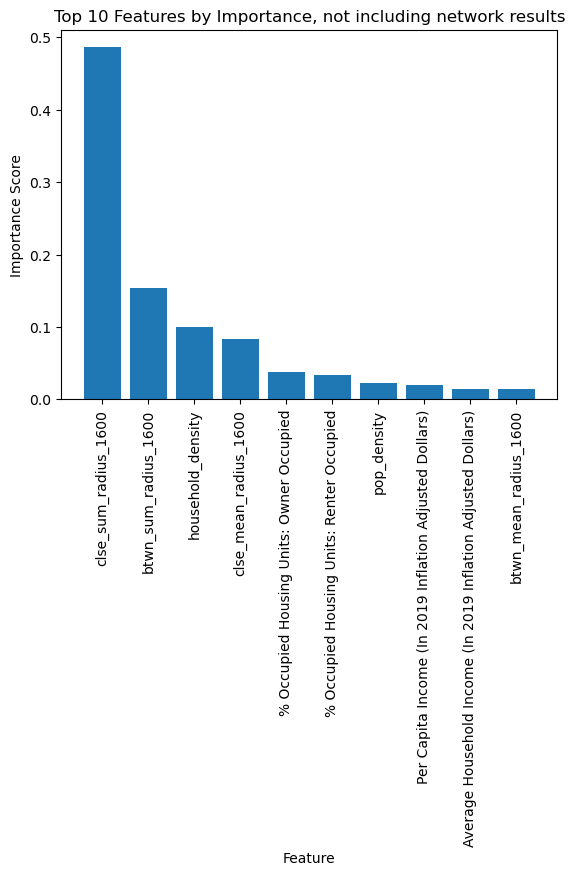

In [ ]:
df = nyc_gdf[['inverse_vehicle_use',
              'pop_density',
              'household_density',
              # 'PCT_SE_A09001_002', #: % Workers 16 Years and Over: Did Not Work At Home
              'PCT_SE_A10060_002', #: % Occupied Housing Units: Owner Occupied
              'PCT_SE_A10060_003', #: % Occupied Housing Units: Renter Occupied
              # 'PCT_SE_A10038_002', #: % Renter-Occupied Housing Units: Less than $300
              # 'PCT_SE_A10038_003', #: % Renter-Occupied Housing Units: $300 to $499
              # 'PCT_SE_A10038_004', #: % Renter-Occupied Housing Units: $500 to $799
              # 'PCT_SE_A10038_005', #: % Renter-Occupied Housing Units: $800 to $999
              # 'PCT_SE_A10038_006', #: % Renter-Occupied Housing Units: $1,000 to $1,499
              # 'PCT_SE_A10038_007', #: % Renter-Occupied Housing Units: $1,500 to $1,999
              # 'PCT_SE_A10038_008', #: % Renter-Occupied Housing Units: $2,000 to $2,499
              # 'PCT_SE_A10038_009', #: % Renter-Occupied Housing Units: $2,500 to $2,999
              # 'PCT_SE_A10038_010', #: % Renter-Occupied Housing Units: $3,000 or More
              # 'PCT_SE_A10038_011', #: % Renter-Occupied Housing Units: No Cash Rent
              # 'PCT_SE_A10054B_002', #: % Renter-Occupied Housing Units: No Vehicle Available
              # 'PCT_SE_A10054B_003', #: % Renter-Occupied Housing Units: 1 Vehicle Available
              # 'PCT_SE_A10054B_004', #: % Renter-Occupied Housing Units: 2 Vehicles Available
              # 'PCT_SE_A10054B_005', #: % Renter-Occupied Housing Units: 3 Vehicles Available
              # 'PCT_SE_A10054B_006', #: % Renter-Occupied Housing Units: 4 Vehicles Available
              # 'PCT_SE_A10054B_007', #: % Renter-Occupied Housing Units: 5 or More Vehicles Available
              # 'PCT_SE_A10030_002', #: % Occupied Housing Units: No Vehicle Available
              # 'PCT_SE_A10030_003', #: % Occupied Housing Units: 1 Vehicle Available
              # 'PCT_SE_A10030_004', #: % Occupied Housing Units: 2 Vehicles Available
              # 'PCT_SE_A10030_005', #: % Occupied Housing Units: 3 Vehicles Available
              # 'PCT_SE_A10030_006', #: % Occupied Housing Units: 4 Vehicles Available
              # 'PCT_SE_A10030_007', #: % Occupied Housing Units: 5 or More Vehicles Available
              # 'PCT_SE_A14001_002', #: % Households: Less than $10,000
              # 'PCT_SE_A14001_003', #: % Households: $10,000 to $14,999
              # 'PCT_SE_A14001_004', #: % Households: $15,000 to $19,999
              # 'PCT_SE_A14001_005', #: % Households: $20,000 to $24,999
              # 'PCT_SE_A14001_006', #: % Households: $25,000 to $29,999
              # 'PCT_SE_A14001_007', #: % Households: $30,000 to $34,999
              # 'PCT_SE_A14001_008', #: % Households: $35,000 to $39,999
              # 'PCT_SE_A14001_009', #: % Households: $40,000 to $44,999
              # 'PCT_SE_A14001_010', #: % Households: $45,000 to $49,999
              # 'PCT_SE_A14001_011', #: % Households: $50,000 to $59,999
              # 'PCT_SE_A14001_012', #: % Households: $60,000 to $74,999
              # 'PCT_SE_A14001_013', #: % Households: $75,000 to $99,999
              # 'PCT_SE_A14001_014', #: % Households: $100,000 to $124,999
              # 'PCT_SE_A14001_015', #: % Households: $125,000 to $149,999
              # 'PCT_SE_A14001_016', #: % Households: $150,000 to $199,999
              # 'PCT_SE_A14001_017', #: % Households: $200,000 or More
              'SE_A14008_001', #: Average Household Income (In 2019 Inflation Adjusted Dollars)
              'SE_A14024_001', #: Per Capita Income (In 2019 Inflation Adjusted Dollars)
              'PCT_SE_A13002_002', #: % Families: Income Below Poverty Level
            # 'clse_mean_radius_400',
            # 'clse_mean_radius_800',
            'clse_mean_radius_1600',
            # 'clse_mean_radius_3200',
            # 'btwn_mean_radius_400',
            # 'btwn_mean_radius_800',
            'btwn_mean_radius_1600',
            # 'btwn_mean_radius_3200',
            # 'pgrk_mean_radius_400',
            # 'pgrk_mean_radius_800',
            'pgrk_mean_radius_1600',
            # 'pgrk_mean_radius_3200',
            # 'clse_sum_radius_400',
            # 'clse_sum_radius_800',
            'clse_sum_radius_1600',
            # 'clse_sum_radius_3200',
            # 'btwn_sum_radius_400',
            # 'btwn_sum_radius_800',
            'btwn_sum_radius_1600',
            # 'btwn_sum_radius_3200',
            # 'pgrk_sum_radius_400',
            # 'pgrk_sum_radius_800',
            'pgrk_sum_radius_1600',
            # 'pgrk_sum_radius_3200',
            ]]

np.any(np.isnan(df))
np.all(np.isfinite(df))

df=df.dropna()

run_xgboost_no_cv(df)

In [ ]:
df = nyc_gdf[['inverse_vehicle_use',
              'pop_density',
              'household_density',
              # 'PCT_SE_A09001_002', #: % Workers 16 Years and Over: Did Not Work At Home
              'PCT_SE_A10060_002', #: % Occupied Housing Units: Owner Occupied
              'PCT_SE_A10060_003', #: % Occupied Housing Units: Renter Occupied
              # 'PCT_SE_A10038_002', #: % Renter-Occupied Housing Units: Less than $300
              # 'PCT_SE_A10038_003', #: % Renter-Occupied Housing Units: $300 to $499
              # 'PCT_SE_A10038_004', #: % Renter-Occupied Housing Units: $500 to $799
              # 'PCT_SE_A10038_005', #: % Renter-Occupied Housing Units: $800 to $999
              # 'PCT_SE_A10038_006', #: % Renter-Occupied Housing Units: $1,000 to $1,499
              # 'PCT_SE_A10038_007', #: % Renter-Occupied Housing Units: $1,500 to $1,999
              # 'PCT_SE_A10038_008', #: % Renter-Occupied Housing Units: $2,000 to $2,499
              # 'PCT_SE_A10038_009', #: % Renter-Occupied Housing Units: $2,500 to $2,999
              # 'PCT_SE_A10038_010', #: % Renter-Occupied Housing Units: $3,000 or More
              # 'PCT_SE_A10038_011', #: % Renter-Occupied Housing Units: No Cash Rent
              # 'PCT_SE_A10054B_002', #: % Renter-Occupied Housing Units: No Vehicle Available
              # 'PCT_SE_A10054B_003', #: % Renter-Occupied Housing Units: 1 Vehicle Available
              # 'PCT_SE_A10054B_004', #: % Renter-Occupied Housing Units: 2 Vehicles Available
              # 'PCT_SE_A10054B_005', #: % Renter-Occupied Housing Units: 3 Vehicles Available
              # 'PCT_SE_A10054B_006', #: % Renter-Occupied Housing Units: 4 Vehicles Available
              # 'PCT_SE_A10054B_007', #: % Renter-Occupied Housing Units: 5 or More Vehicles Available
              # 'PCT_SE_A10030_002', #: % Occupied Housing Units: No Vehicle Available
              # 'PCT_SE_A10030_003', #: % Occupied Housing Units: 1 Vehicle Available
              # 'PCT_SE_A10030_004', #: % Occupied Housing Units: 2 Vehicles Available
              # 'PCT_SE_A10030_005', #: % Occupied Housing Units: 3 Vehicles Available
              # 'PCT_SE_A10030_006', #: % Occupied Housing Units: 4 Vehicles Available
              # 'PCT_SE_A10030_007', #: % Occupied Housing Units: 5 or More Vehicles Available
              # 'PCT_SE_A14001_002', #: % Households: Less than $10,000
              # 'PCT_SE_A14001_003', #: % Households: $10,000 to $14,999
              # 'PCT_SE_A14001_004', #: % Households: $15,000 to $19,999
              # 'PCT_SE_A14001_005', #: % Households: $20,000 to $24,999
              # 'PCT_SE_A14001_006', #: % Households: $25,000 to $29,999
              # 'PCT_SE_A14001_007', #: % Households: $30,000 to $34,999
              # 'PCT_SE_A14001_008', #: % Households: $35,000 to $39,999
              # 'PCT_SE_A14001_009', #: % Households: $40,000 to $44,999
              # 'PCT_SE_A14001_010', #: % Households: $45,000 to $49,999
              # 'PCT_SE_A14001_011', #: % Households: $50,000 to $59,999
              # 'PCT_SE_A14001_012', #: % Households: $60,000 to $74,999
              # 'PCT_SE_A14001_013', #: % Households: $75,000 to $99,999
              # 'PCT_SE_A14001_014', #: % Households: $100,000 to $124,999
              # 'PCT_SE_A14001_015', #: % Households: $125,000 to $149,999
              # 'PCT_SE_A14001_016', #: % Households: $150,000 to $199,999
              # 'PCT_SE_A14001_017', #: % Households: $200,000 or More
              'SE_A14008_001', #: Average Household Income (In 2019 Inflation Adjusted Dollars)
              'SE_A14024_001', #: Per Capita Income (In 2019 Inflation Adjusted Dollars)
              'PCT_SE_A13002_002', #: % Families: Income Below Poverty Level
            # 'clse_mean_radius_400',
            # 'clse_mean_radius_800',
            # 'clse_mean_radius_1600',
            'clse_mean_radius_3200',
            # 'btwn_mean_radius_400',
            # 'btwn_mean_radius_800',
            # 'btwn_mean_radius_1600',
            'btwn_mean_radius_3200',
            # 'pgrk_mean_radius_400',
            # 'pgrk_mean_radius_800',
            # 'pgrk_mean_radius_1600',
            'pgrk_mean_radius_3200',
            # 'clse_sum_radius_400',
            # 'clse_sum_radius_800',
            # 'clse_sum_radius_1600',
            'clse_sum_radius_3200',
            # 'btwn_sum_radius_400',
            # 'btwn_sum_radius_800',
            # 'btwn_sum_radius_1600',
            'btwn_sum_radius_3200',
            # 'pgrk_sum_radius_400',
            # 'pgrk_sum_radius_800',
            # 'pgrk_sum_radius_1600',
            'pgrk_sum_radius_3200',
            ]]

np.any(np.isnan(df))
np.all(np.isfinite(df))

df=df.dropna()

Mean absolute error: 8.081788241209232
Mean squared error: 115.10861101633373
R-squared: 0.6955843737556945
(0.4755111336708069) clse_sum_radius_3200:  --- 
(0.12288597226142883) btwn_sum_radius_3200:  --- 
(0.09725982695817947) pgrk_sum_radius_3200:  --- 
(0.0908985286951065) household_density:  --- 
(0.03760174661874771) pop_density:  --- 
(0.0375514030456543) PCT_SE_A10060_003: % Occupied Housing Units: Renter Occupied
(0.03652989864349365) PCT_SE_A10060_002: % Occupied Housing Units: Owner Occupied
(0.03470173850655556) clse_mean_radius_3200:  --- 
(0.022815166041254997) btwn_mean_radius_3200:  --- 
(0.014096072874963284) SE_A14024_001: Per Capita Income (In 2019 Inflation Adjusted Dollars)
(0.011639545671641827) SE_A14008_001: Average Household Income (In 2019 Inflation Adjusted Dollars)
(0.009778640232980251) pgrk_mean_radius_3200:  --- 
(0.00873035378754139) PCT_SE_A13002_002: % Families: Income Below Poverty Level


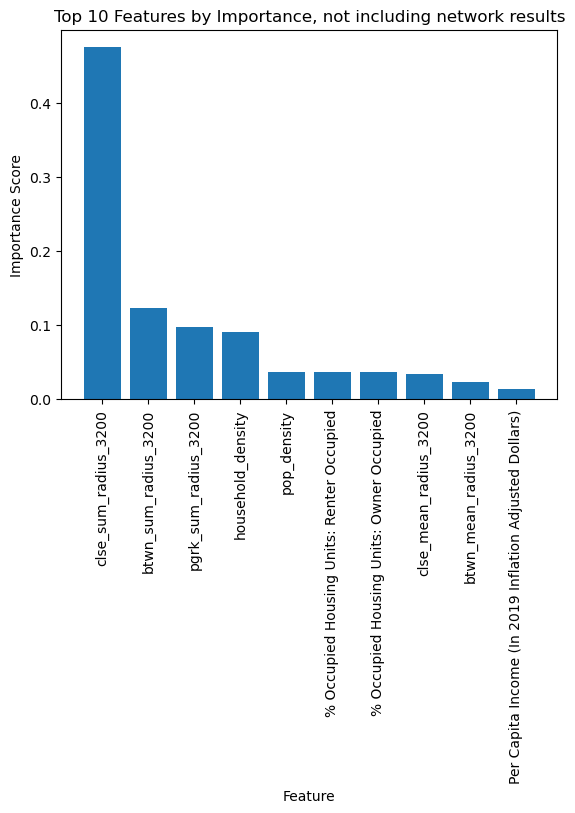

In [ ]:
run_xgboost_no_cv(df)


Mean absolute error: 8.303064290725983
Mean squared error: 121.4673830718467
R-squared: 0.678767998678863
(0.46027857065200806) clse_sum_radius_3200:  --- 
(0.24857625365257263) household_density:  --- 
(0.08194518089294434) PCT_SE_A10060_003: % Occupied Housing Units: Renter Occupied
(0.08052241057157516) PCT_SE_A10060_002: % Occupied Housing Units: Owner Occupied
(0.0437997505068779) SE_A14024_001: Per Capita Income (In 2019 Inflation Adjusted Dollars)
(0.040245428681373596) pop_density:  --- 
(0.023620519787073135) SE_A14008_001: Average Household Income (In 2019 Inflation Adjusted Dollars)
(0.02101188711822033) PCT_SE_A13002_002: % Families: Income Below Poverty Level


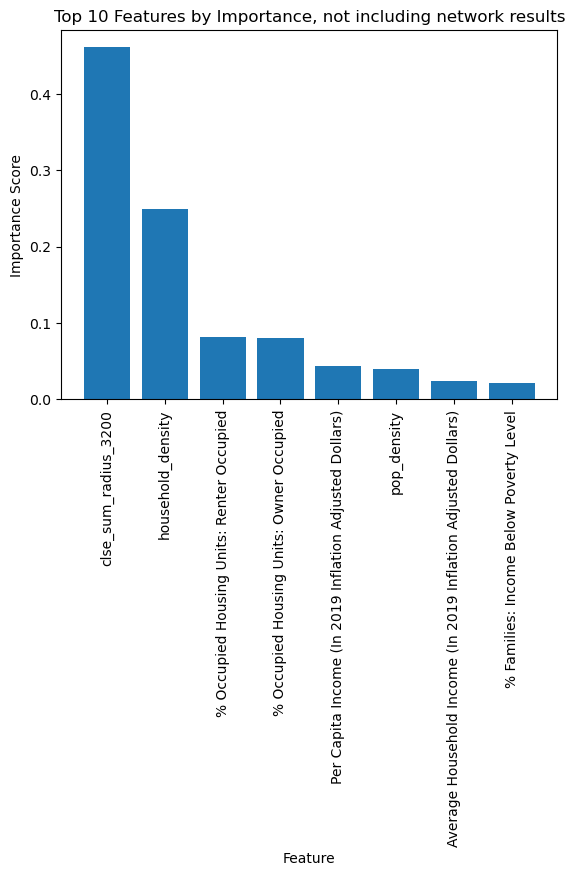

In [ ]:
df = nyc_gdf[['inverse_vehicle_use',
              'pop_density',
              'household_density',
              # 'PCT_SE_A09001_002', #: % Workers 16 Years and Over: Did Not Work At Home
              'PCT_SE_A10060_002', #: % Occupied Housing Units: Owner Occupied
              'PCT_SE_A10060_003', #: % Occupied Housing Units: Renter Occupied
              # 'PCT_SE_A10038_002', #: % Renter-Occupied Housing Units: Less than $300
              # 'PCT_SE_A10038_003', #: % Renter-Occupied Housing Units: $300 to $499
              # 'PCT_SE_A10038_004', #: % Renter-Occupied Housing Units: $500 to $799
              # 'PCT_SE_A10038_005', #: % Renter-Occupied Housing Units: $800 to $999
              # 'PCT_SE_A10038_006', #: % Renter-Occupied Housing Units: $1,000 to $1,499
              # 'PCT_SE_A10038_007', #: % Renter-Occupied Housing Units: $1,500 to $1,999
              # 'PCT_SE_A10038_008', #: % Renter-Occupied Housing Units: $2,000 to $2,499
              # 'PCT_SE_A10038_009', #: % Renter-Occupied Housing Units: $2,500 to $2,999
              # 'PCT_SE_A10038_010', #: % Renter-Occupied Housing Units: $3,000 or More
              # 'PCT_SE_A10038_011', #: % Renter-Occupied Housing Units: No Cash Rent
              # 'PCT_SE_A10054B_002', #: % Renter-Occupied Housing Units: No Vehicle Available
              # 'PCT_SE_A10054B_003', #: % Renter-Occupied Housing Units: 1 Vehicle Available
              # 'PCT_SE_A10054B_004', #: % Renter-Occupied Housing Units: 2 Vehicles Available
              # 'PCT_SE_A10054B_005', #: % Renter-Occupied Housing Units: 3 Vehicles Available
              # 'PCT_SE_A10054B_006', #: % Renter-Occupied Housing Units: 4 Vehicles Available
              # 'PCT_SE_A10054B_007', #: % Renter-Occupied Housing Units: 5 or More Vehicles Available
              # 'PCT_SE_A10030_002', #: % Occupied Housing Units: No Vehicle Available
              # 'PCT_SE_A10030_003', #: % Occupied Housing Units: 1 Vehicle Available
              # 'PCT_SE_A10030_004', #: % Occupied Housing Units: 2 Vehicles Available
              # 'PCT_SE_A10030_005', #: % Occupied Housing Units: 3 Vehicles Available
              # 'PCT_SE_A10030_006', #: % Occupied Housing Units: 4 Vehicles Available
              # 'PCT_SE_A10030_007', #: % Occupied Housing Units: 5 or More Vehicles Available
              # 'PCT_SE_A14001_002', #: % Households: Less than $10,000
              # 'PCT_SE_A14001_003', #: % Households: $10,000 to $14,999
              # 'PCT_SE_A14001_004', #: % Households: $15,000 to $19,999
              # 'PCT_SE_A14001_005', #: % Households: $20,000 to $24,999
              # 'PCT_SE_A14001_006', #: % Households: $25,000 to $29,999
              # 'PCT_SE_A14001_007', #: % Households: $30,000 to $34,999
              # 'PCT_SE_A14001_008', #: % Households: $35,000 to $39,999
              # 'PCT_SE_A14001_009', #: % Households: $40,000 to $44,999
              # 'PCT_SE_A14001_010', #: % Households: $45,000 to $49,999
              # 'PCT_SE_A14001_011', #: % Households: $50,000 to $59,999
              # 'PCT_SE_A14001_012', #: % Households: $60,000 to $74,999
              # 'PCT_SE_A14001_013', #: % Households: $75,000 to $99,999
              # 'PCT_SE_A14001_014', #: % Households: $100,000 to $124,999
              # 'PCT_SE_A14001_015', #: % Households: $125,000 to $149,999
              # 'PCT_SE_A14001_016', #: % Households: $150,000 to $199,999
              # 'PCT_SE_A14001_017', #: % Households: $200,000 or More
              'SE_A14008_001', #: Average Household Income (In 2019 Inflation Adjusted Dollars)
              'SE_A14024_001', #: Per Capita Income (In 2019 Inflation Adjusted Dollars)
              'PCT_SE_A13002_002', #: % Families: Income Below Poverty Level
            # # 'clse_mean_radius_400',
            # # 'clse_mean_radius_800',
            # # 'clse_mean_radius_1600',
            # 'clse_mean_radius_3200',
            # # 'btwn_mean_radius_400',
            # # 'btwn_mean_radius_800',
            # # 'btwn_mean_radius_1600',
            # 'btwn_mean_radius_3200',
            # # 'pgrk_mean_radius_400',
            # # 'pgrk_mean_radius_800',
            # # 'pgrk_mean_radius_1600',
            # 'pgrk_mean_radius_3200',
            # 'clse_sum_radius_400',
            # 'clse_sum_radius_800',
            # 'clse_sum_radius_1600',
            'clse_sum_radius_3200',
            # 'btwn_sum_radius_400',
            # 'btwn_sum_radius_800',
            # 'btwn_sum_radius_1600',
            # 'btwn_sum_radius_3200',
            # 'pgrk_sum_radius_400',
            # 'pgrk_sum_radius_800',
            # 'pgrk_sum_radius_1600',
            # 'pgrk_sum_radius_3200',
            ]]

np.any(np.isnan(df))
np.all(np.isfinite(df))

df=df.dropna()

run_xgboost_no_cv(df)


Mean absolute error: 8.344771423028803
Mean squared error: 123.44515894001707
R-squared: 0.6735375830378079
(0.3751077651977539) clse_mean_radius_1600:  --- 
(0.26890048384666443) household_density:  --- 
(0.14850325882434845) PCT_SE_A10060_003: % Occupied Housing Units: Renter Occupied
(0.08639328181743622) PCT_SE_A10060_002: % Occupied Housing Units: Owner Occupied
(0.03969414904713631) pop_density:  --- 
(0.039122823625802994) SE_A14024_001: Per Capita Income (In 2019 Inflation Adjusted Dollars)
(0.02519095689058304) SE_A14008_001: Average Household Income (In 2019 Inflation Adjusted Dollars)
(0.017087267711758614) PCT_SE_A13002_002: % Families: Income Below Poverty Level


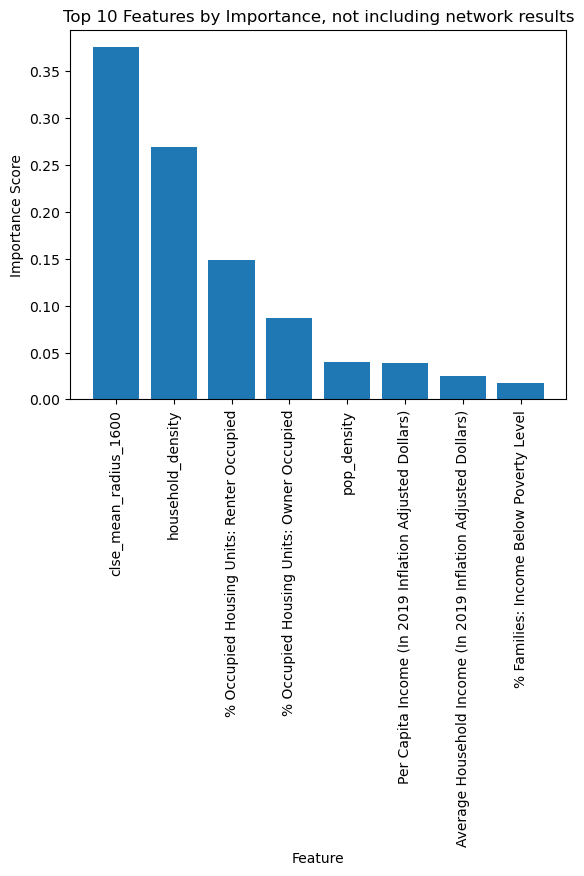

In [ ]:
df = nyc_gdf[['inverse_vehicle_use',
              'pop_density',
              'household_density',
              # 'PCT_SE_A09001_002', #: % Workers 16 Years and Over: Did Not Work At Home
              'PCT_SE_A10060_002', #: % Occupied Housing Units: Owner Occupied
              'PCT_SE_A10060_003', #: % Occupied Housing Units: Renter Occupied
              # 'PCT_SE_A10038_002', #: % Renter-Occupied Housing Units: Less than $300
              # 'PCT_SE_A10038_003', #: % Renter-Occupied Housing Units: $300 to $499
              # 'PCT_SE_A10038_004', #: % Renter-Occupied Housing Units: $500 to $799
              # 'PCT_SE_A10038_005', #: % Renter-Occupied Housing Units: $800 to $999
              # 'PCT_SE_A10038_006', #: % Renter-Occupied Housing Units: $1,000 to $1,499
              # 'PCT_SE_A10038_007', #: % Renter-Occupied Housing Units: $1,500 to $1,999
              # 'PCT_SE_A10038_008', #: % Renter-Occupied Housing Units: $2,000 to $2,499
              # 'PCT_SE_A10038_009', #: % Renter-Occupied Housing Units: $2,500 to $2,999
              # 'PCT_SE_A10038_010', #: % Renter-Occupied Housing Units: $3,000 or More
              # 'PCT_SE_A10038_011', #: % Renter-Occupied Housing Units: No Cash Rent
              # 'PCT_SE_A10054B_002', #: % Renter-Occupied Housing Units: No Vehicle Available
              # 'PCT_SE_A10054B_003', #: % Renter-Occupied Housing Units: 1 Vehicle Available
              # 'PCT_SE_A10054B_004', #: % Renter-Occupied Housing Units: 2 Vehicles Available
              # 'PCT_SE_A10054B_005', #: % Renter-Occupied Housing Units: 3 Vehicles Available
              # 'PCT_SE_A10054B_006', #: % Renter-Occupied Housing Units: 4 Vehicles Available
              # 'PCT_SE_A10054B_007', #: % Renter-Occupied Housing Units: 5 or More Vehicles Available
              # 'PCT_SE_A10030_002', #: % Occupied Housing Units: No Vehicle Available
              # 'PCT_SE_A10030_003', #: % Occupied Housing Units: 1 Vehicle Available
              # 'PCT_SE_A10030_004', #: % Occupied Housing Units: 2 Vehicles Available
              # 'PCT_SE_A10030_005', #: % Occupied Housing Units: 3 Vehicles Available
              # 'PCT_SE_A10030_006', #: % Occupied Housing Units: 4 Vehicles Available
              # 'PCT_SE_A10030_007', #: % Occupied Housing Units: 5 or More Vehicles Available
              # 'PCT_SE_A14001_002', #: % Households: Less than $10,000
              # 'PCT_SE_A14001_003', #: % Households: $10,000 to $14,999
              # 'PCT_SE_A14001_004', #: % Households: $15,000 to $19,999
              # 'PCT_SE_A14001_005', #: % Households: $20,000 to $24,999
              # 'PCT_SE_A14001_006', #: % Households: $25,000 to $29,999
              # 'PCT_SE_A14001_007', #: % Households: $30,000 to $34,999
              # 'PCT_SE_A14001_008', #: % Households: $35,000 to $39,999
              # 'PCT_SE_A14001_009', #: % Households: $40,000 to $44,999
              # 'PCT_SE_A14001_010', #: % Households: $45,000 to $49,999
              # 'PCT_SE_A14001_011', #: % Households: $50,000 to $59,999
              # 'PCT_SE_A14001_012', #: % Households: $60,000 to $74,999
              # 'PCT_SE_A14001_013', #: % Households: $75,000 to $99,999
              # 'PCT_SE_A14001_014', #: % Households: $100,000 to $124,999
              # 'PCT_SE_A14001_015', #: % Households: $125,000 to $149,999
              # 'PCT_SE_A14001_016', #: % Households: $150,000 to $199,999
              # 'PCT_SE_A14001_017', #: % Households: $200,000 or More
              'SE_A14008_001', #: Average Household Income (In 2019 Inflation Adjusted Dollars)
              'SE_A14024_001', #: Per Capita Income (In 2019 Inflation Adjusted Dollars)
              'PCT_SE_A13002_002', #: % Families: Income Below Poverty Level
            # # 'clse_mean_radius_400',
            # # 'clse_mean_radius_800',
            'clse_mean_radius_1600',
            # 'clse_mean_radius_3200',
            # # 'btwn_mean_radius_400',
            # # 'btwn_mean_radius_800',
            # # 'btwn_mean_radius_1600',
            # 'btwn_mean_radius_3200',
            # # 'pgrk_mean_radius_400',
            # # 'pgrk_mean_radius_800',
            # # 'pgrk_mean_radius_1600',
            # 'pgrk_mean_radius_3200',
            # 'clse_sum_radius_400',
            # 'clse_sum_radius_800',
            # 'clse_sum_radius_1600',
            # 'clse_sum_radius_3200',
            # 'btwn_sum_radius_400',
            # 'btwn_sum_radius_800',
            # 'btwn_sum_radius_1600',
            # 'btwn_sum_radius_3200',
            # 'pgrk_sum_radius_400',
            # 'pgrk_sum_radius_800',
            # 'pgrk_sum_radius_1600',
            # 'pgrk_sum_radius_3200',
            ]]

np.any(np.isnan(df))
np.all(np.isfinite(df))

df=df.dropna()

run_xgboost_no_cv(df)


Mean absolute error: 7.965472199490546
Mean squared error: 113.34632870605101
R-squared: 0.7002448962688873
(0.5040590763092041) clse_sum_radius_1600:  --- 
(0.1369440257549286) clse_mean_radius_800:  --- 
(0.06405749917030334) household_density:  --- 
(0.04889649897813797) clse_sum_radius_3200:  --- 
(0.03965022787451744) clse_mean_radius_3200:  --- 
(0.03862137347459793) clse_sum_radius_800:  --- 
(0.031259458512067795) PCT_SE_A10060_003: % Occupied Housing Units: Renter Occupied
(0.027562865987420082) clse_mean_radius_1600:  --- 
(0.02473147213459015) PCT_SE_A10060_002: % Occupied Housing Units: Owner Occupied
(0.020781513303518295) clse_mean_radius_400:  --- 
(0.018927184864878654) pop_density:  --- 
(0.016832100227475166) clse_sum_radius_400:  --- 
(0.010912841185927391) SE_A14024_001: Per Capita Income (In 2019 Inflation Adjusted Dollars)
(0.010147473774850368) SE_A14008_001: Average Household Income (In 2019 Inflation Adjusted Dollars)
(0.0066163563169538975) PCT_SE_A13002_002: 

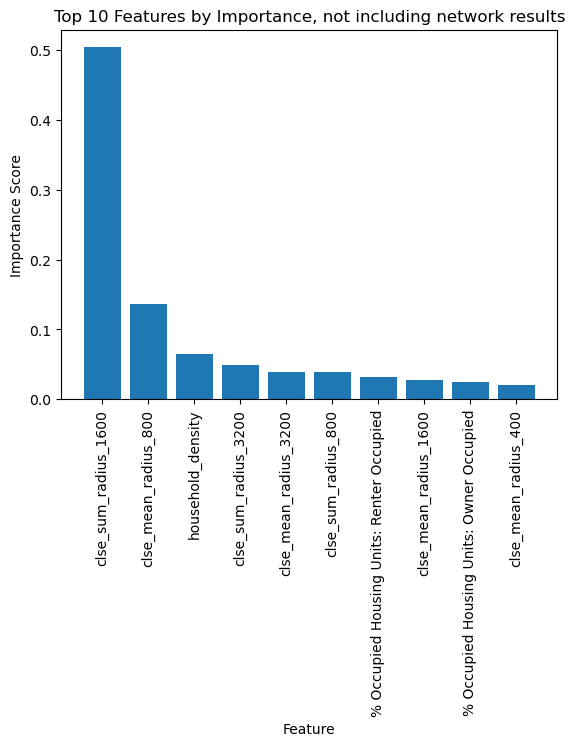

In [ ]:
df = nyc_gdf[['inverse_vehicle_use',
              'pop_density',
              'household_density',
              # 'PCT_SE_A09001_002', #: % Workers 16 Years and Over: Did Not Work At Home
              'PCT_SE_A10060_002', #: % Occupied Housing Units: Owner Occupied
              'PCT_SE_A10060_003', #: % Occupied Housing Units: Renter Occupied
              # 'PCT_SE_A10038_002', #: % Renter-Occupied Housing Units: Less than $300
              # 'PCT_SE_A10038_003', #: % Renter-Occupied Housing Units: $300 to $499
              # 'PCT_SE_A10038_004', #: % Renter-Occupied Housing Units: $500 to $799
              # 'PCT_SE_A10038_005', #: % Renter-Occupied Housing Units: $800 to $999
              # 'PCT_SE_A10038_006', #: % Renter-Occupied Housing Units: $1,000 to $1,499
              # 'PCT_SE_A10038_007', #: % Renter-Occupied Housing Units: $1,500 to $1,999
              # 'PCT_SE_A10038_008', #: % Renter-Occupied Housing Units: $2,000 to $2,499
              # 'PCT_SE_A10038_009', #: % Renter-Occupied Housing Units: $2,500 to $2,999
              # 'PCT_SE_A10038_010', #: % Renter-Occupied Housing Units: $3,000 or More
              # 'PCT_SE_A10038_011', #: % Renter-Occupied Housing Units: No Cash Rent
              # 'PCT_SE_A10054B_002', #: % Renter-Occupied Housing Units: No Vehicle Available
              # 'PCT_SE_A10054B_003', #: % Renter-Occupied Housing Units: 1 Vehicle Available
              # 'PCT_SE_A10054B_004', #: % Renter-Occupied Housing Units: 2 Vehicles Available
              # 'PCT_SE_A10054B_005', #: % Renter-Occupied Housing Units: 3 Vehicles Available
              # 'PCT_SE_A10054B_006', #: % Renter-Occupied Housing Units: 4 Vehicles Available
              # 'PCT_SE_A10054B_007', #: % Renter-Occupied Housing Units: 5 or More Vehicles Available
              # 'PCT_SE_A10030_002', #: % Occupied Housing Units: No Vehicle Available
              # 'PCT_SE_A10030_003', #: % Occupied Housing Units: 1 Vehicle Available
              # 'PCT_SE_A10030_004', #: % Occupied Housing Units: 2 Vehicles Available
              # 'PCT_SE_A10030_005', #: % Occupied Housing Units: 3 Vehicles Available
              # 'PCT_SE_A10030_006', #: % Occupied Housing Units: 4 Vehicles Available
              # 'PCT_SE_A10030_007', #: % Occupied Housing Units: 5 or More Vehicles Available
              # 'PCT_SE_A14001_002', #: % Households: Less than $10,000
              # 'PCT_SE_A14001_003', #: % Households: $10,000 to $14,999
              # 'PCT_SE_A14001_004', #: % Households: $15,000 to $19,999
              # 'PCT_SE_A14001_005', #: % Households: $20,000 to $24,999
              # 'PCT_SE_A14001_006', #: % Households: $25,000 to $29,999
              # 'PCT_SE_A14001_007', #: % Households: $30,000 to $34,999
              # 'PCT_SE_A14001_008', #: % Households: $35,000 to $39,999
              # 'PCT_SE_A14001_009', #: % Households: $40,000 to $44,999
              # 'PCT_SE_A14001_010', #: % Households: $45,000 to $49,999
              # 'PCT_SE_A14001_011', #: % Households: $50,000 to $59,999
              # 'PCT_SE_A14001_012', #: % Households: $60,000 to $74,999
              # 'PCT_SE_A14001_013', #: % Households: $75,000 to $99,999
              # 'PCT_SE_A14001_014', #: % Households: $100,000 to $124,999
              # 'PCT_SE_A14001_015', #: % Households: $125,000 to $149,999
              # 'PCT_SE_A14001_016', #: % Households: $150,000 to $199,999
              # 'PCT_SE_A14001_017', #: % Households: $200,000 or More
              'SE_A14008_001', #: Average Household Income (In 2019 Inflation Adjusted Dollars)
              'SE_A14024_001', #: Per Capita Income (In 2019 Inflation Adjusted Dollars)
              'PCT_SE_A13002_002', #: % Families: Income Below Poverty Level
            'clse_mean_radius_400',
            'clse_mean_radius_800',
            'clse_mean_radius_1600',
            'clse_mean_radius_3200',
            # # 'btwn_mean_radius_400',
            # # 'btwn_mean_radius_800',
            # # 'btwn_mean_radius_1600',
            # 'btwn_mean_radius_3200',
            # # 'pgrk_mean_radius_400',
            # # 'pgrk_mean_radius_800',
            # # 'pgrk_mean_radius_1600',
            # 'pgrk_mean_radius_3200',
            'clse_sum_radius_400',
            'clse_sum_radius_800',
            'clse_sum_radius_1600',
            'clse_sum_radius_3200',
            # 'btwn_sum_radius_400',
            # 'btwn_sum_radius_800',
            # 'btwn_sum_radius_1600',
            # 'btwn_sum_radius_3200',
            # 'pgrk_sum_radius_400',
            # 'pgrk_sum_radius_800',
            # 'pgrk_sum_radius_1600',
            # 'pgrk_sum_radius_3200',
            ]]

np.any(np.isnan(df))
np.all(np.isfinite(df))

df=df.dropna()

run_xgboost_no_cv(df)


### Scatterplots

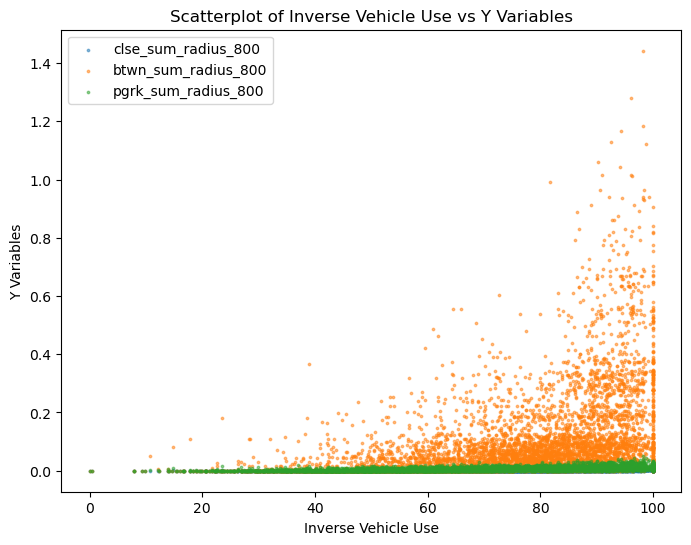

In [ ]:
import matplotlib.pyplot as plt

y_vars = [
            # 'clse_mean_radius_400',
            # 'clse_mean_radius_800',
            # 'clse_mean_radius_1600',
            # 'clse_mean_radius_3200',
            # 'btwn_mean_radius_400',
            # 'btwn_mean_radius_800',
            # 'btwn_mean_radius_1600',
            # 'btwn_mean_radius_3200',
            # 'pgrk_mean_radius_400',
            # 'pgrk_mean_radius_800',
            # 'pgrk_mean_radius_1600',
            # 'pgrk_mean_radius_3200',
            # 'clse_sum_radius_400',
            'clse_sum_radius_800',
            # 'clse_sum_radius_1600',
            # 'clse_sum_radius_3200',
            # 'btwn_sum_radius_400',
            'btwn_sum_radius_800',
            # 'btwn_sum_radius_1600',
            # 'btwn_sum_radius_3200',
            # 'pgrk_sum_radius_400',
            'pgrk_sum_radius_800',
            # 'pgrk_sum_radius_1600',
            # 'pgrk_sum_radius_3200',
            ]

fig, ax = plt.subplots(figsize=(8, 6))

for y_var in y_vars:
    ax.scatter(nyc_gdf['inverse_vehicle_use'], nyc_gdf[y_var], s=3, alpha=0.5, label=y_var)

ax.set_xlabel('Inverse Vehicle Use')
ax.set_ylabel('Y Variables')
ax.set_title('Scatterplot of Inverse Vehicle Use vs Y Variables')
ax.legend()
plt.show()

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


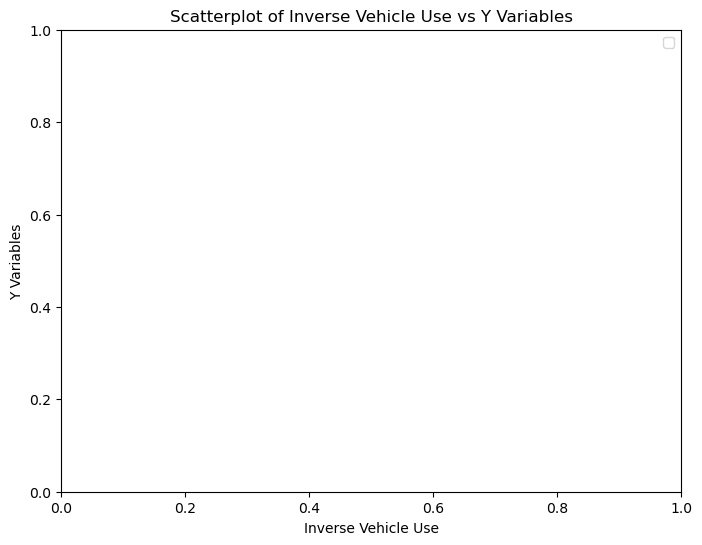

In [ ]:
import matplotlib.pyplot as plt

y_vars = [
            # 'log_clse_mean_radius_400',
            # 'log_clse_mean_radius_800',
            # 'log_clse_mean_radius_1600',
            # 'log_clse_mean_radius_3200',
            # 'log_btwn_mean_radius_400',
            # 'log_btwn_mean_radius_800',
            # 'log_btwn_mean_radius_1600',
            # 'log_btwn_mean_radius_3200',
            # 'log_pgrk_mean_radius_400',
            # 'log_pgrk_mean_radius_800',
            # 'log_pgrk_mean_radius_1600',
            # 'log_pgrk_mean_radius_3200',

            # 'log_clse_sum_radius_400',
            # 'log_clse_sum_radius_800',
            # 'log_clse_sum_radius_1600',
            # 'log_clse_sum_radius_3200',
            # 'log_btwn_sum_radius_400',
            # 'log_btwn_sum_radius_800',
            # 'log_btwn_sum_radius_1600',
            # 'log_btwn_sum_radius_3200',
            # 'log_pgrk_sum_radius_400',
            # 'log_pgrk_sum_radius_800',
            # 'log_pgrk_sum_radius_1600',
            # 'log_pgrk_sum_radius_3200',
            ]

fig, ax = plt.subplots(figsize=(8, 6))

for y_var in y_vars:
    ax.scatter(nyc_gdf['inverse_vehicle_use'], nyc_gdf[y_var], s=3, alpha=0.5, label=y_var)

ax.set_xlabel('Inverse Vehicle Use')
ax.set_ylabel('Y Variables')
ax.set_title('Scatterplot of Inverse Vehicle Use vs Y Variables')
ax.legend()
plt.show()

### OLS Regression

In [ ]:
df = nyc_gdf[['inverse_vehicle_use',
              'pop_density',
              'household_density',
              'PCT_SE_A09001_002', #: % Workers 16 Years and Over: Did Not Work At Home
              'PCT_SE_A10060_002', #: % Occupied Housing Units: Owner Occupied
              'PCT_SE_A10060_003', #: % Occupied Housing Units: Renter Occupied
              'PCT_SE_A10038_002', #: % Renter-Occupied Housing Units: Less than $300
              'PCT_SE_A10038_003', #: % Renter-Occupied Housing Units: $300 to $499
              'PCT_SE_A10038_004', #: % Renter-Occupied Housing Units: $500 to $799
              'PCT_SE_A10038_005', #: % Renter-Occupied Housing Units: $800 to $999
              'PCT_SE_A10038_006', #: % Renter-Occupied Housing Units: $1,000 to $1,499
              'PCT_SE_A10038_007', #: % Renter-Occupied Housing Units: $1,500 to $1,999
              'PCT_SE_A10038_008', #: % Renter-Occupied Housing Units: $2,000 to $2,499
              'PCT_SE_A10038_009', #: % Renter-Occupied Housing Units: $2,500 to $2,999
              'PCT_SE_A10038_010', #: % Renter-Occupied Housing Units: $3,000 or More
              'PCT_SE_A10038_011', #: % Renter-Occupied Housing Units: No Cash Rent
              'PCT_SE_A10054B_002', #: % Renter-Occupied Housing Units: No Vehicle Available
              'PCT_SE_A10054B_003', #: % Renter-Occupied Housing Units: 1 Vehicle Available
              'PCT_SE_A10054B_004', #: % Renter-Occupied Housing Units: 2 Vehicles Available
              'PCT_SE_A10054B_005', #: % Renter-Occupied Housing Units: 3 Vehicles Available
              'PCT_SE_A10054B_006', #: % Renter-Occupied Housing Units: 4 Vehicles Available
              'PCT_SE_A10054B_007', #: % Renter-Occupied Housing Units: 5 or More Vehicles Available
              'PCT_SE_A10030_002', #: % Occupied Housing Units: No Vehicle Available
              'PCT_SE_A10030_003', #: % Occupied Housing Units: 1 Vehicle Available
              'PCT_SE_A10030_004', #: % Occupied Housing Units: 2 Vehicles Available
              'PCT_SE_A10030_005', #: % Occupied Housing Units: 3 Vehicles Available
              'PCT_SE_A10030_006', #: % Occupied Housing Units: 4 Vehicles Available
              'PCT_SE_A10030_007', #: % Occupied Housing Units: 5 or More Vehicles Available
              'PCT_SE_A14001_002', #: % Households: Less than $10,000
              'PCT_SE_A14001_003', #: % Households: $10,000 to $14,999
              'PCT_SE_A14001_004', #: % Households: $15,000 to $19,999
              'PCT_SE_A14001_005', #: % Households: $20,000 to $24,999
              'PCT_SE_A14001_006', #: % Households: $25,000 to $29,999
              'PCT_SE_A14001_007', #: % Households: $30,000 to $34,999
              'PCT_SE_A14001_008', #: % Households: $35,000 to $39,999
              'PCT_SE_A14001_009', #: % Households: $40,000 to $44,999
              'PCT_SE_A14001_010', #: % Households: $45,000 to $49,999
              'PCT_SE_A14001_011', #: % Households: $50,000 to $59,999
              'PCT_SE_A14001_012', #: % Households: $60,000 to $74,999
              'PCT_SE_A14001_013', #: % Households: $75,000 to $99,999
              'PCT_SE_A14001_014', #: % Households: $100,000 to $124,999
              'PCT_SE_A14001_015', #: % Households: $125,000 to $149,999
              'PCT_SE_A14001_016', #: % Households: $150,000 to $199,999
              'PCT_SE_A14001_017', #: % Households: $200,000 or More
              'SE_A14008_001', #: Average Household Income (In 2019 Inflation Adjusted Dollars)
              'SE_A14024_001', #: Per Capita Income (In 2019 Inflation Adjusted Dollars)
              'PCT_SE_A13002_002', #: % Families: Income Below Poverty Level
            'clse_mean_radius_400',
            'clse_mean_radius_800',
            'clse_mean_radius_1600',
            'clse_mean_radius_3200',
            'btwn_mean_radius_400',
            'btwn_mean_radius_800',
            'btwn_mean_radius_1600',
            'btwn_mean_radius_3200',
            'pgrk_mean_radius_400',
            'pgrk_mean_radius_800',
            'pgrk_mean_radius_1600',
            'pgrk_mean_radius_3200',
            'clse_sum_radius_400',
            'clse_sum_radius_800',
            'clse_sum_radius_1600',
            'clse_sum_radius_3200',
            'btwn_sum_radius_400',
            'btwn_sum_radius_800',
            'btwn_sum_radius_1600',
            'btwn_sum_radius_3200',
            'pgrk_sum_radius_400',
            'pgrk_sum_radius_800',
            'pgrk_sum_radius_1600',
            'pgrk_sum_radius_3200',
            'log_clse_mean_radius_400',
            'log_clse_mean_radius_800',
            'log_clse_mean_radius_1600',
            'log_clse_mean_radius_3200',
            'log_btwn_mean_radius_400',
            'log_btwn_mean_radius_800',
            'log_btwn_mean_radius_1600',
            'log_btwn_mean_radius_3200',
            'log_pgrk_mean_radius_400',
            'log_pgrk_mean_radius_800',
            'log_pgrk_mean_radius_1600',
            'log_pgrk_mean_radius_3200',
            'log_clse_sum_radius_400',
            'log_clse_sum_radius_800',
            'log_clse_sum_radius_1600',
            'log_clse_sum_radius_3200',
            'log_btwn_sum_radius_400',
            'log_btwn_sum_radius_800',
            'log_btwn_sum_radius_1600',
            'log_btwn_sum_radius_3200',
            'log_pgrk_sum_radius_400',
            'log_pgrk_sum_radius_800',
            'log_pgrk_sum_radius_1600',
            'log_pgrk_sum_radius_3200',
            ]]

np.any(np.isnan(df))
np.all(np.isfinite(df))

df=df.dropna()

In [ ]:
import statsmodels.api as sm

# Define dependent and independent variables
y = df['inverse_vehicle_use']
# X = df.drop(['inverse_vehicle_use'], axis=1)
X = df[[
        'pop_density',
        'household_density',
        'PCT_SE_A10060_002', #: % Occupied Housing Units: Owner Occupied
        'PCT_SE_A10060_003', #: % Occupied Housing Units: Renter Occupied
        'SE_A14008_001', #: Average Household Income (In 2019 Inflation Adjusted Dollars)
        'SE_A14024_001', #: Per Capita Income (In 2019 Inflation Adjusted Dollars)
        'PCT_SE_A13002_002', #: % Families: Income Below Poverty Level
            'clse_mean_radius_800',
            # 'clse_sum_radius_1600',
        ]]

# Add constant to independent variables
X = sm.add_constant(X)

# Fit OLS model
model = sm.OLS(y, X).fit()

# Print summary of regression results
print(model.summary())

                             OLS Regression Results                            
Dep. Variable:     inverse_vehicle_use   R-squared:                       0.621
Model:                             OLS   Adj. R-squared:                  0.621
Method:                  Least Squares   F-statistic:                     1173.
Date:                 Tue, 09 May 2023   Prob (F-statistic):               0.00
Time:                         14:42:54   Log-Likelihood:                -22291.
No. Observations:                 5723   AIC:                         4.460e+04
Df Residuals:                     5714   BIC:                         4.466e+04
Df Model:                            8                                         
Covariance Type:             nonrobust                                         
                           coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                 

In [ ]:
import statsmodels.api as sm

# Define dependent and independent variables
y = df['inverse_vehicle_use']
# X = df.drop(['inverse_vehicle_use'], axis=1)
X = df[[
        'pop_density',
        'household_density',
        'PCT_SE_A10060_002', #: % Occupied Housing Units: Owner Occupied
        'PCT_SE_A10060_003', #: % Occupied Housing Units: Renter Occupied
        'SE_A14008_001', #: Average Household Income (In 2019 Inflation Adjusted Dollars)
        'SE_A14024_001', #: Per Capita Income (In 2019 Inflation Adjusted Dollars)
        'PCT_SE_A13002_002', #: % Families: Income Below Poverty Level
            # 'clse_mean_radius_800',
            'clse_sum_radius_1600',
        ]]

# Add constant to independent variables
X = sm.add_constant(X)

# Fit OLS model
model = sm.OLS(y, X).fit()

# Print summary of regression results
print(model.summary())

                             OLS Regression Results                            
Dep. Variable:     inverse_vehicle_use   R-squared:                       0.585
Model:                             OLS   Adj. R-squared:                  0.585
Method:                  Least Squares   F-statistic:                     1008.
Date:                 Tue, 09 May 2023   Prob (F-statistic):               0.00
Time:                         14:42:54   Log-Likelihood:                -22552.
No. Observations:                 5723   AIC:                         4.512e+04
Df Residuals:                     5714   BIC:                         4.518e+04
Df Model:                            8                                         
Covariance Type:             nonrobust                                         
                           coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                 

In [ ]:
import statsmodels.api as sm

# Define dependent and independent variables
y = df['inverse_vehicle_use']
# X = df.drop(['inverse_vehicle_use'], axis=1)
X = df[[
        'pop_density',
        'household_density',
        'PCT_SE_A10060_002', #: % Occupied Housing Units: Owner Occupied
        'PCT_SE_A10060_003', #: % Occupied Housing Units: Renter Occupied
        'SE_A14008_001', #: Average Household Income (In 2019 Inflation Adjusted Dollars)
        'SE_A14024_001', #: Per Capita Income (In 2019 Inflation Adjusted Dollars)
        'PCT_SE_A13002_002', #: % Families: Income Below Poverty Level
            'clse_mean_radius_400',
            'clse_mean_radius_800',
            'clse_mean_radius_1600',
            'clse_mean_radius_3200',
            # 'btwn_mean_radius_400',
            # 'btwn_mean_radius_800',
            # 'btwn_mean_radius_1600',
            # 'btwn_mean_radius_3200',
            # 'pgrk_mean_radius_400',
            # 'pgrk_mean_radius_800',
            # 'pgrk_mean_radius_1600',
            # 'pgrk_mean_radius_3200',
            'clse_sum_radius_400',
            'clse_sum_radius_800',
            'clse_sum_radius_1600',
            'clse_sum_radius_3200',
            # 'btwn_sum_radius_400',
            # 'btwn_sum_radius_800',
            # 'btwn_sum_radius_1600',
            # 'btwn_sum_radius_3200',
            # 'pgrk_sum_radius_400',
            # 'pgrk_sum_radius_800',
            # 'pgrk_sum_radius_1600',
            # 'pgrk_sum_radius_3200',
        ]]

# Add constant to independent variables
X = sm.add_constant(X)

# Fit OLS model
model = sm.OLS(y, X).fit()

# Print summary of regression results
print(model.summary())

                             OLS Regression Results                            
Dep. Variable:     inverse_vehicle_use   R-squared:                       0.665
Model:                             OLS   Adj. R-squared:                  0.665
Method:                  Least Squares   F-statistic:                     756.8
Date:                 Tue, 09 May 2023   Prob (F-statistic):               0.00
Time:                         14:42:54   Log-Likelihood:                -21937.
No. Observations:                 5723   AIC:                         4.391e+04
Df Residuals:                     5707   BIC:                         4.401e+04
Df Model:                           15                                         
Covariance Type:             nonrobust                                         
                            coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const               

In [ ]:
import statsmodels.api as sm

# Define dependent and independent variables
y = df['inverse_vehicle_use']
# X = df.drop(['inverse_vehicle_use'], axis=1)
X = df[[
        'pop_density',
        'household_density',
        'PCT_SE_A10060_002', #: % Occupied Housing Units: Owner Occupied
        'PCT_SE_A10060_003', #: % Occupied Housing Units: Renter Occupied
        'SE_A14008_001', #: Average Household Income (In 2019 Inflation Adjusted Dollars)
        'SE_A14024_001', #: Per Capita Income (In 2019 Inflation Adjusted Dollars)
        'PCT_SE_A13002_002', #: % Families: Income Below Poverty Level
            'clse_mean_radius_400',
            'clse_mean_radius_800',
            'clse_mean_radius_1600',
            'clse_mean_radius_3200',
            'btwn_mean_radius_400',
            'btwn_mean_radius_800',
            'btwn_mean_radius_1600',
            'btwn_mean_radius_3200',
            'pgrk_mean_radius_400',
            'pgrk_mean_radius_800',
            'pgrk_mean_radius_1600',
            'pgrk_mean_radius_3200',
            'clse_sum_radius_400',
            'clse_sum_radius_800',
            'clse_sum_radius_1600',
            'clse_sum_radius_3200',
            'btwn_sum_radius_400',
            'btwn_sum_radius_800',
            'btwn_sum_radius_1600',
            'btwn_sum_radius_3200',
            'pgrk_sum_radius_400',
            'pgrk_sum_radius_800',
            'pgrk_sum_radius_1600',
            'pgrk_sum_radius_3200',
            'log_clse_mean_radius_400',
            'log_clse_mean_radius_800',
            'log_clse_mean_radius_1600',
            'log_clse_mean_radius_3200',
            'log_btwn_mean_radius_400',
            'log_btwn_mean_radius_800',
            'log_btwn_mean_radius_1600',
            'log_btwn_mean_radius_3200',
            'log_pgrk_mean_radius_400',
            'log_pgrk_mean_radius_800',
            'log_pgrk_mean_radius_1600',
            'log_pgrk_mean_radius_3200',
            'log_clse_sum_radius_400',
            'log_clse_sum_radius_800',
            'log_clse_sum_radius_1600',
            'log_clse_sum_radius_3200',
            'log_btwn_sum_radius_400',
            'log_btwn_sum_radius_800',
            'log_btwn_sum_radius_1600',
            'log_btwn_sum_radius_3200',
            'log_pgrk_sum_radius_400',
            'log_pgrk_sum_radius_800',
            'log_pgrk_sum_radius_1600',
            'log_pgrk_sum_radius_3200',
        ]]

# Add constant to independent variables
X = sm.add_constant(X)

# Fit OLS model
model = sm.OLS(y, X).fit()

# Print summary of regression results
print(model.summary())

                             OLS Regression Results                            
Dep. Variable:     inverse_vehicle_use   R-squared:                       0.686
Model:                             OLS   Adj. R-squared:                  0.683
Method:                  Least Squares   F-statistic:                     233.8
Date:                 Tue, 09 May 2023   Prob (F-statistic):               0.00
Time:                         14:42:54   Log-Likelihood:                -21755.
No. Observations:                 5723   AIC:                         4.362e+04
Df Residuals:                     5669   BIC:                         4.398e+04
Df Model:                           53                                         
Covariance Type:             nonrobust                                         
                                coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------------
const       

In [ ]:
import statsmodels.api as sm

# Define dependent and independent variables
y = df['inverse_vehicle_use']
# X = df.drop(['inverse_vehicle_use'], axis=1)
X = df[[
        'pop_density',
        'household_density',
        'PCT_SE_A10060_002', #: % Occupied Housing Units: Owner Occupied
        'PCT_SE_A10060_003', #: % Occupied Housing Units: Renter Occupied
        'SE_A14008_001', #: Average Household Income (In 2019 Inflation Adjusted Dollars)
        'SE_A14024_001', #: Per Capita Income (In 2019 Inflation Adjusted Dollars)
        'PCT_SE_A13002_002', #: % Families: Income Below Poverty Level
            # 'clse_mean_radius_400',
            # 'clse_mean_radius_800',
            # 'clse_mean_radius_1600',
            'clse_mean_radius_3200',
            # 'btwn_mean_radius_400',
            # 'btwn_mean_radius_800',
            # 'btwn_mean_radius_1600',
            'btwn_mean_radius_3200',
            # 'pgrk_mean_radius_400',
            # 'pgrk_mean_radius_800',
            # 'pgrk_mean_radius_1600',
            'pgrk_mean_radius_3200',
            # 'clse_sum_radius_400',
            # 'clse_sum_radius_800',
            # 'clse_sum_radius_1600',
            'clse_sum_radius_3200',
            # 'btwn_sum_radius_400',
            # 'btwn_sum_radius_800',
            # 'btwn_sum_radius_1600',
            'btwn_sum_radius_3200',
            # 'pgrk_sum_radius_400',
            # 'pgrk_sum_radius_800',
            # 'pgrk_sum_radius_1600',
            'pgrk_sum_radius_3200',
        ]]

# Add constant to independent variables
X = sm.add_constant(X)

# Fit OLS model
model = sm.OLS(y, X).fit()

# Print summary of regression results
print(model.summary())

                             OLS Regression Results                            
Dep. Variable:     inverse_vehicle_use   R-squared:                       0.649
Model:                             OLS   Adj. R-squared:                  0.649
Method:                  Least Squares   F-statistic:                     813.3
Date:                 Tue, 09 May 2023   Prob (F-statistic):               0.00
Time:                         14:42:54   Log-Likelihood:                -22072.
No. Observations:                 5723   AIC:                         4.417e+04
Df Residuals:                     5709   BIC:                         4.426e+04
Df Model:                           13                                         
Covariance Type:             nonrobust                                         
                            coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const               

In [ ]:
import statsmodels.api as sm

# Define dependent and independent variables
y = df['inverse_vehicle_use']
# X = df.drop(['inverse_vehicle_use'], axis=1)
X = df[[
        'pop_density',
        'household_density',
        'PCT_SE_A10060_002', #: % Occupied Housing Units: Owner Occupied
        'PCT_SE_A10060_003', #: % Occupied Housing Units: Renter Occupied
        'SE_A14008_001', #: Average Household Income (In 2019 Inflation Adjusted Dollars)
        'SE_A14024_001', #: Per Capita Income (In 2019 Inflation Adjusted Dollars)
        'PCT_SE_A13002_002', #: % Families: Income Below Poverty Level
            # 'clse_mean_radius_400',
            # 'clse_mean_radius_800',
            # 'clse_mean_radius_1600',
            # 'clse_mean_radius_3200',
            # 'btwn_mean_radius_400',
            # 'btwn_mean_radius_800',
            # 'btwn_mean_radius_1600',
            # 'btwn_mean_radius_3200',
            # 'pgrk_mean_radius_400',
            # 'pgrk_mean_radius_800',
            # 'pgrk_mean_radius_1600',
            # 'pgrk_mean_radius_3200',
            'clse_sum_radius_400',
            'clse_sum_radius_800',
            'clse_sum_radius_1600',
            'clse_sum_radius_3200',
            # 'btwn_sum_radius_400',
            # 'btwn_sum_radius_800',
            # 'btwn_sum_radius_1600',
            # 'btwn_sum_radius_3200',
            # 'pgrk_sum_radius_400',
            # 'pgrk_sum_radius_800',
            # 'pgrk_sum_radius_1600',
            # 'pgrk_sum_radius_3200',
        ]]

# Add constant to independent variables
X = sm.add_constant(X)

# Fit OLS model
model = sm.OLS(y, X).fit()

# Print summary of regression results
print(model.summary())

                             OLS Regression Results                            
Dep. Variable:     inverse_vehicle_use   R-squared:                       0.616
Model:                             OLS   Adj. R-squared:                  0.615
Method:                  Least Squares   F-statistic:                     832.6
Date:                 Tue, 09 May 2023   Prob (F-statistic):               0.00
Time:                         14:42:54   Log-Likelihood:                -22332.
No. Observations:                 5723   AIC:                         4.469e+04
Df Residuals:                     5711   BIC:                         4.477e+04
Df Model:                           11                                         
Covariance Type:             nonrobust                                         
                           coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                 